In [1]:
!nvidia-smi

Sun Mar  9 14:14:43 2025       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 550.54.15              Driver Version: 550.54.15      CUDA Version: 12.4     |
|-----------------------------------------+------------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  NVIDIA A100-SXM4-40GB          Off |   00000000:00:04.0 Off |                    0 |
| N/A   32C    P0             42W /  400W |       0MiB /  40960MiB |      0%      Default |
|                                         |                        |             Disabled |
+-----------------------------------------+-----

In [2]:
import os, natsort, re
from tqdm import tqdm
import time, random

In [3]:
from itertools import repeat, chain

import numpy as np
import pandas as pd
import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns
import os

from sklearn.metrics import r2_score
from sklearn.metrics import mean_absolute_percentage_error as mape
from sklearn.metrics import mean_squared_error as mse
from sklearn.metrics import mean_squared_log_error as msle

import matplotlib_inline.backend_inline
matplotlib_inline.backend_inline.set_matplotlib_formats("png2x")
# 테마 설정: "default", "classic", "dark_background", "fivethirtyeight", "seaborn"
mpl.style.use("fivethirtyeight")
# 이미지가 레이아웃 안으로 들어오도록 함
mpl.rcParams.update({"figure.constrained_layout.use": True})
mpl.rcParams['axes.unicode_minus'] = False

In [4]:
from google.colab import drive

drive.mount('/content/drive/', force_remount=True)

Mounted at /content/drive/


In [5]:
cd /content/drive/MyDrive/kdt-EST-AI/project/project2/

/content/drive/MyDrive/kdt-EST-AI/project/project2


In [6]:
# 로컬에서

#plt.rc("font", family = "D2Coding")
#plt.rcParams["axes.unicode_minus"] = False

In [7]:
#PRJCT_PATH = '/home/doeun/code/AI/ESTSOFT2024/workspace/2.project_text/aladin_usedbook/'
PRJCT_PATH = '/content/drive/MyDrive/kdt-EST-AI/project/project2/'
save_dir = 'processed/model_input'
dir_path = os.path.join(PRJCT_PATH,save_dir)
#dir_path = './'

In [8]:
import sys
sys.path.append(PRJCT_PATH)

In [9]:
RSLT_DIR = PRJCT_PATH + 'processed/'

bookinfo_name = 'bookinfo_ver{}.pkl'.format(0.75)
bookinfo_path = os.path.join(RSLT_DIR,bookinfo_name)

sys.path.append(PRJCT_PATH)
from module_aladin.file_io import load_pkl, save_pkl
from module_aladin.reg_tool import make_reg_score_dict

from module_aladin.util import read_run_rslt
from module_aladin.plot import plot_area

In [10]:
input_dir = os.path.join(RSLT_DIR,'model_input')
files = list(filter(lambda x : 'whole-encoded' in x,os.listdir(input_dir)))
files

['whole-encoded.v1.0_st-0_X_trn.pkl',
 'whole-encoded.v1.0_st-0_X_tst.pkl',
 'whole-encoded.v1.0_st-0_y_trn.pkl',
 'whole-encoded.v1.0_st-0_y_vld.pkl',
 'whole-encoded.v1.0_st-0_y_tst.pkl',
 'whole-encoded.v1.0_st-0_X_vld.pkl']

In [11]:
from collections import defaultdict

data_dict=defaultdict(dict)
for f in files:
    data_dict[f[-7:-4]][f[-9]] = load_pkl(os.path.join(input_dir,f))

In [12]:
data_dict.keys()

dict_keys(['trn', 'tst', 'vld'])

In [13]:

import torch

# GPU device setting
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

torch.set_default_device(device)

In [14]:
import os
os.environ['CUDA_LAUNCH_BLOCKING'] = '1'
os.environ["CUDA_VISIBLE_DEVICES"] = '0'
os.environ["TORCH_USE_CUDA_DSA"] = '1'

In [15]:
device

device(type='cuda', index=0)

# train & evaluation module

In [16]:
import locale
locale.getpreferredencoding = lambda: "UTF-8"

!pip install torcheval
!pip install torchmetrics

In [17]:
from module_aladin.torch_train import trainer_setting, train, evaluate, run, test_n_plot

cuda:0


# Make model & setting

## Attention based model

In [18]:
import math
import time

from torch import nn, optim
from torch.optim import Adam


In [19]:
from module_aladin.attention_based_model import EncoderWithEmbedding

cuda:0


In [20]:
device

device(type='cuda', index=0)

In [21]:
#col_start = np.array([0,5,35,60,64])
col_start = np.array([0,64])
col_len = col_start[1:]- col_start[:-1]
col_len

array([64])

In [22]:
class EncoderModel0(nn.Module):
  def __init__(self,seq_len,d_model,head,d_ff,dropout,n_layers,device):
    super().__init__()
    self.device=device
    self.seq_len = seq_len
    self.d_model = d_model #300 # should be common multiplyer of col_len[:-1]
    self.embd_encoder = EncoderWithEmbedding(seq_len,d_model,head,d_ff,seq_len,dropout,n_layers,device)
    d_out= d_model*seq_len
    self.fc1 = nn.Linear(d_out,d_out//2)
    self.fc2 = nn.Linear(d_out//2,d_out//2)
    self.fc3 = nn.Linear(d_out//2,1)
    self.relu = nn.ReLU()
    self.dropout = nn.Dropout(dropout)

  def forward(self,src): #차원 체크해봐야 함
    intrmd, masks = [], []
    batch_size,_ = src.size()
    out = self.embd_encoder(src.to(torch.int32))
    output = out.view(batch_size,-1)

    output = self.dropout(self.relu(self.fc1(output)))
    output = self.dropout(self.relu(self.fc2(output)))
    output = self.fc3(output)

    return output


In [36]:
# model parameter setting
batch_size = 16384

# optimizer parameter setting
init_lr = 7e-5
factor = 0.92
adam_eps = 5e-7
patience = 10
warmup = 3
epoch = 350
clip = 1.0
weight_decay = 5e-20
drop_prob = 0.1

## make dataloader

In [37]:
from module_aladin.load_data import load_dataloader_iters
from module_aladin.plot import plot_area

In [38]:
data_dict['trn']['X'].shape

(101173, 64)

In [39]:
iter_dict = load_dataloader_iters(data_dict,batch_size)

In [40]:
class answer_out(nn.Module):
  def __init__(self,iter):
    super().__init__()
    self.input, self.output = zip(*iter)
  def forward(self,src):
    for i,x in enumerate(self.input):
      if x.shape != src.shape: continue
      cond = x.reshape(-1) == src.reshape(-1)
      if torch.sum(cond) == len(cond) : return self.output[i]
    else : return False

answer_trn = answer_out(iter_dict['trn'])
answer_vld = answer_out(iter_dict['vld'])
answer_tst = answer_out(iter_dict['tst'])

In [41]:
def plot_err_dist(y_pred,y_true,percent=False,**kwargs):
  err = y_pred - y_true
  if percent : err = err/y_true
  if 'kind' not in kwargs : kwargs['kind'] = 'hist'
  sns.jointplot(x=y_true,y=err,**kwargs)

def get_test_rslt(model, iterator, criterion,device):
    model.eval()
    epoch_loss = 0
    Y_actual, Y_pred = list(),list()
    with torch.no_grad():
        for i, batch in enumerate(iterator):
            x,y_actual = batch[0].to(device), batch[1].to(device)
            x,y_actual = x.to(torch.float32),y_actual.to(torch.float32)
            y_pred = model(x).reshape(-1)
            loss = criterion(y_pred,y_actual)

            epoch_loss += loss.item()

            score_list = list()
            Y_pred.append(y_pred)
            Y_actual.append(y_actual)

    Y_actual, Y_pred = torch.cat(Y_actual), torch.cat(Y_pred).reshape(-1)
    return Y_pred.detach().cpu().numpy(),Y_actual.detach().cpu().numpy()


def test_plot_err_dist(model, iterator, criterion,device,percent=False,**kwargs):
  y_pred,y_true = get_test_rslt(model,iterator,criterion,device)
  plot_err_dist(y_pred,y_true,percent=percent,**kwargs)


# N=6

In [42]:
d_model = 64 #64
seq_len = 64
head = 8
d_ff = 128
n_layers= 6

In [43]:
model = EncoderModel0(seq_len,d_model,head,d_ff,drop_prob,n_layers,device)
model, optimizer, scheduler, criterion =trainer_setting(model,init_lr,weight_decay,adam_eps,factor,patience)

The model has 14,953,089 trainable parameters


/content/drive/MyDrive/kdt-EST-AI/project/project2/module_aladin/torch_train.py:179: FutureWarning: `nn.init.kaiming_uniform` is now deprecated in favor of `nn.init.kaiming_uniform_`.
  nn.init.kaiming_uniform(m.weight.data)
/usr/local/lib/python3.11/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(


# train, evaluate

In [44]:
model_name = 'Encoder0'
expt_name = f'{model_name}_{batch_size}_{epoch}_N{n_layers}'
save_dir = os.path.join(RSLT_DIR,'model',expt_name)
if not os.path.exists(save_dir) : os.makedirs(save_dir)
file_name = 'model_{}.pt'.format(241110)

In [45]:
os.listdir(save_dir)

[]

In [46]:
for i, (src, labels) in enumerate(iter_dict['trn']):
  print(len(src[i]),labels[i])
  break

64 tensor(6800., device='cuda:0')


In [47]:
train_config =[optimizer, scheduler, criterion, clip]

In [48]:
model,train_loss,val_loss,train_score,val_score,best_epoch = run(model,train_config,iter_dict['trn'],iter_dict['vld'],epoch,warmup,8500,save_dir,file_name[:-3])
torch.save(model,os.path.join(save_dir,file_name))
save_pkl(save_dir,'train_loss.pkl',train_loss)
save_pkl(save_dir,'valid_loss.pkl',val_loss)
save_pkl(save_dir,'valid_score.pkl',val_score)

Epoch:     1		lr: 0.00007000
	Train Loss: 17934.668	Train Score: -1.686	Val Loss: 17671.500	Val Score: -1.887
Epoch:     2		lr: 0.00007000
	Train Loss: 17878.029	Train Score: -1.670	Val Loss: 17584.727	Val Score: -1.858
Epoch:     3		lr: 0.00007000
	Train Loss: 17779.974	Train Score: -1.642	Val Loss: 17449.737	Val Score: -1.814
Epoch:     4		lr: 0.00007000
	Train Loss: 17633.411	Train Score: -1.600	Val Loss: 17260.323	Val Score: -1.752
Epoch:     5		lr: 0.00007000
	Train Loss: 17436.407	Train Score: -1.543	Val Loss: 17017.360	Val Score: -1.674
Epoch:     6		lr: 0.00007000
	Train Loss: 17191.386	Train Score: -1.474	Val Loss: 16724.490	Val Score: -1.582
Epoch:     7		lr: 0.00007000
	Train Loss: 16901.761	Train Score: -1.393	Val Loss: 16388.336	Val Score: -1.478
Epoch:     8		lr: 0.00007000
	Train Loss: 16570.751	Train Score: -1.301	Val Loss: 16010.622	Val Score: -1.363
Epoch:     9		lr: 0.00007000
	Train Loss: 16203.204	Train Score: -1.202	Val Loss: 15597.120	Val Score: -1.241
Epoch:    

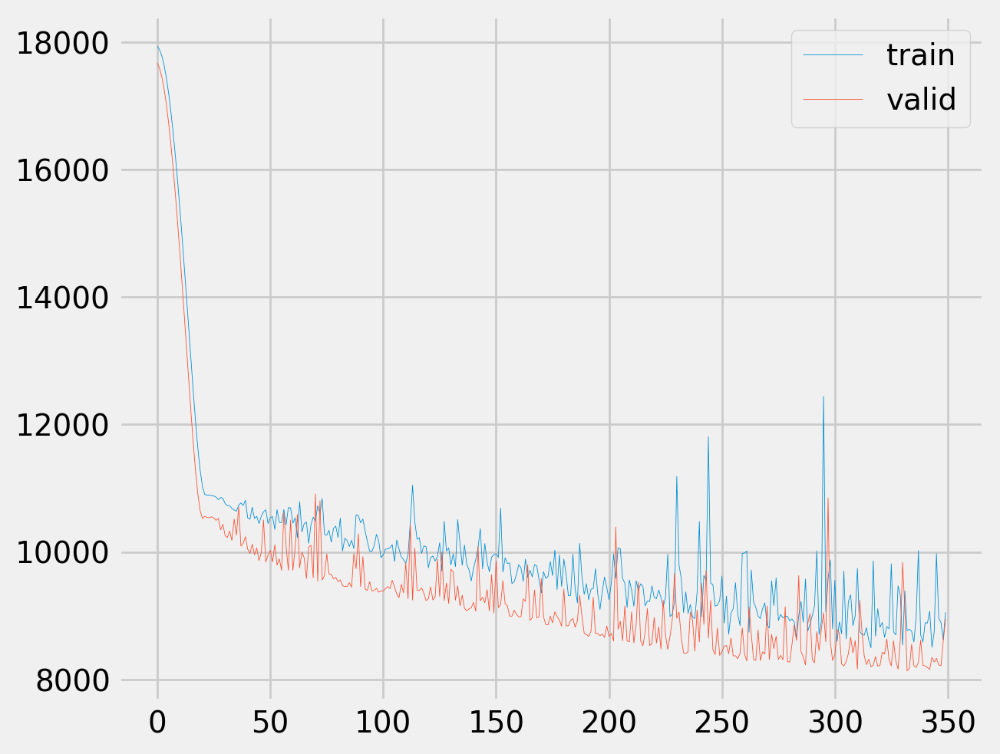

In [50]:
loss_train = np.array(train_loss)
loss_valid = np.array(val_loss)

fig, ax = plt.subplots()

ax.plot(range(len(loss_train)),loss_train,label='train',lw=0.3)
ax.plot(range(len(loss_valid)),loss_valid,label='valid',lw=0.3)
#ax.set_yscale('log')
ax.legend();

In [51]:
best_model = torch.load(os.path.join(save_dir,f'best_{file_name}'))

<ipython-input-51-1790dcb0272c>:1: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  best_model = torch.load(os.path.join(save_dir,f'best_{file_name}'))


8163.385817171696 	r2 :  0.4492553472518921 	mape :  0.38305920362472534


/usr/local/lib/python3.11/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


8163.385817171696 	r2 :  0.4492553472518921 	mape :  0.38305920362472534


(<Figure size 640x480 with 1 Axes>, <Axes: >)

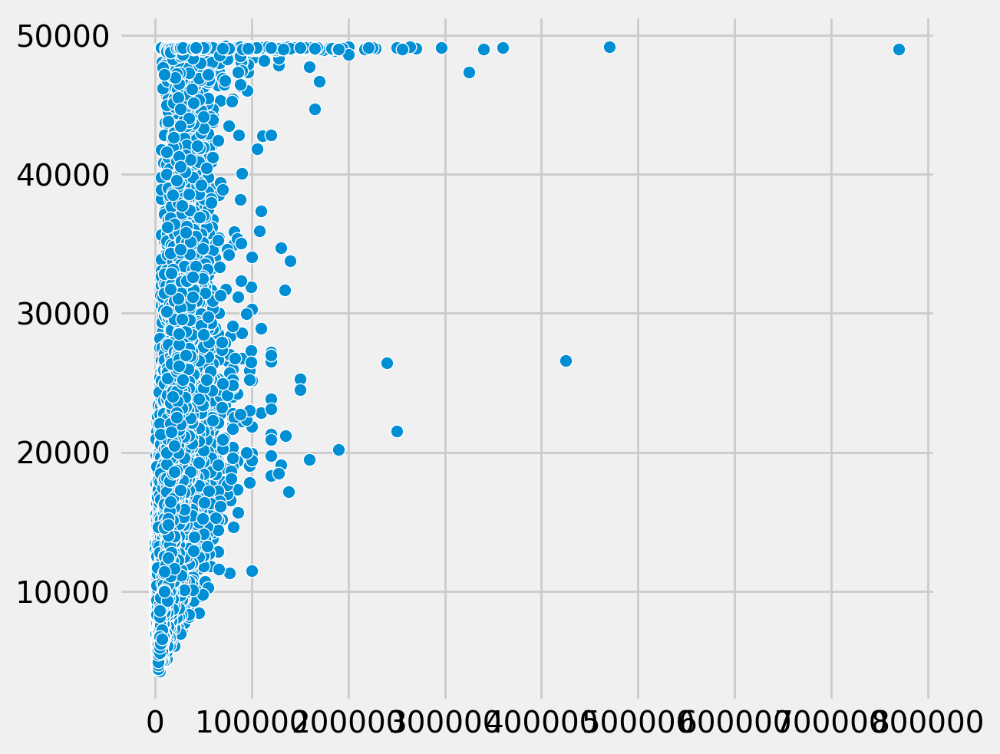

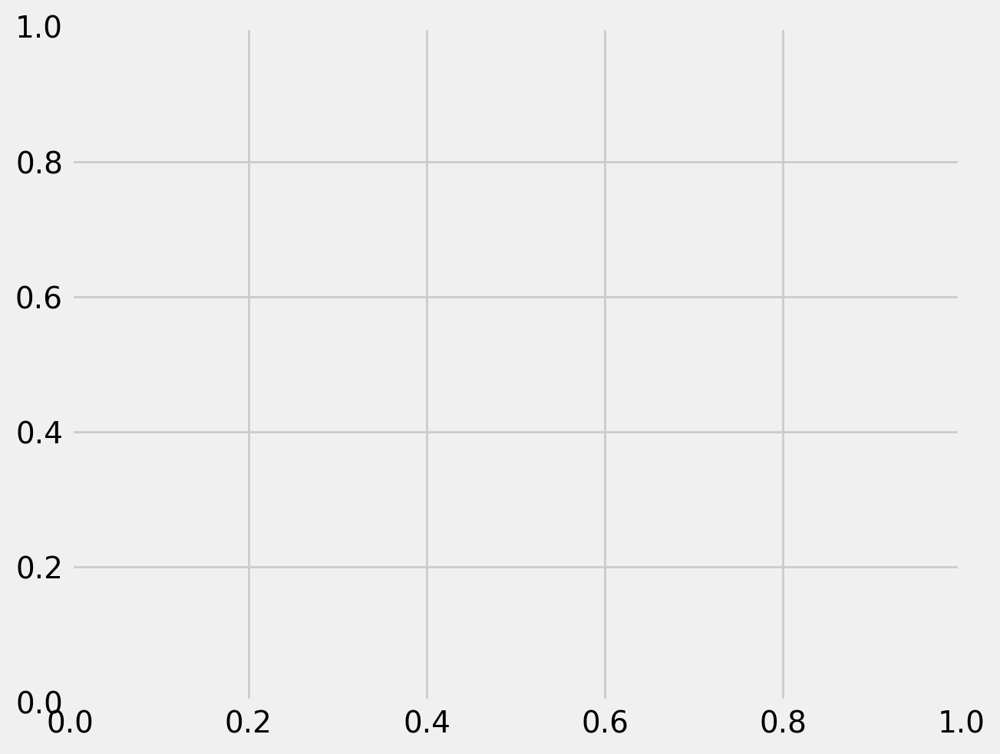

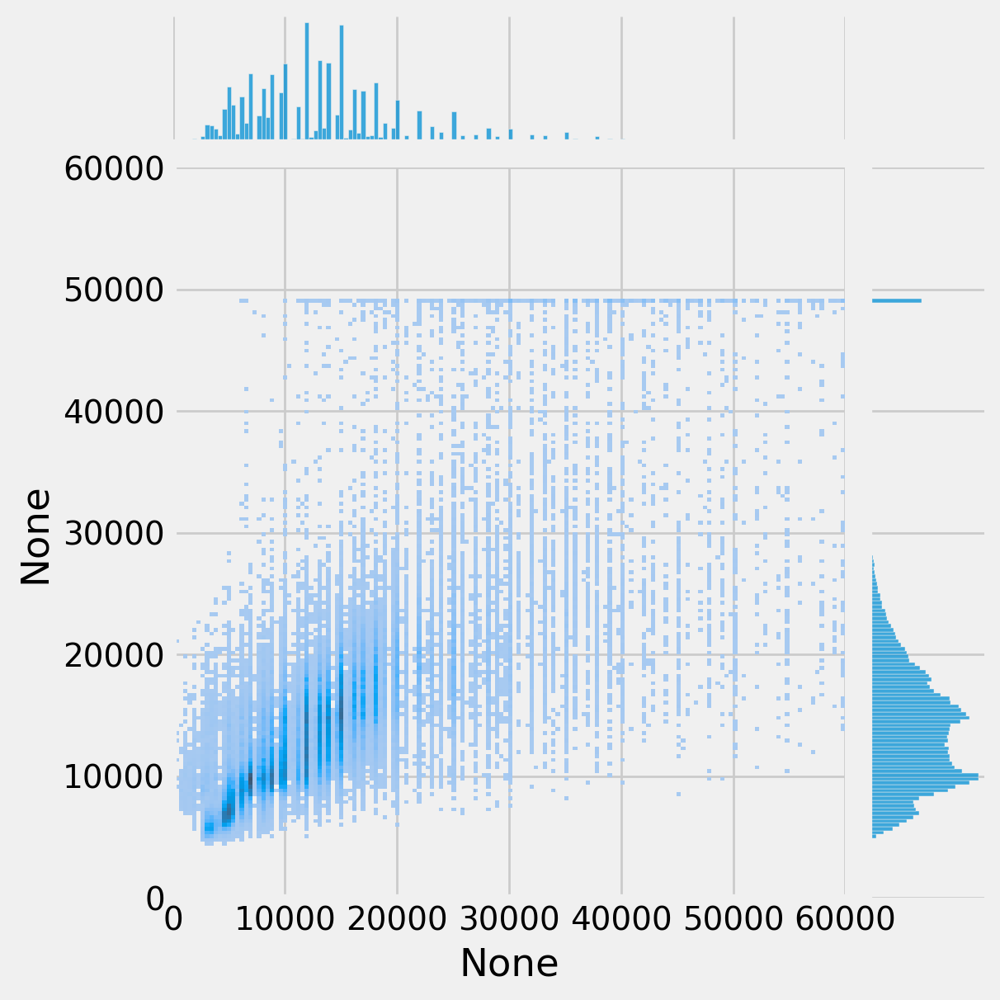

In [53]:
test_n_plot(best_model,iter_dict['trn'],criterion,device) #gridsize 500
test_n_plot(best_model,iter_dict['trn'],criterion,device,scatter=False) #gridsize 500

7945.476700614004 	r2 :  0.40907347202301025 	mape :  0.40415382385253906


/usr/local/lib/python3.11/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


7945.476700614004 	r2 :  0.40907347202301025 	mape :  0.40415382385253906


(<Figure size 640x480 with 1 Axes>, <Axes: >)

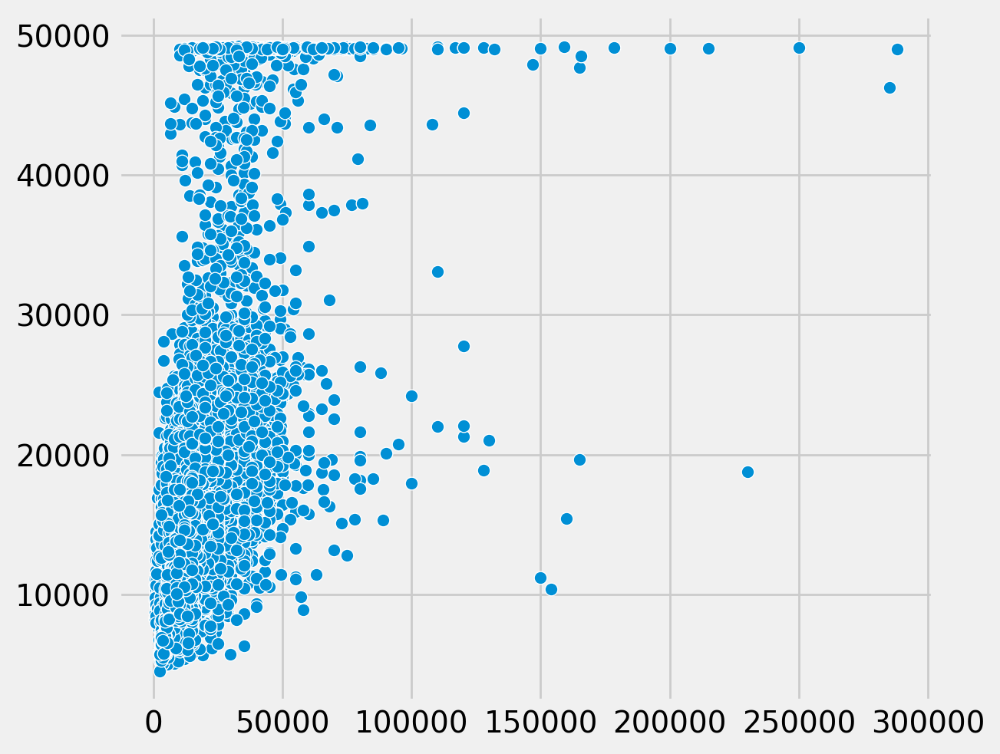

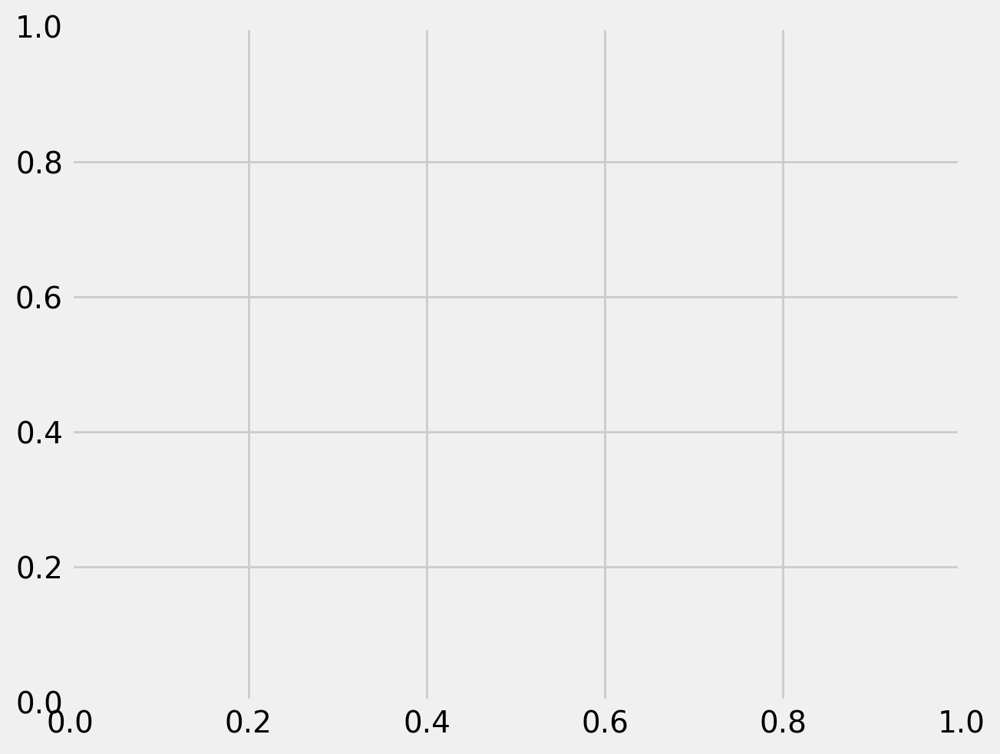

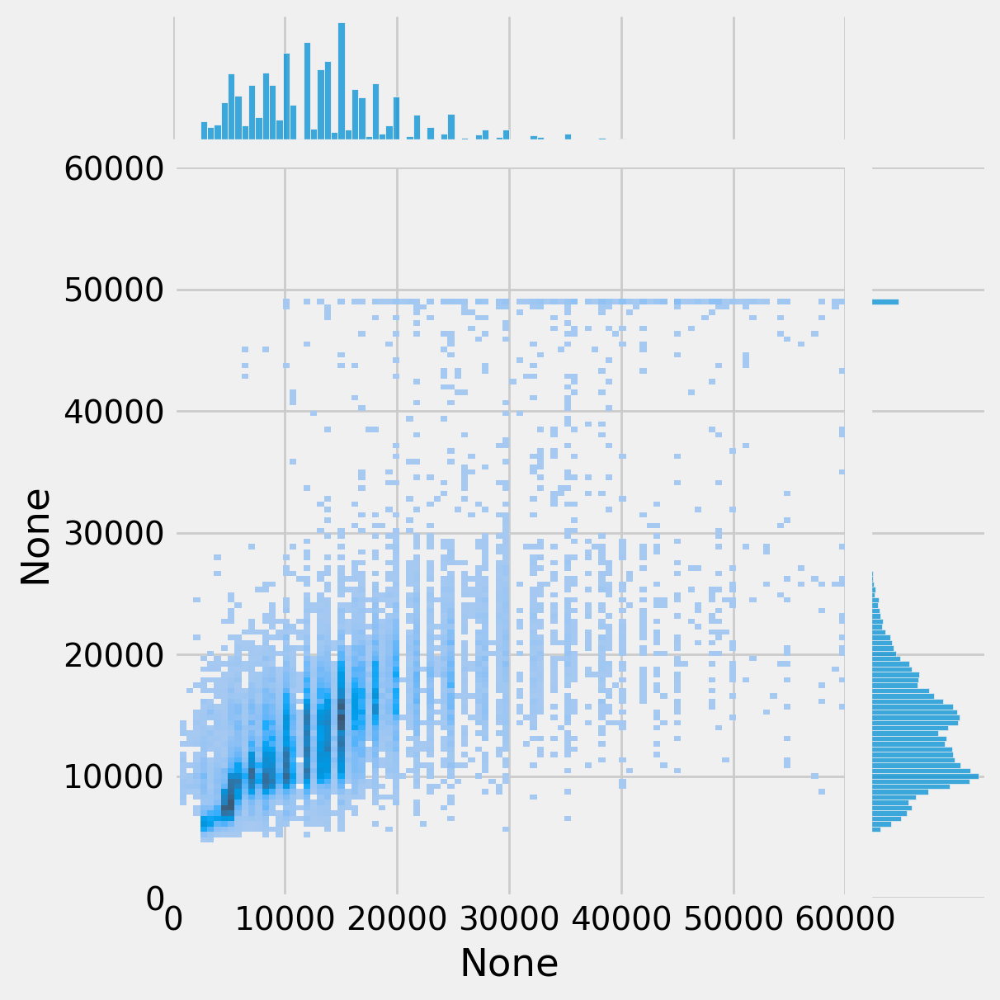

In [54]:
test_n_plot(best_model,iter_dict['vld'],criterion,device) #gridsize 180
test_n_plot(best_model,iter_dict['vld'],criterion,device,scatter=False) #gridsize 180

9113.618381301689 	r2 :  0.371997594833374 	mape :  0.4124220907688141


/usr/local/lib/python3.11/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


9113.618381301689 	r2 :  0.371997594833374 	mape :  0.4124220907688141


(<Figure size 640x480 with 1 Axes>, <Axes: >)

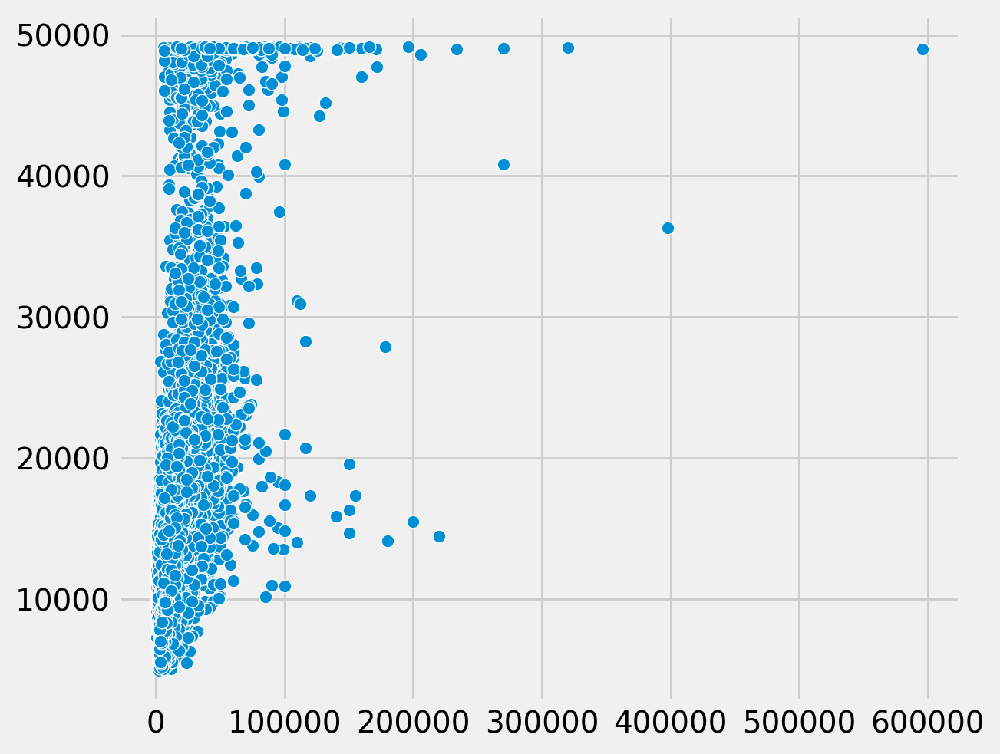

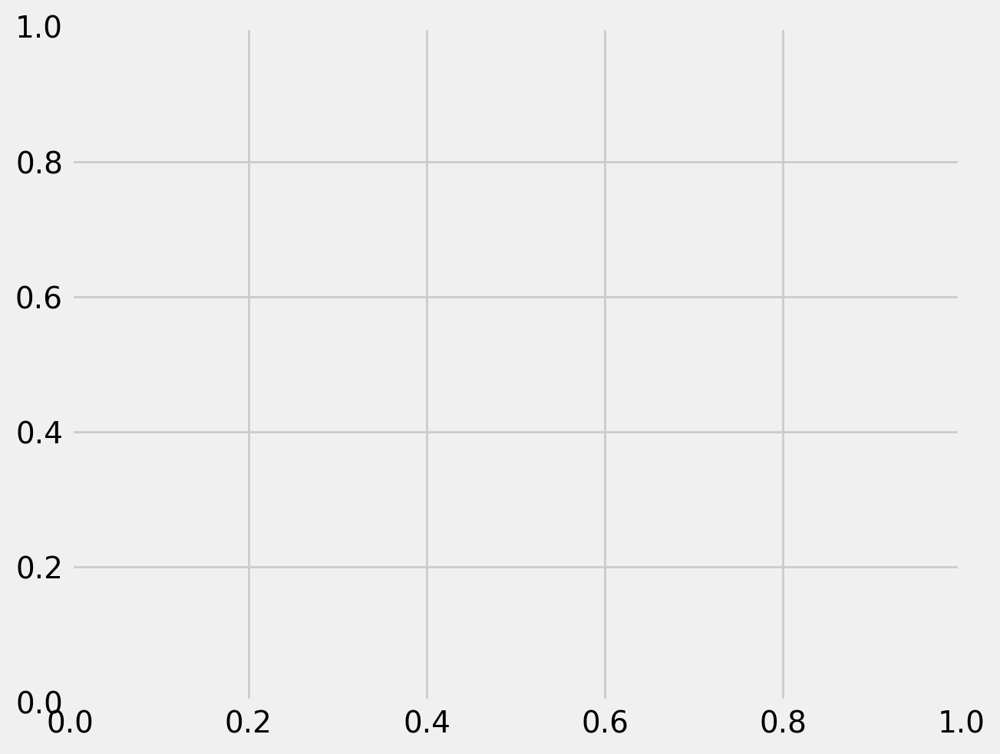

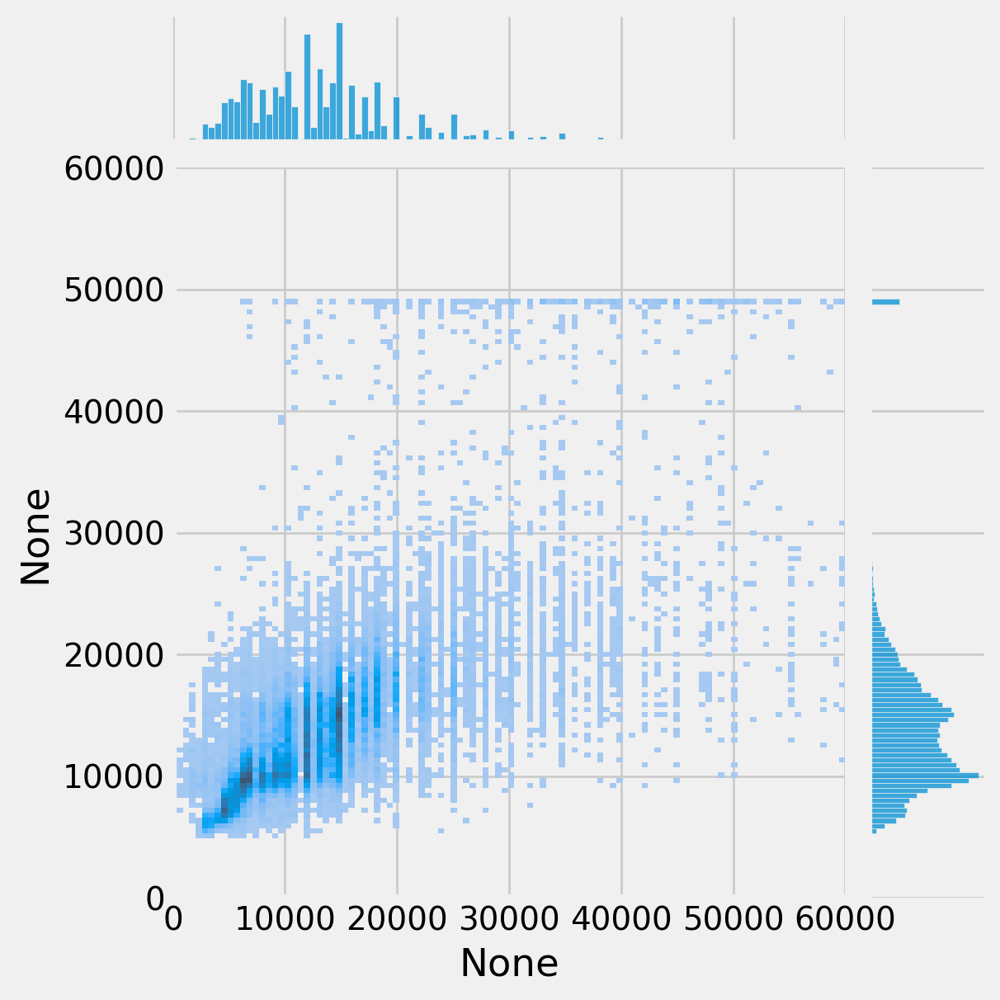

In [55]:
test_n_plot(best_model,iter_dict['tst'],criterion,device) #gridsize 350
test_n_plot(best_model,iter_dict['tst'],criterion,device,scatter=False) #gridsize 350

6266.787119409753 	r2 :  0.6747660636901855 	mape :  0.31967178


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


6266.787119409753 	r2 :  0.6747660636901855 	mape :  0.31967178


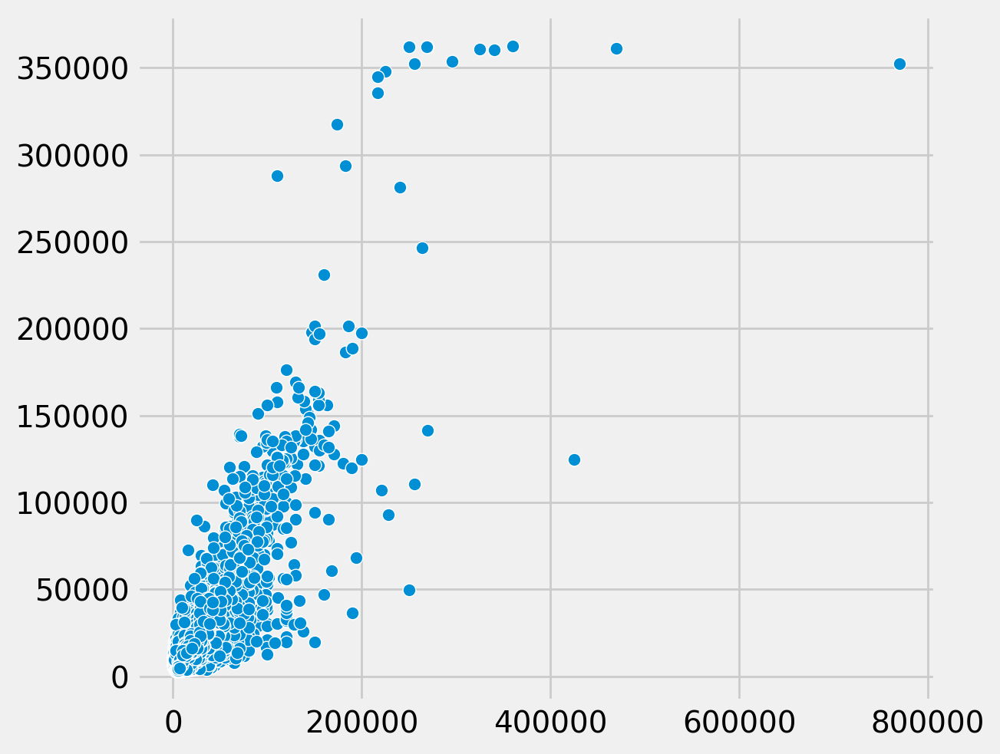

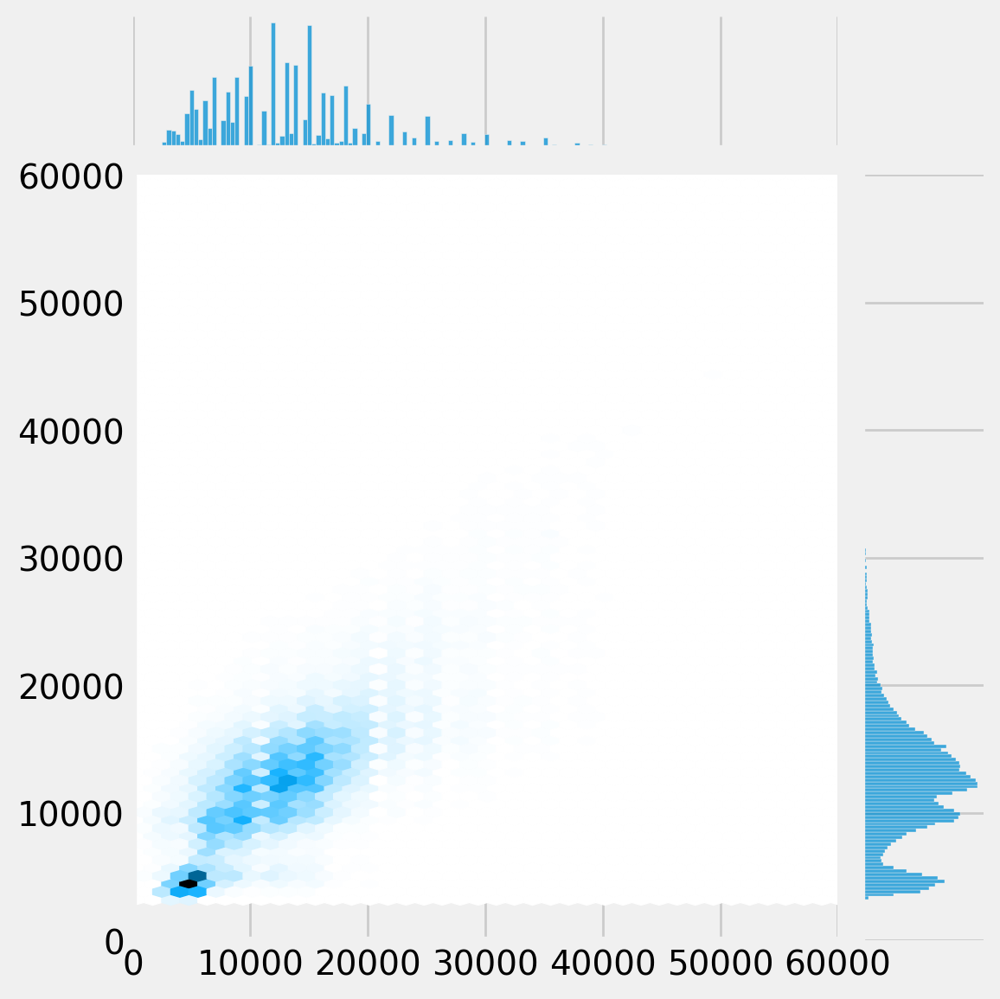

In [ ]:
test_n_plot(model,iter_dict['trn'],criterion,device) #gridsize 500
test_n_plot(model,iter_dict['trn'],criterion,device,scatter=False,gridsize=500) #gridsize 500

8262.704762969568 	r2 :  0.4583730101585388 	mape :  0.35924602


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


8262.704762969568 	r2 :  0.4583730101585388 	mape :  0.35924602


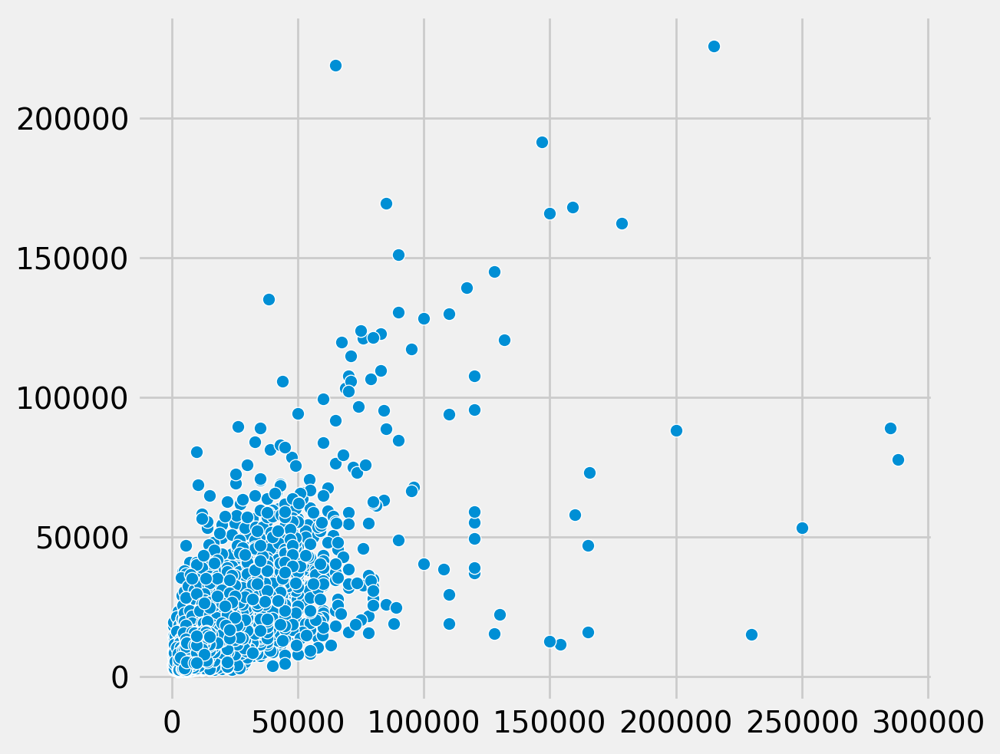

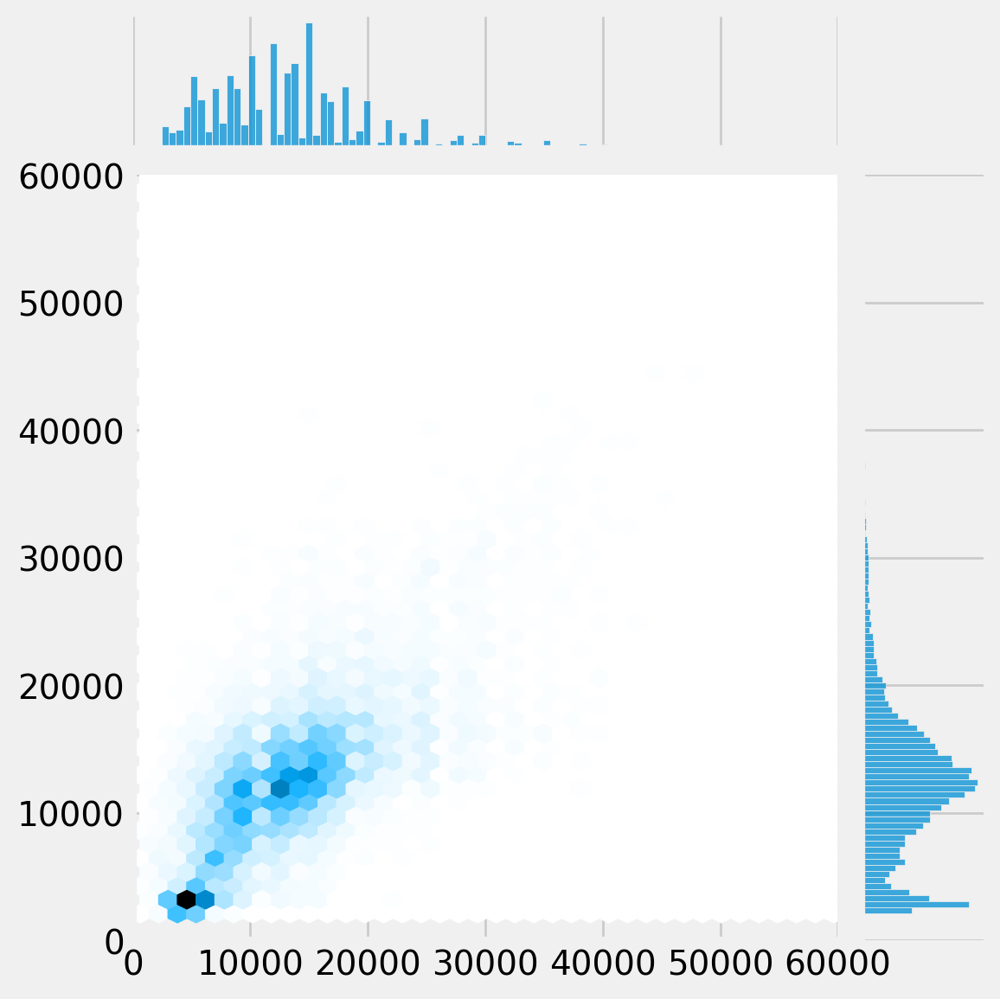

In [ ]:
test_n_plot(model,iter_dict['vld'],criterion,device) #gridsize 180
test_n_plot(model,iter_dict['vld'],criterion,device,scatter=False,gridsize=180)

8606.021670899976 	r2 :  0.4417092204093933 	mape :  0.359285


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


8606.021670899976 	r2 :  0.4417092204093933 	mape :  0.359285


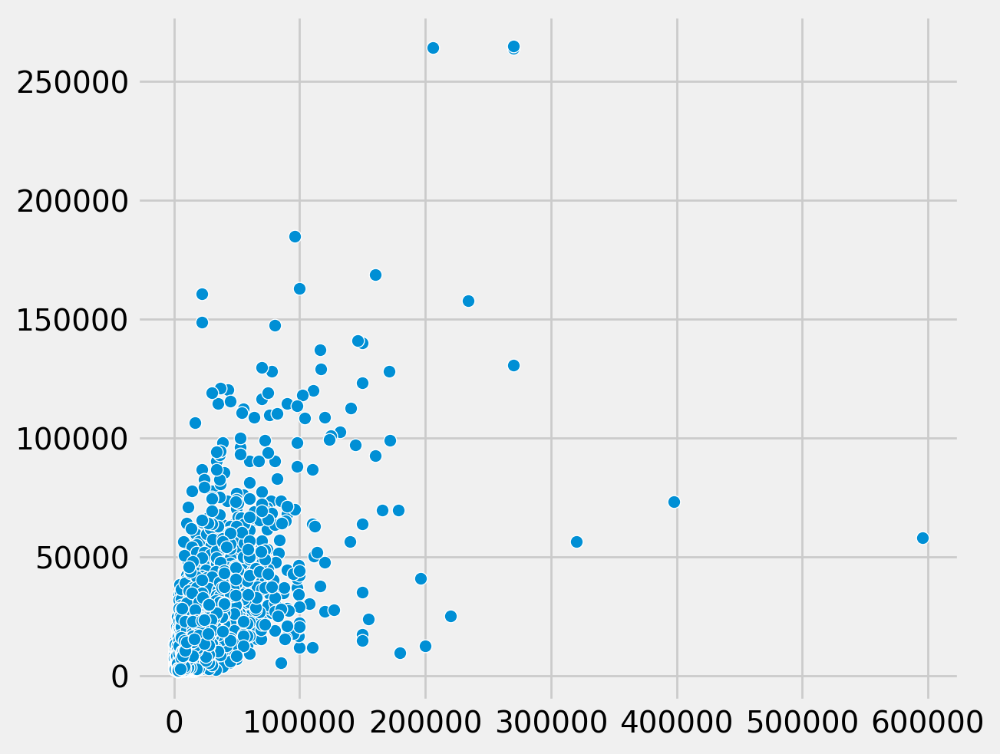

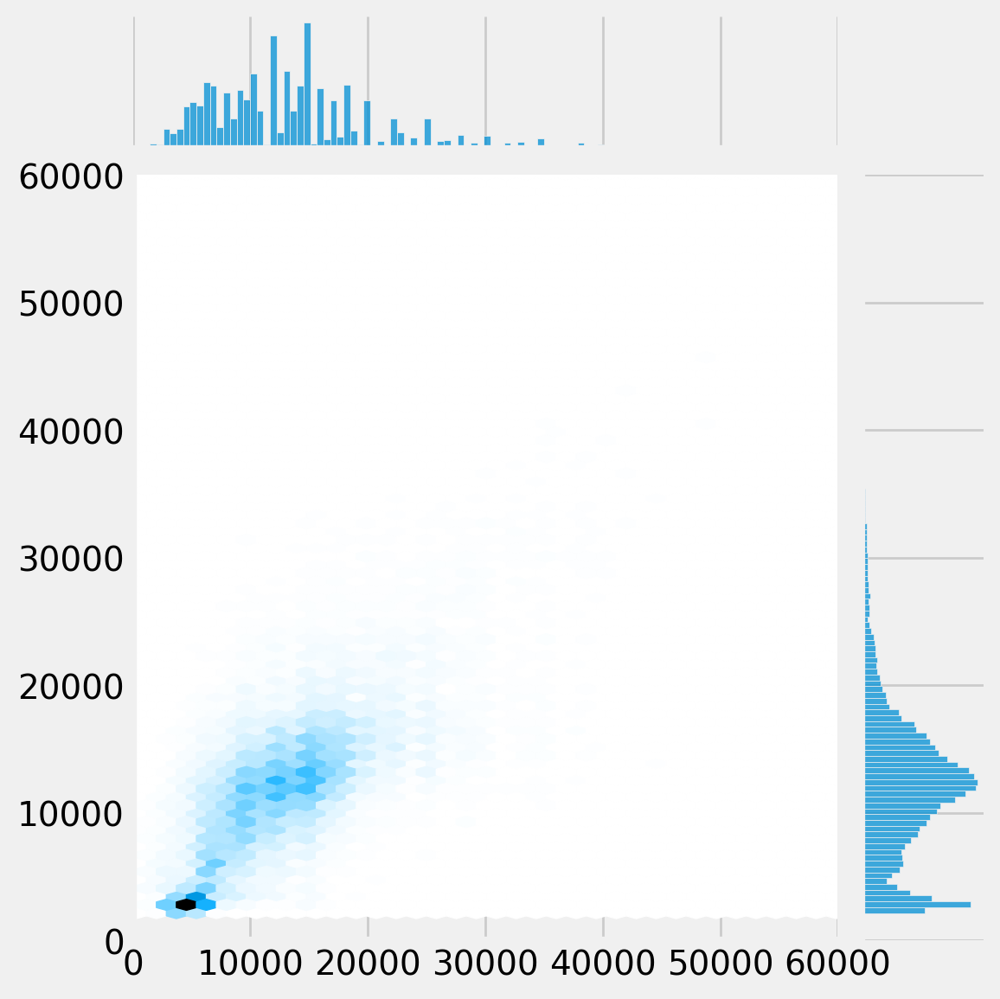

In [ ]:
test_n_plot(model,iter_dict['tst'],criterion,device) #gridsize 350
test_n_plot(model,iter_dict['tst'],criterion,device,scatter=False,gridsize=350) #gridsize 350

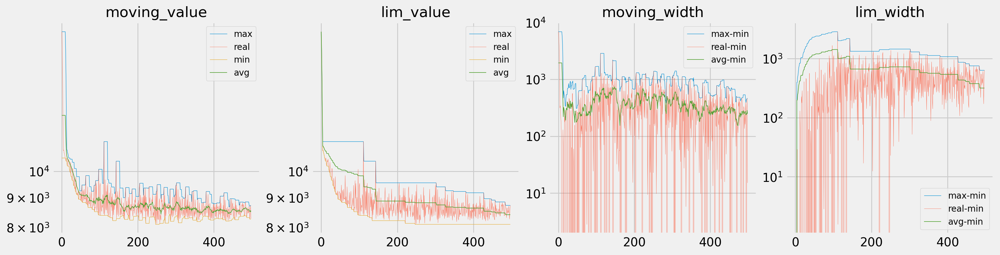

In [ ]:
x = val_loss
plot_area(x,start=0,end=-1);
#plot_area(x,start=750,end=-1,log=False);

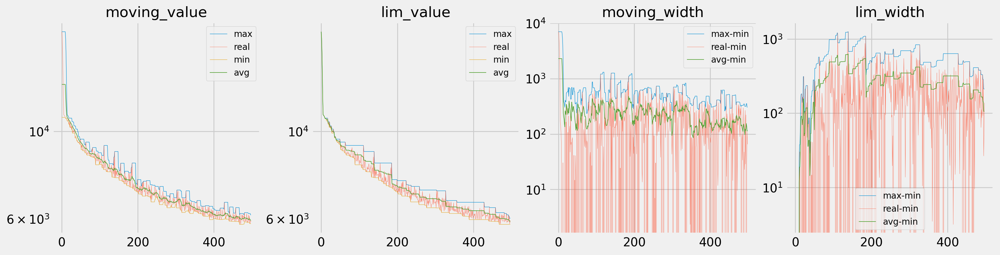

In [ ]:
x = train_loss
plot_area(x,start=0,end=-1);

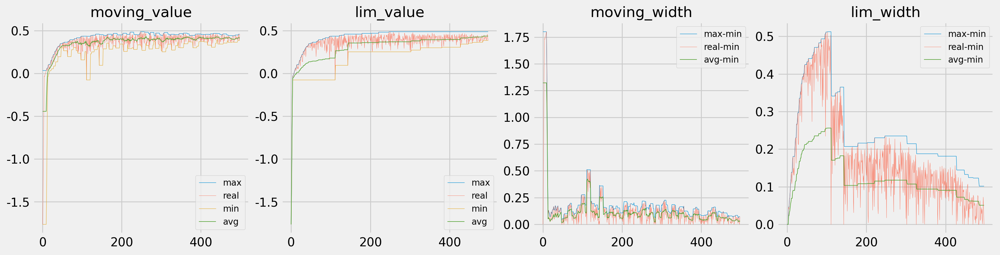

In [ ]:
x = val_score
plot_area(x,False,start=0,end=-1,log=False);

other lr

In [ ]:
d_model = 60 #64
head = 6
d_ff = 128
n_layers= 6

In [ ]:
from math import sqrt
display((len(data_dict['trn']['X'])/4096 * 60 * 100*sqrt(6))**(-0.5) * 0.05*1.5)
display((len(data_dict['trn']['X'])/4096 * 60 * 100*(6))**(-0.5) * 0.05*1.5)
display((len(data_dict['trn']['X'])/4096 * 60 * 500*sqrt(6))**(-0.5))

0.00012447882654827765

7.953488784768985e-05

0.0007422483144569449

In [ ]:
# model parameter setting
batch_size = 4096

# optimizer parameter setting
init_lr = (469/450)*(228/450)*1.24*1e-4#1.76*1e-3 #9.52*1e-5 #5*1e-3#*3
factor = 0.95
adam_eps = 5e-7
patience = 10
warmup = 3
epoch = 500
clip = 1.0
weight_decay = 5e-20
drop_prob = 0.1

In [ ]:
model = Model5(col_start,d_model,head,d_ff,drop_prob,n_layers,device)
model, optimizer, scheduler, criterion =trainer_setting(model,init_lr,weight_decay,adam_eps,factor,patience)

The model has 15,101,593 trainable parameters


/content/drive/MyDrive/kdt-EST-AI/project/project2/module_aladin/torch_train.py:151: FutureWarning: `nn.init.kaiming_uniform` is now deprecated in favor of `nn.init.kaiming_uniform_`.
  nn.init.kaiming_uniform(m.weight.data)
/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(


# train, evaluate

In [ ]:
model_name = 'model5'
expt_name = f'{model_name}_{batch_size}_{epoch}_N{n_layers}_lr{init_lr:.5f}'
save_dir = os.path.join(RSLT_DIR,'model',expt_name)
if not os.path.exists(save_dir) : os.makedirs(save_dir)
file_name = 'model_{}.pt'.format(241110)

In [ ]:
iter_dict.keys()

dict_keys(['vld', 'trn', 'tst'])

In [ ]:
train_config =[optimizer, scheduler, criterion, clip]

In [ ]:
model,train_loss,val_loss,train_score,val_score,best_epoch = run(model,train_config,iter_dict['trn'],iter_dict['vld'],epoch,warmup,8500,save_dir,file_name[:-3])
torch.save(model,os.path.join(save_dir,file_name))
save_pkl(save_dir,'train_loss.pkl',train_loss)
save_pkl(save_dir,'valid_loss.pkl',val_loss)
save_pkl(save_dir,'valid_score.pkl',val_score)

Epoch:     1		lr: 0.00006548
	Train Loss: 17834.314	Train Score: -1.633	Val Loss: 17024.299	Val Score: -1.675
Epoch:     2		lr: 0.00006548
	Train Loss: 16190.296	Train Score: -1.174	Val Loss: 13685.254	Val Score: -0.715
Epoch:     3		lr: 0.00006548
	Train Loss: 12267.140	Train Score: -0.249	Val Loss: 10776.319	Val Score: -0.049
Epoch:     4		lr: 0.00006548
	Train Loss: 11032.706	Train Score: -0.008	Val Loss: 10557.334	Val Score: -0.006
Epoch:     5		lr: 0.00006548
	Train Loss: 10989.195	Train Score: -0.000	Val Loss: 10568.887	Val Score: -0.008
Epoch:     6		lr: 0.00006548
	Train Loss: 10923.391	Train Score: 0.012	Val Loss: 10692.919	Val Score: -0.032
Epoch:     7		lr: 0.00006548
	Train Loss: 10877.561	Train Score: 0.020	Val Loss: 10205.200	Val Score: 0.064
Epoch:     8		lr: 0.00006548
	Train Loss: 10842.803	Train Score: 0.026	Val Loss: 10668.968	Val Score: -0.026
Epoch:     9		lr: 0.00006548
	Train Loss: 10743.070	Train Score: 0.044	Val Loss: 10018.478	Val Score: 0.102
Epoch:    10		lr

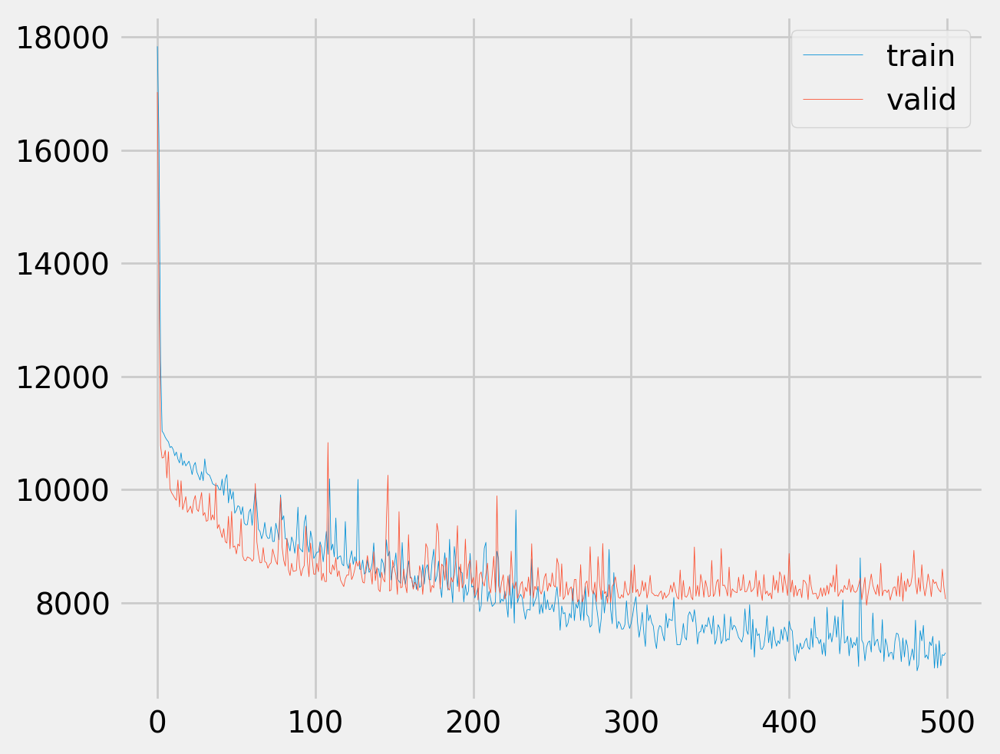

In [ ]:
loss_train = np.array(train_loss)
loss_valid = np.array(val_loss)

fig, ax = plt.subplots()

ax.plot(range(len(loss_train)),loss_train,label='train',lw=0.3)
ax.plot(range(len(loss_valid)),loss_valid,label='valid',lw=0.3)
#ax.set_yscale('log')
ax.legend();

In [ ]:
best_model = torch.load(os.path.join(save_dir,f'best_{file_name}'))

<ipython-input-55-1790dcb0272c>:1: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  best_model = torch.load(os.path.join(save_dir,f'best_{file_name}'))


6758.353604244157 	r2 :  0.6217008233070374 	mape :  0.3359533


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


6758.353604244157 	r2 :  0.6217008233070374 	mape :  0.3359533


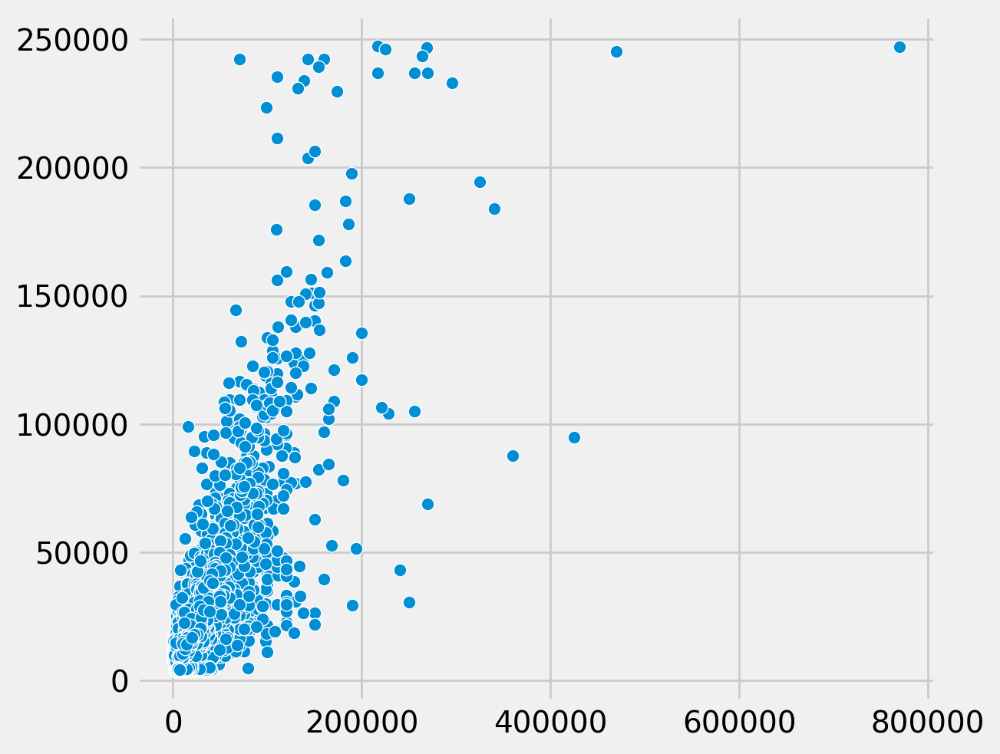

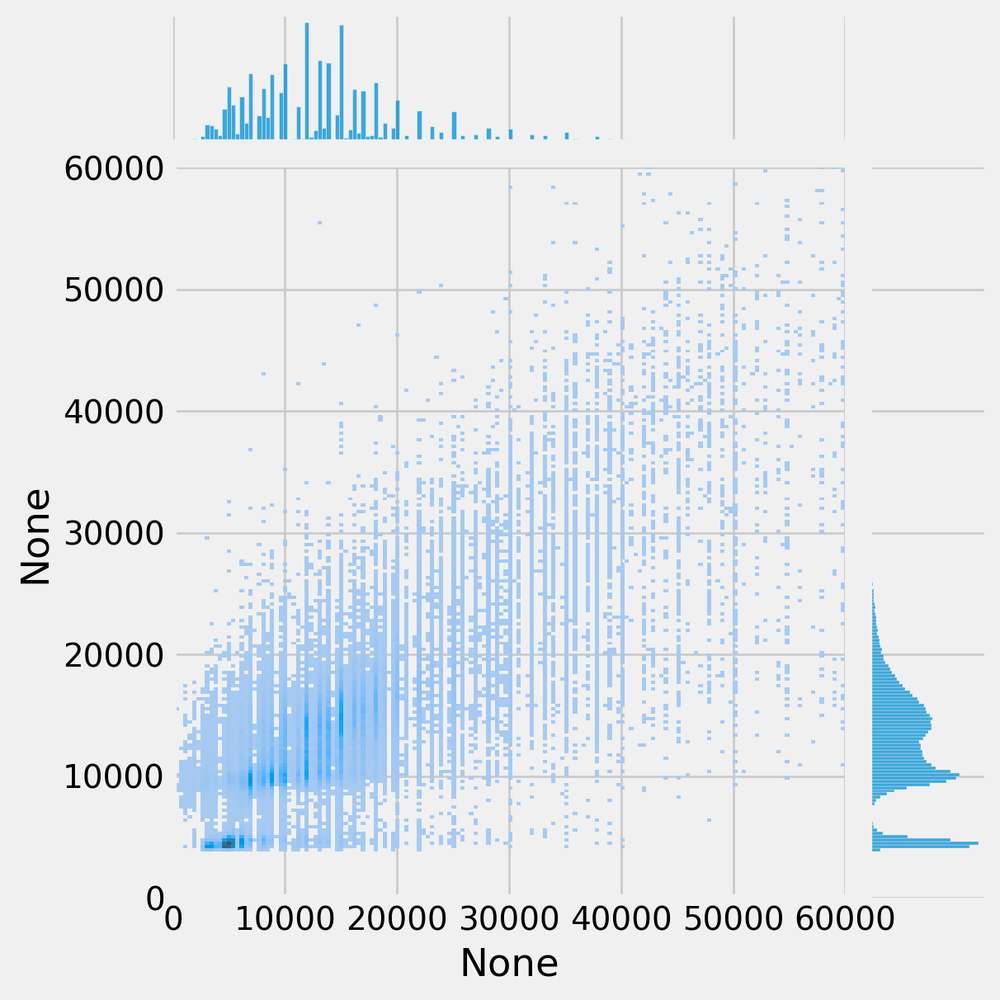

In [ ]:
test_n_plot(best_model,iter_dict['trn'],criterion,device) #gridsize 500
test_n_plot(best_model,iter_dict['trn'],criterion,device,scatter=False,kind='hist') #gridsize 500

7955.053344527974 	r2 :  0.45688629150390625 	mape :  0.34804118


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


7955.053344527974 	r2 :  0.45688629150390625 	mape :  0.34804118


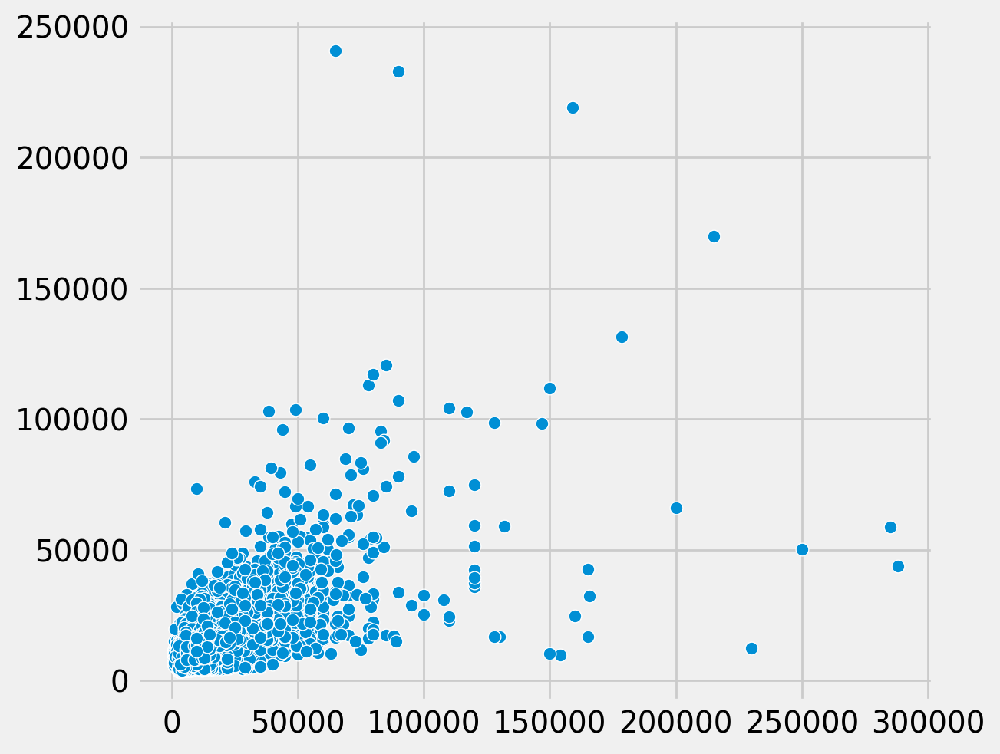

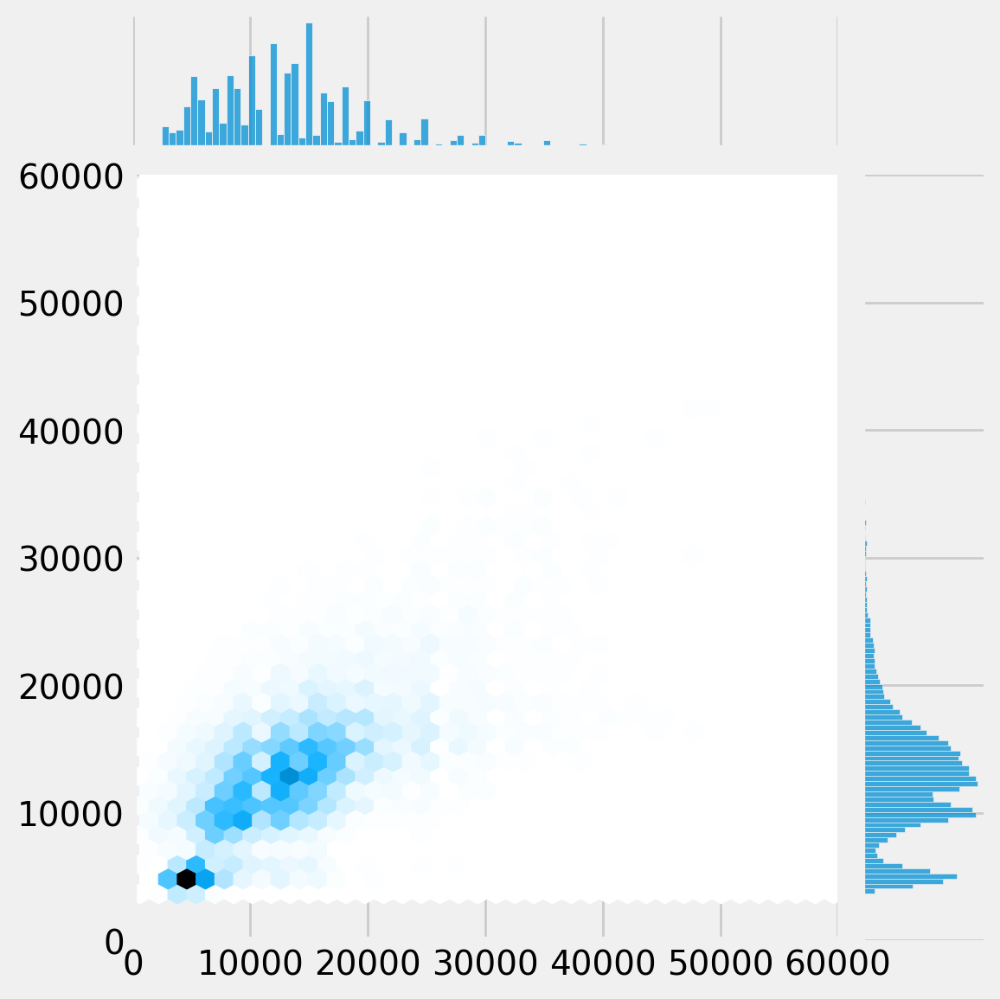

In [ ]:
test_n_plot(best_model,iter_dict['vld'],criterion,device) #gridsize 180
test_n_plot(best_model,iter_dict['vld'],criterion,device,scatter=False,gridsize=180) #gridsize 180

8256.699613041521 	r2 :  0.48334938287734985 	mape :  0.35116428


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


8256.699613041521 	r2 :  0.48334938287734985 	mape :  0.35116428


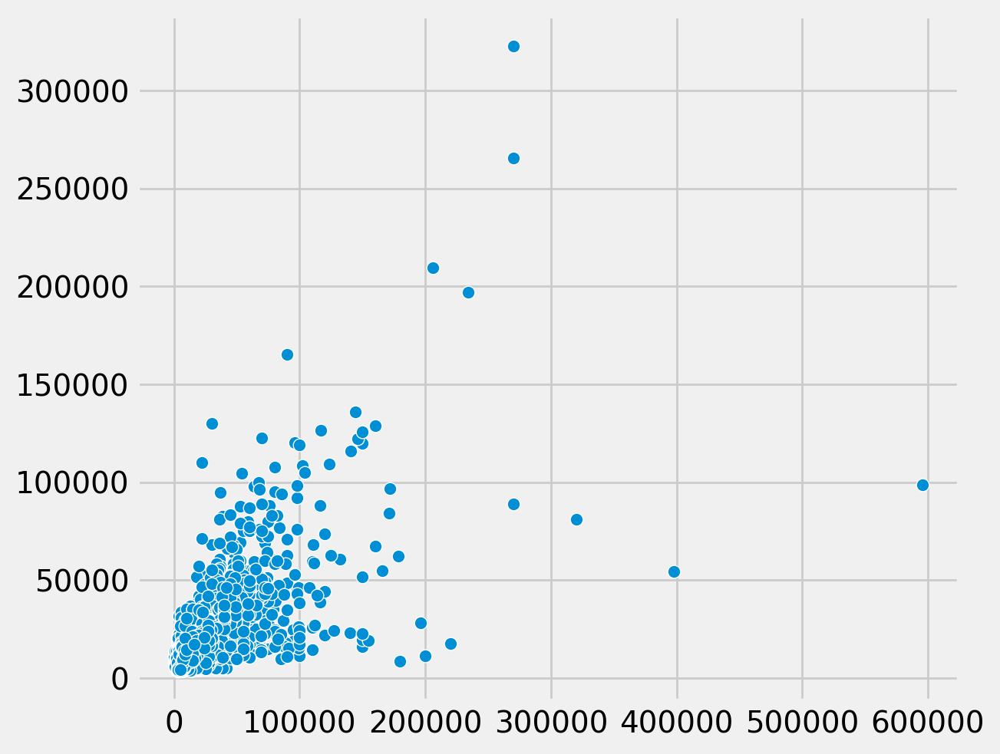

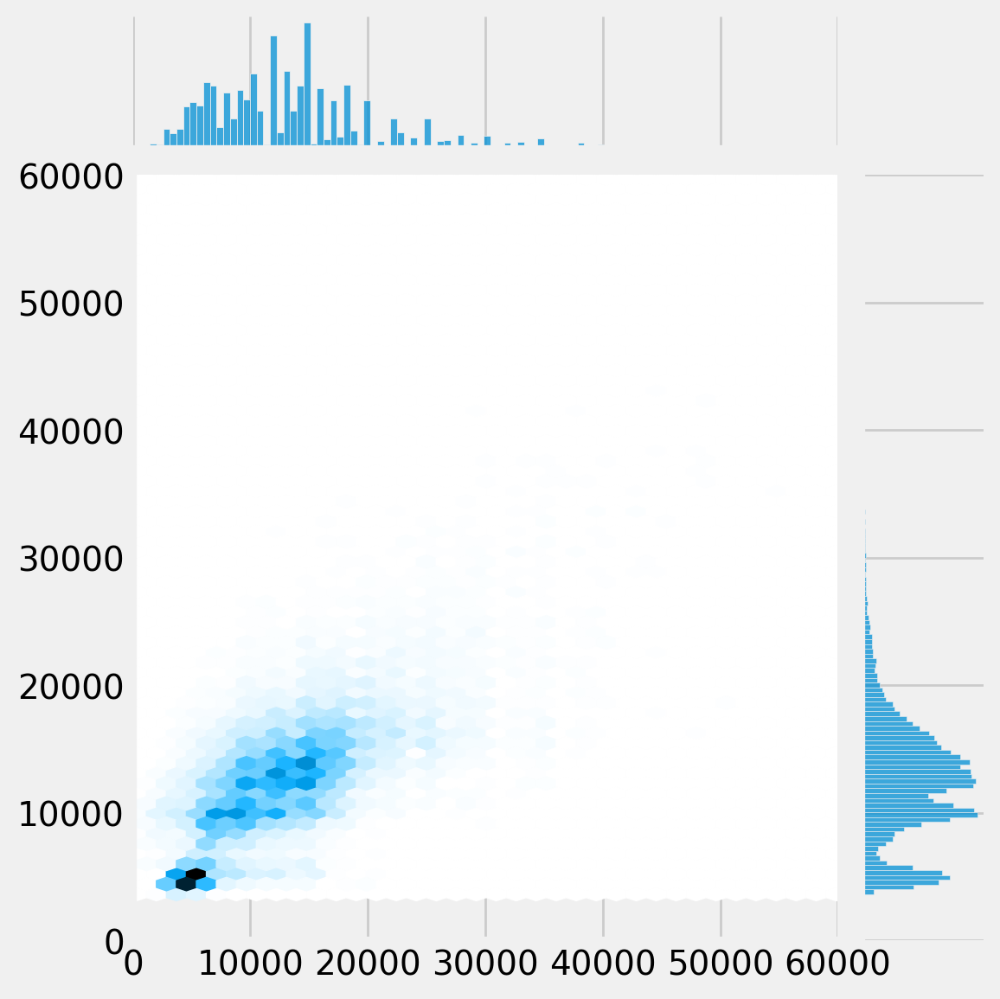

In [ ]:
test_n_plot(best_model,iter_dict['tst'],criterion,device) #gridsize 350
test_n_plot(best_model,iter_dict['tst'],criterion,device,scatter=False,gridsize=350) #gridsize 350

6266.787119409753 	r2 :  0.6747660636901855 	mape :  0.31967178


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


6266.787119409753 	r2 :  0.6747660636901855 	mape :  0.31967178


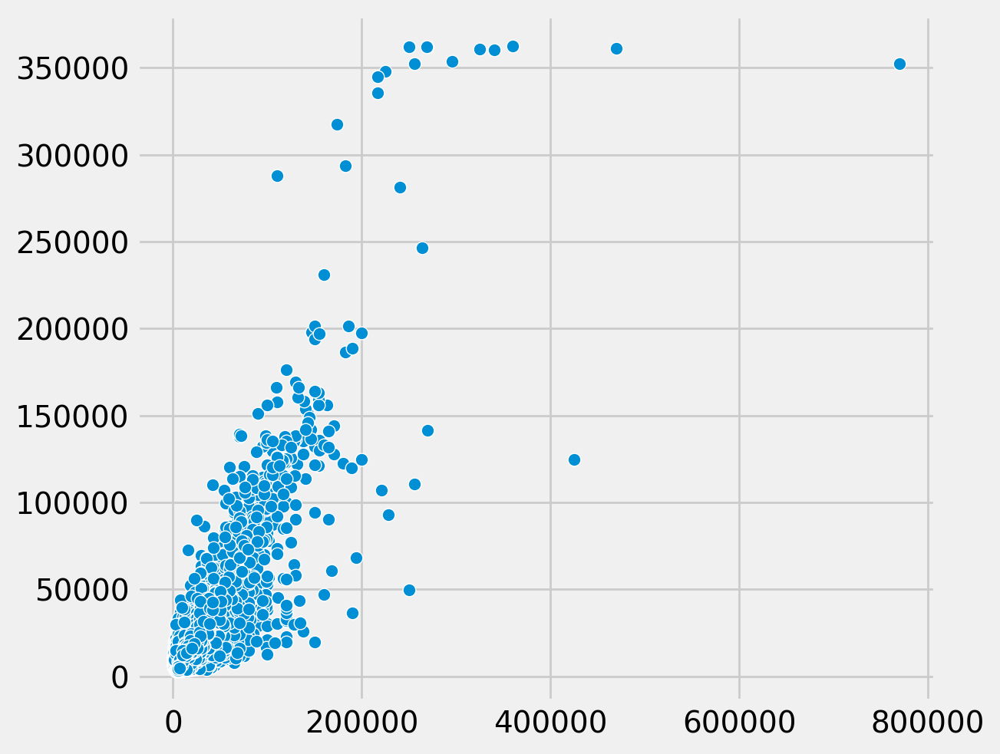

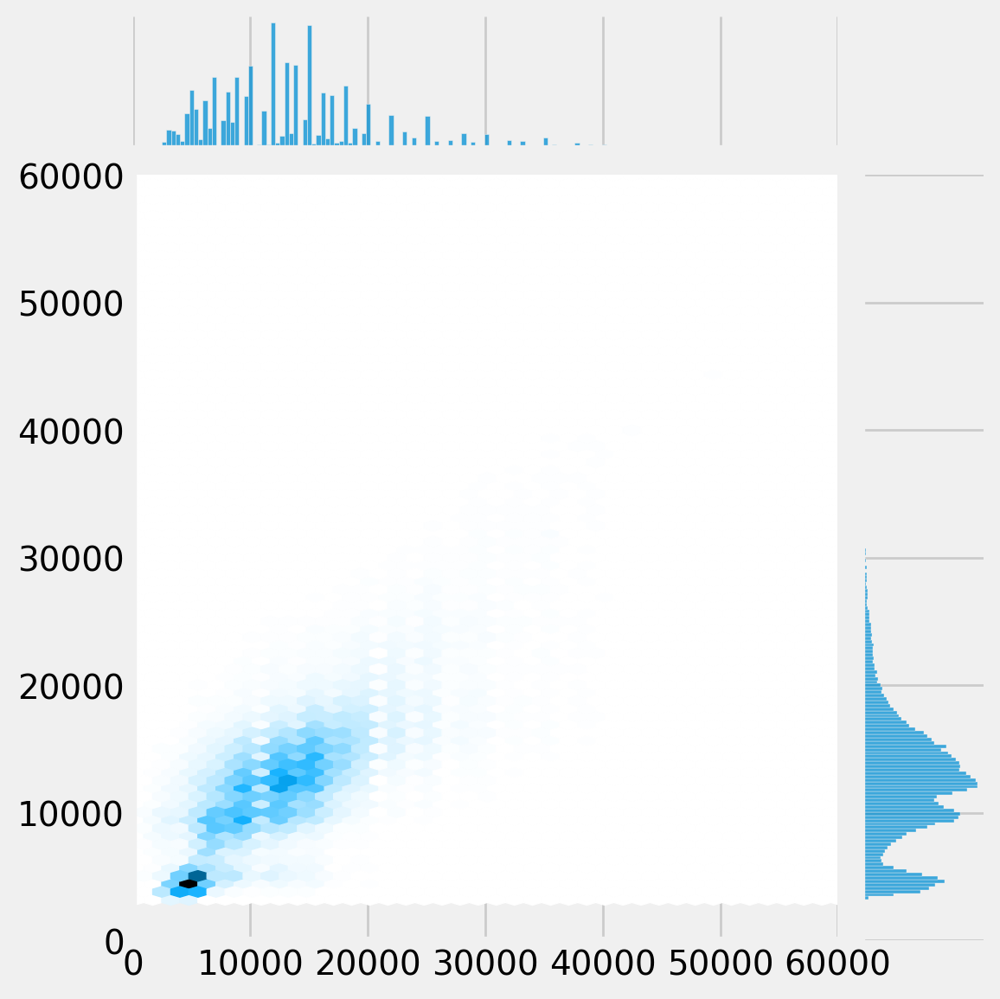

In [ ]:
test_n_plot(model,iter_dict['trn'],criterion,device) #gridsize 500
test_n_plot(model,iter_dict['trn'],criterion,device,scatter=False,gridsize=500) #gridsize 500

8064.608785126707 	r2 :  0.4388490319252014 	mape :  0.34466264


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


8064.608785126707 	r2 :  0.4388490319252014 	mape :  0.34466264


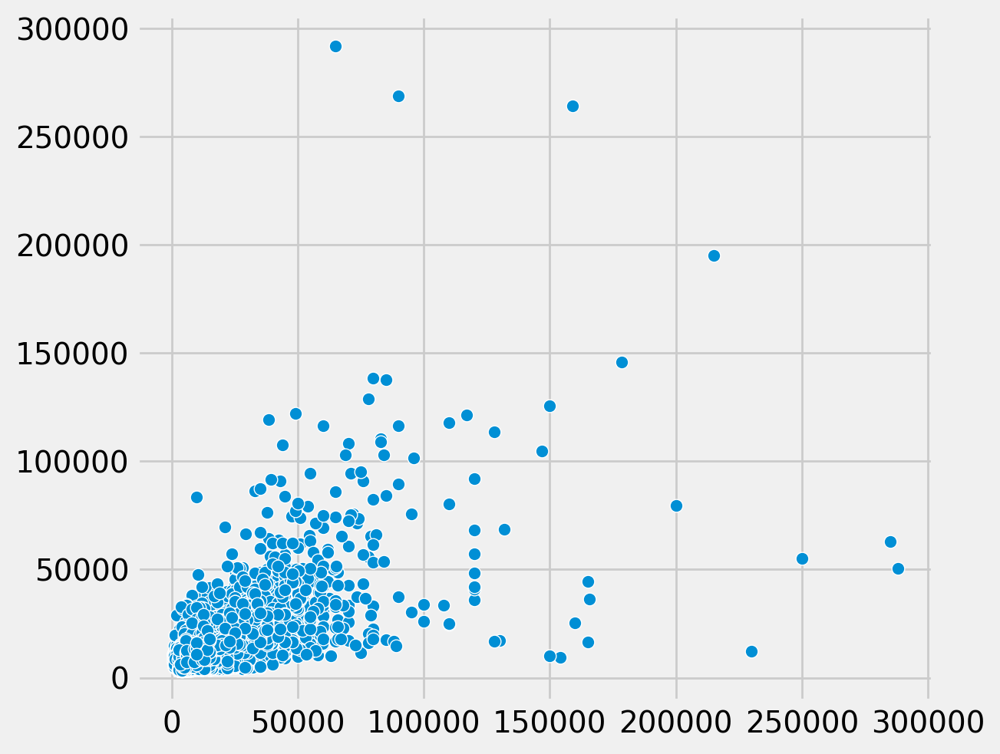

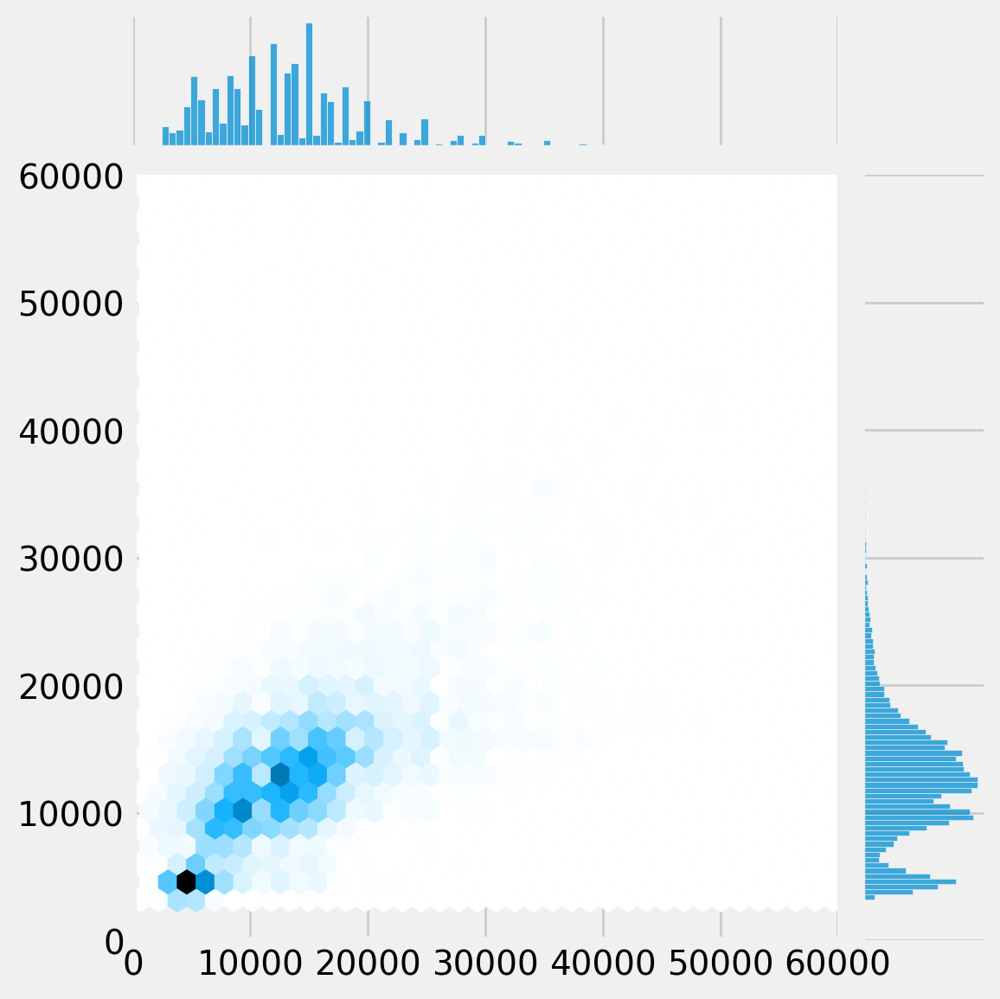

In [ ]:
test_n_plot(model,iter_dict['vld'],criterion,device) #gridsize 180
test_n_plot(model,iter_dict['vld'],criterion,device,scatter=False,gridsize=180)

8288.6750147415 	r2 :  0.4795674681663513 	mape :  0.3475241


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


8288.6750147415 	r2 :  0.4795674681663513 	mape :  0.3475241


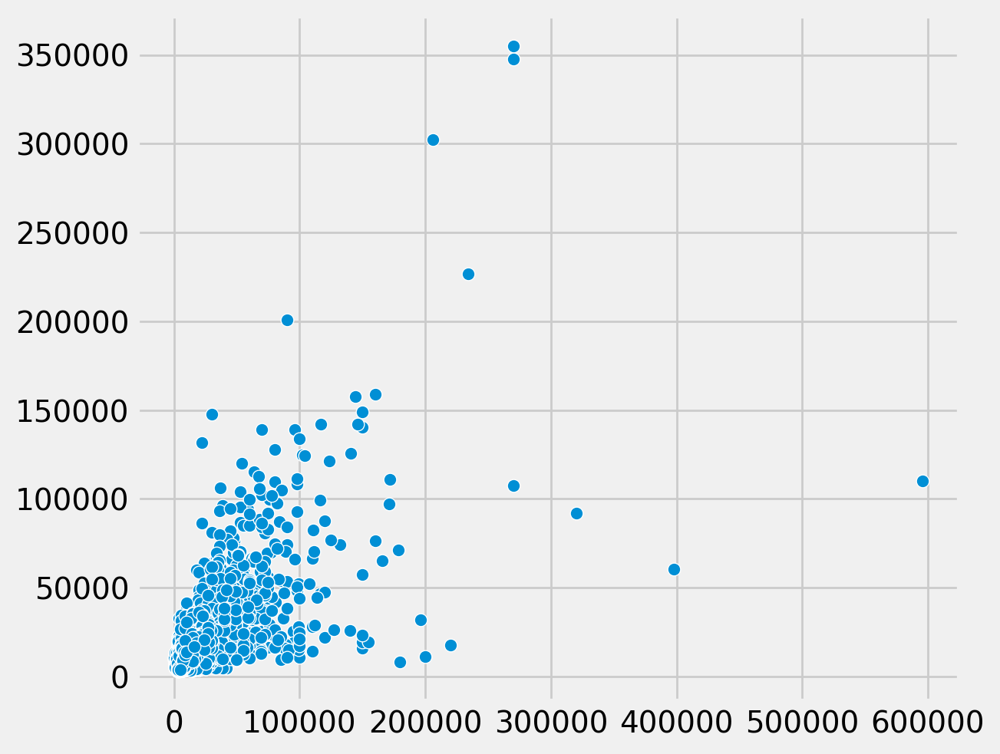

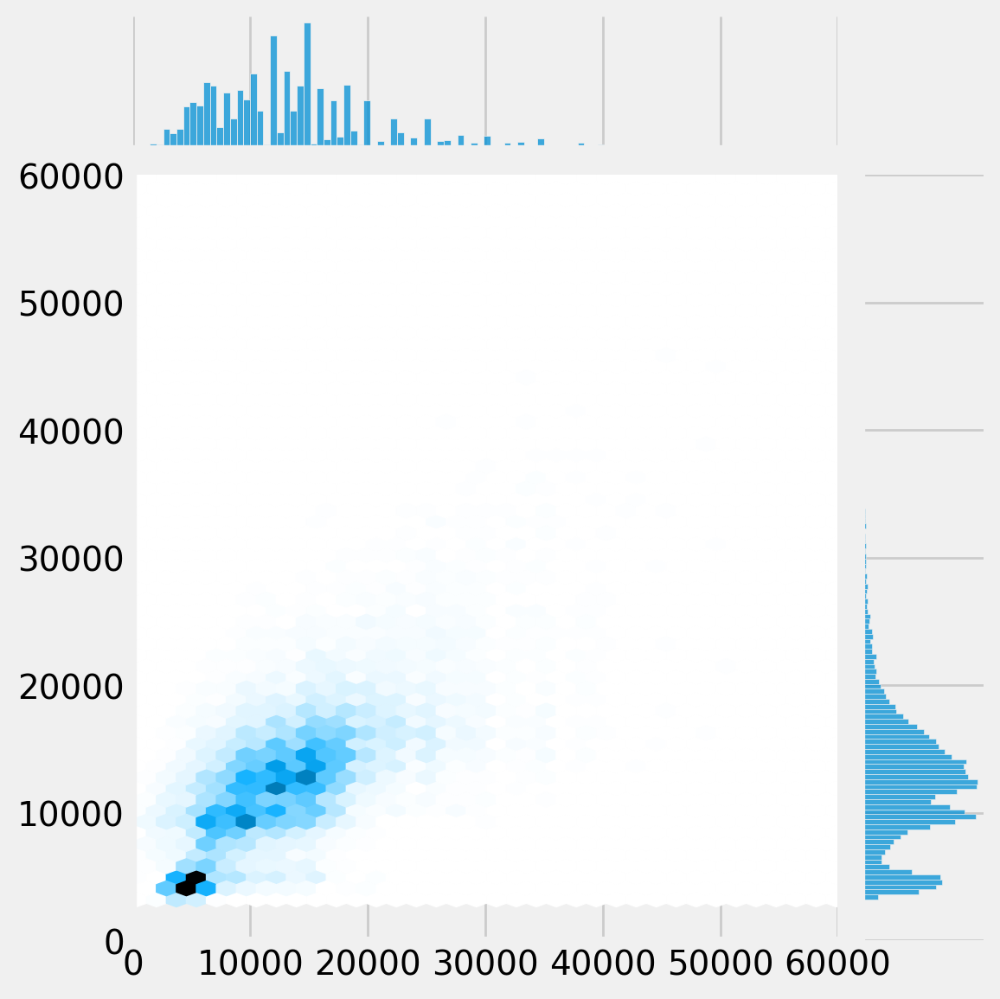

In [ ]:
test_n_plot(model,iter_dict['tst'],criterion,device) #gridsize 350
test_n_plot(model,iter_dict['tst'],criterion,device,scatter=False,gridsize=350) #gridsize 350

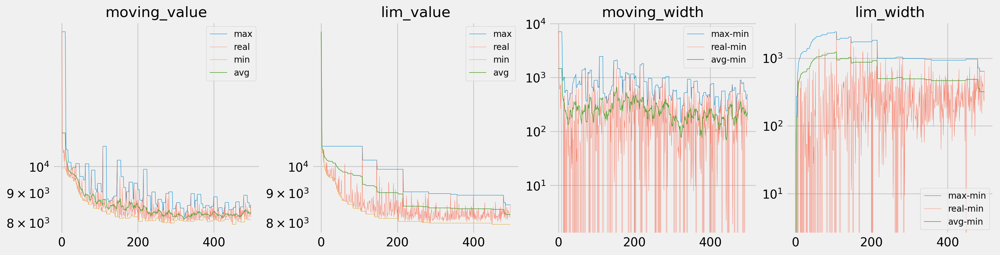

In [ ]:
x = val_loss
plot_area(x,start=0,end=-1);
#plot_area(x,start=750,end=-1,log=False);

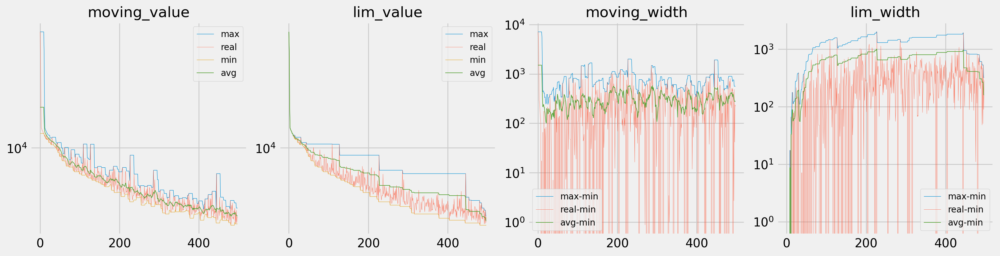

In [ ]:
x = train_loss
plot_area(x,start=0,end=-1);

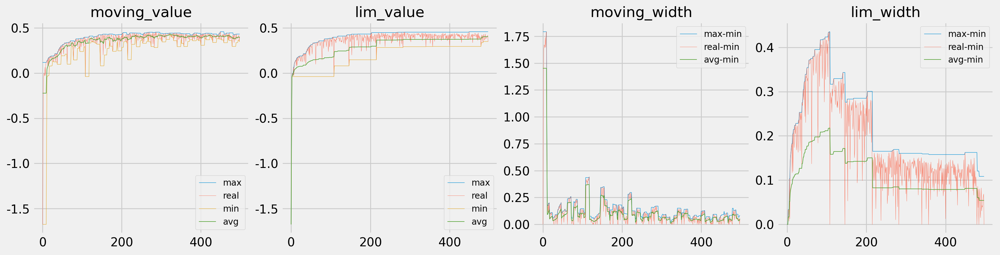

In [ ]:
x = val_score
plot_area(x,False,start=0,end=-1,log=False);

/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()
/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


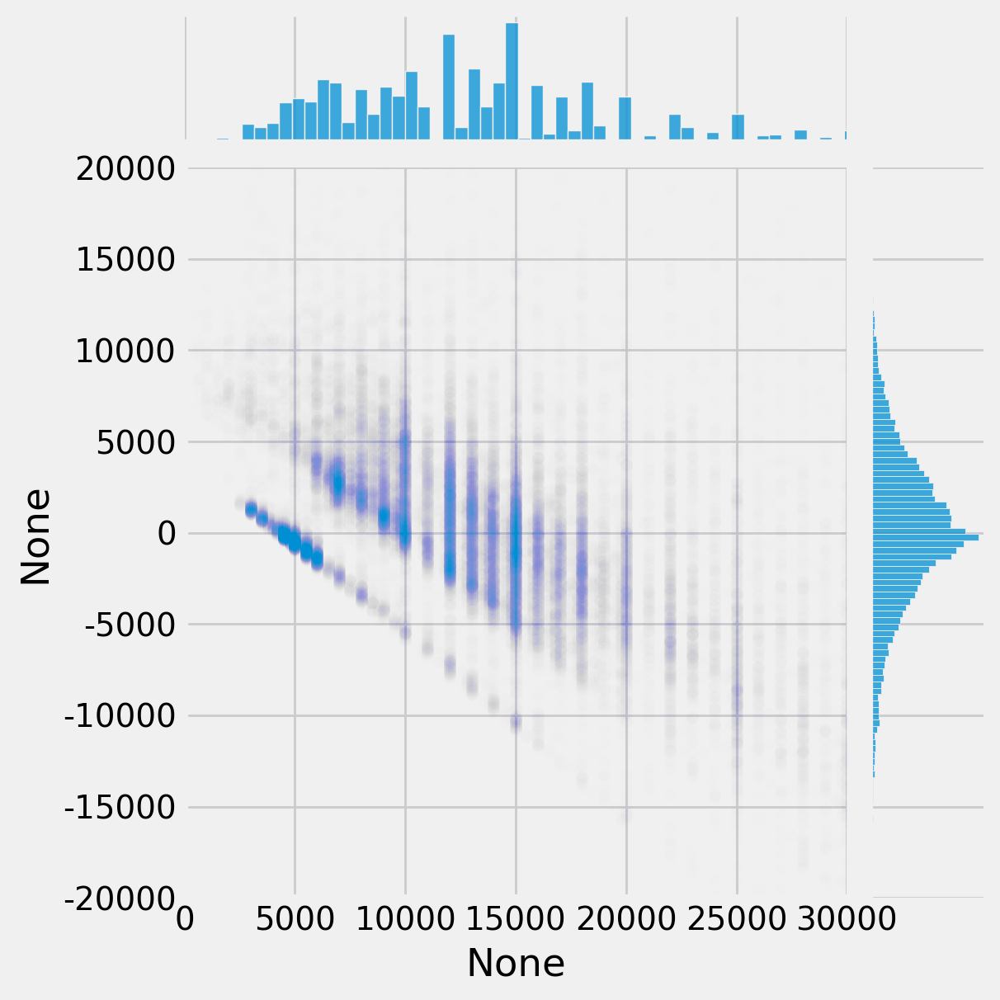

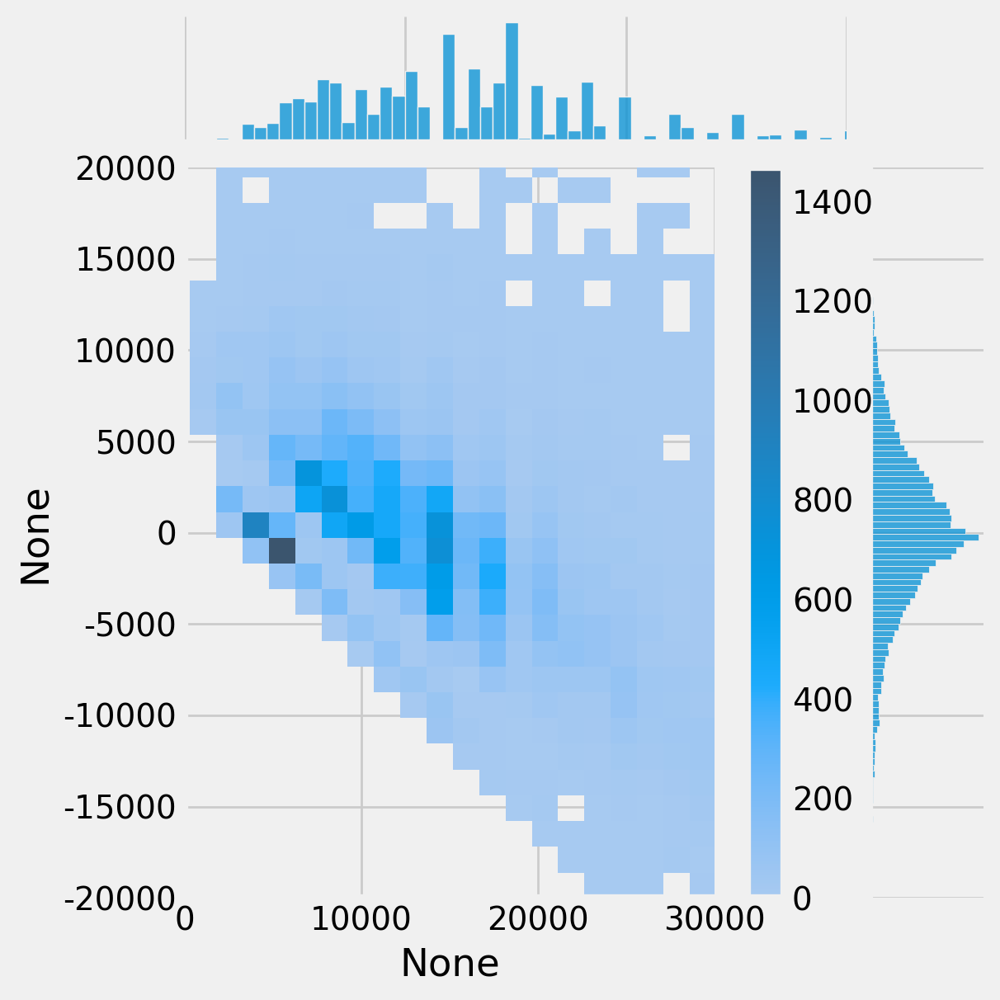

In [ ]:
test_plot_err_dist(best_model,iter_dict['tst'],criterion,device,percent=False,kind='scatter',s=30,alpha=0.002,xlim=(0,30000),ylim=(-20000,20000));
test_plot_err_dist(best_model,iter_dict['tst'],criterion,device,percent=False,kind='hist',bins=20**2,xlim=(0,30000),ylim=(-20000,20000),cbar=True);

/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()
/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


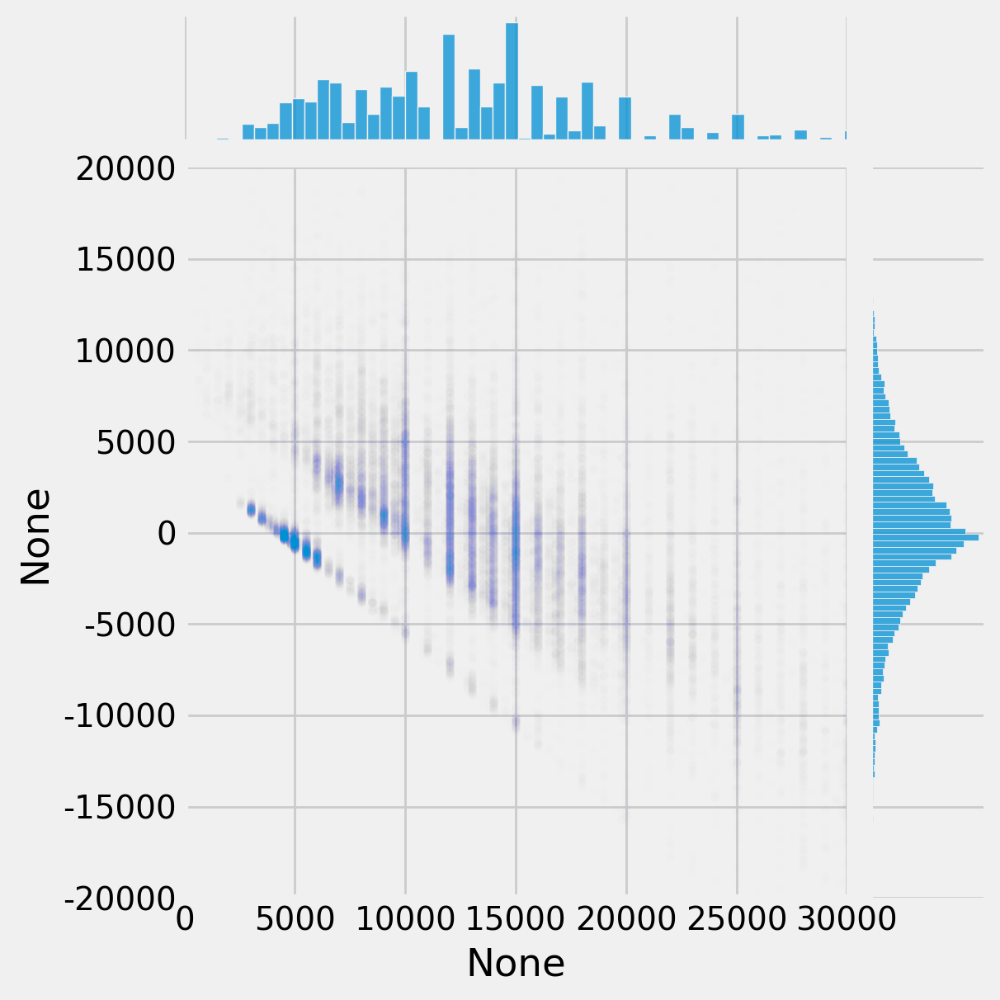

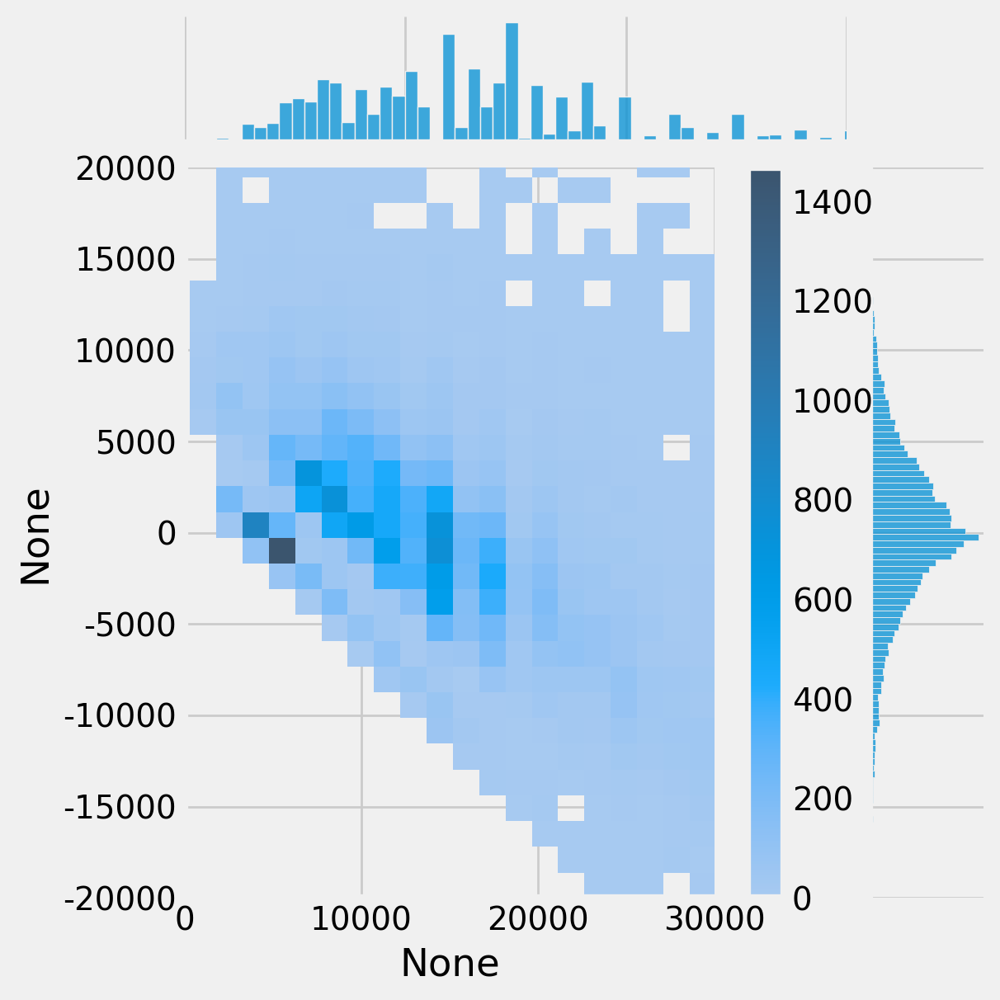

In [ ]:
test_plot_err_dist(best_model,iter_dict['tst'],criterion,device,percent=False,kind='scatter',s=15,alpha=0.002,xlim=(0,30000),ylim=(-20000,20000));
test_plot_err_dist(best_model,iter_dict['tst'],criterion,device,percent=False,kind='hist',bins=20**2,xlim=(0,30000),ylim=(-20000,20000),cbar=True);

other lr

In [ ]:
d_model = 60 #64
head = 6
d_ff = 128
n_layers= 6

In [ ]:
from math import sqrt
display((len(data_dict['trn']['X'])/8192 * 60 * 100*sqrt(6))**(-0.5) * 0.05*1.5)
display((len(data_dict['trn']['X'])/8192 * 60 * 100*(6))**(-0.5) * 0.05*1.5)
display((len(data_dict['trn']['X'])/8192 * 60 * 500*sqrt(6))**(-0.5))

0.00017603964473286235

0.00011247931707602604

0.0010496976329535813

In [ ]:
# model parameter setting
batch_size = 8192

# optimizer parameter setting
init_lr = (443/450)*(248/450)*1.76*1e-4#1.76*1e-3 #9.52*1e-5 #5*1e-3#*3
factor = 0.95
adam_eps = 5e-7
patience = 10
warmup = 3
epoch = 500
clip = 1.0
weight_decay = 5e-20
drop_prob = 0.1

In [ ]:
model = Model4_5(col_start,d_model,head,d_ff,drop_prob,n_layers,device)
model, optimizer, scheduler, criterion =trainer_setting(model,init_lr,weight_decay,adam_eps,factor,patience)

The model has 11,852,587 trainable parameters


/content/drive/MyDrive/kdt-EST-AI/project/project2/module_aladin/torch_train.py:150: FutureWarning: `nn.init.kaiming_uniform` is now deprecated in favor of `nn.init.kaiming_uniform_`.
  nn.init.kaiming_uniform(m.weight.data)
/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(


# train, evaluate

In [ ]:
model_name = 'model4.5'
expt_name = f'{model_name}_{batch_size}_{epoch}_N{n_layers}_lr{init_lr:.5f}'
save_dir = os.path.join(RSLT_DIR,'model',expt_name)
if not os.path.exists(save_dir) : os.makedirs(save_dir)
file_name = 'model_{}.pt'.format(241110)

In [ ]:
iter_dict.keys()

dict_keys(['vld', 'trn', 'tst'])

In [ ]:
train_config =[optimizer, scheduler, criterion, clip]

In [ ]:
model,train_loss,val_loss,train_score,val_score = run(model,train_config,iter_dict['trn'],iter_dict['vld'],epoch,warmup,8500,save_dir,file_name[:-3])
torch.save(model,os.path.join(save_dir,file_name))
save_pkl(save_dir,'train_loss.pkl',train_loss)
save_pkl(save_dir,'valid_loss.pkl',val_loss)
save_pkl(save_dir,'valid_score.pkl',val_score)

Epoch:     1		lr: 0.00009549
	Train Loss: 17959.970	Train Score: -1.678	Val Loss: 17696.344	Val Score: -1.857
Epoch:     2		lr: 0.00009549
	Train Loss: 17744.600	Train Score: -1.616	Val Loss: 17335.618	Val Score: -1.739
Epoch:     3		lr: 0.00009549
	Train Loss: 17304.169	Train Score: -1.490	Val Loss: 16732.072	Val Score: -1.547
Epoch:     4		lr: 0.00009549
	Train Loss: 16647.996	Train Score: -1.307	Val Loss: 15921.501	Val Score: -1.299
Epoch:     5		lr: 0.00009549
	Train Loss: 15811.204	Train Score: -1.083	Val Loss: 14946.071	Val Score: -1.017
Epoch:     6		lr: 0.00009549
	Train Loss: 14832.535	Train Score: -0.835	Val Loss: 13858.000	Val Score: -0.724
Epoch:     7		lr: 0.00009549
	Train Loss: 13760.970	Train Score: -0.581	Val Loss: 12729.781	Val Score: -0.443
Epoch:     8		lr: 0.00009549
	Train Loss: 12679.302	Train Score: -0.344	Val Loss: 11686.346	Val Score: -0.205
Epoch:     9		lr: 0.00009549
	Train Loss: 11719.889	Train Score: -0.148	Val Loss: 10928.299	Val Score: -0.045
Epoch:    

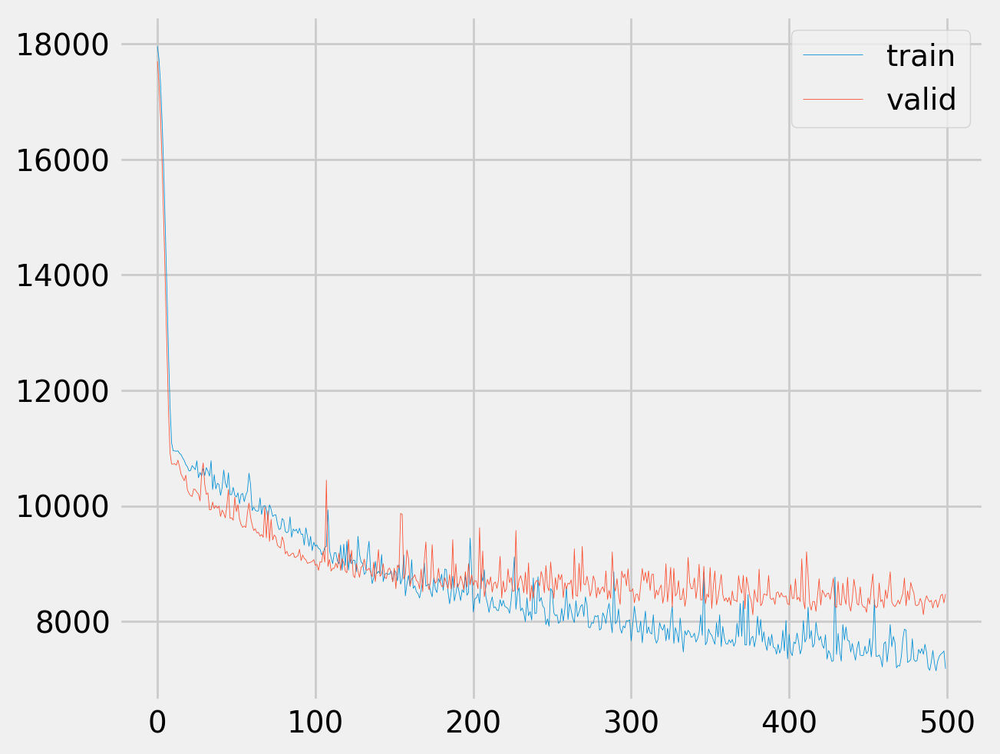

In [ ]:
loss_train = np.array(train_loss)
loss_valid = np.array(val_loss)

fig, ax = plt.subplots()

ax.plot(range(len(loss_train)),loss_train,label='train',lw=0.3)
ax.plot(range(len(loss_valid)),loss_valid,label='valid',lw=0.3)
#ax.set_yscale('log')
ax.legend();

In [ ]:
best_model = torch.load(os.path.join(save_dir,f'best_{file_name}'))

<ipython-input-44-1790dcb0272c>:1: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  best_model = torch.load(os.path.join(save_dir,f'best_{file_name}'))


6852.913417495679 	r2 :  0.6027563810348511 	mape :  0.31916082


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


6852.913417495679 	r2 :  0.6027563810348511 	mape :  0.31916082


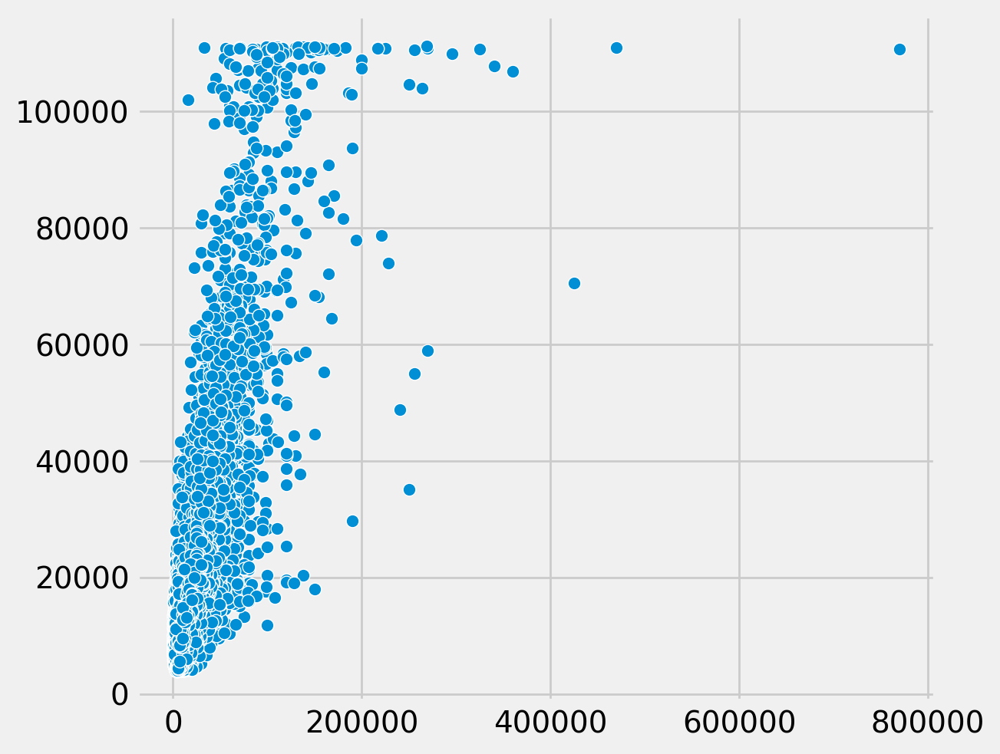

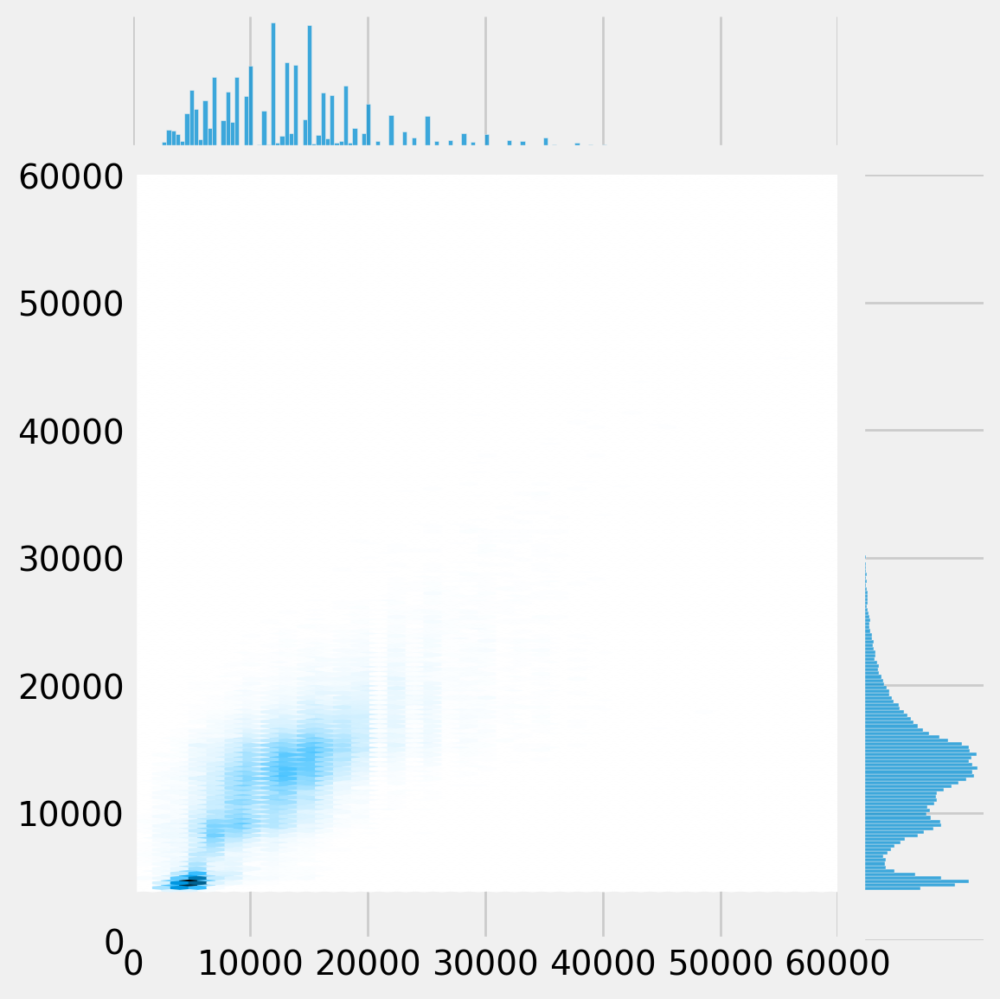

In [ ]:
test_n_plot(best_model,iter_dict['trn'],criterion,device) #gridsize 500
test_n_plot(best_model,iter_dict['trn'],criterion,device,scatter=False,gridsize=500) #gridsize 500

8114.029147100718 	r2 :  0.4784906506538391 	mape :  0.34781906


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


8114.029147100718 	r2 :  0.4784906506538391 	mape :  0.34781906


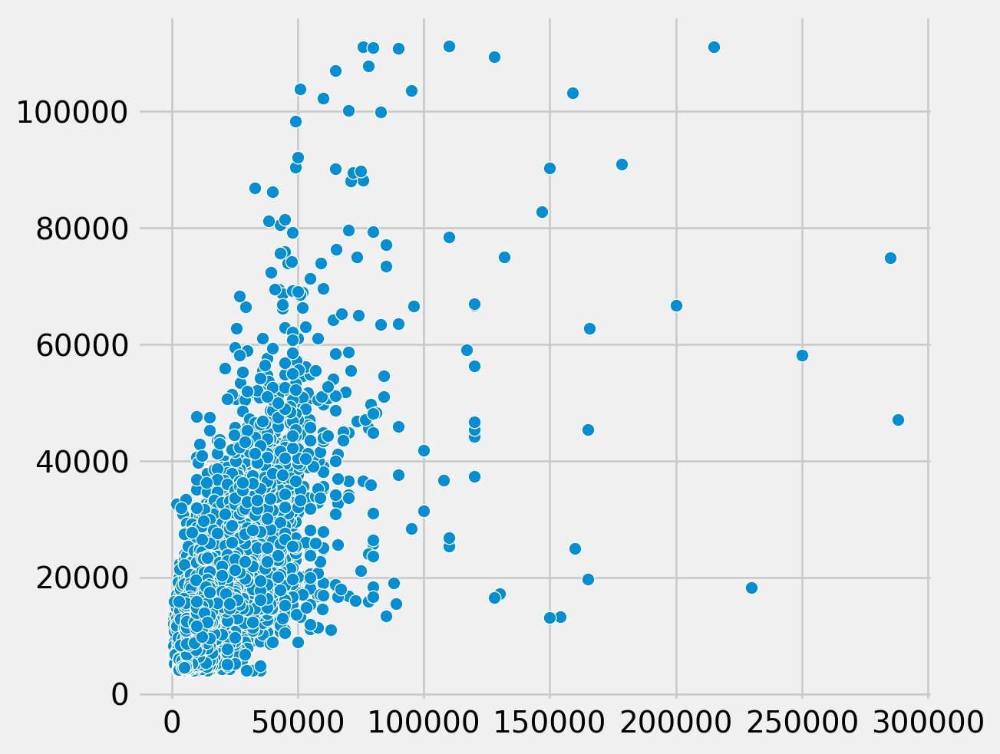

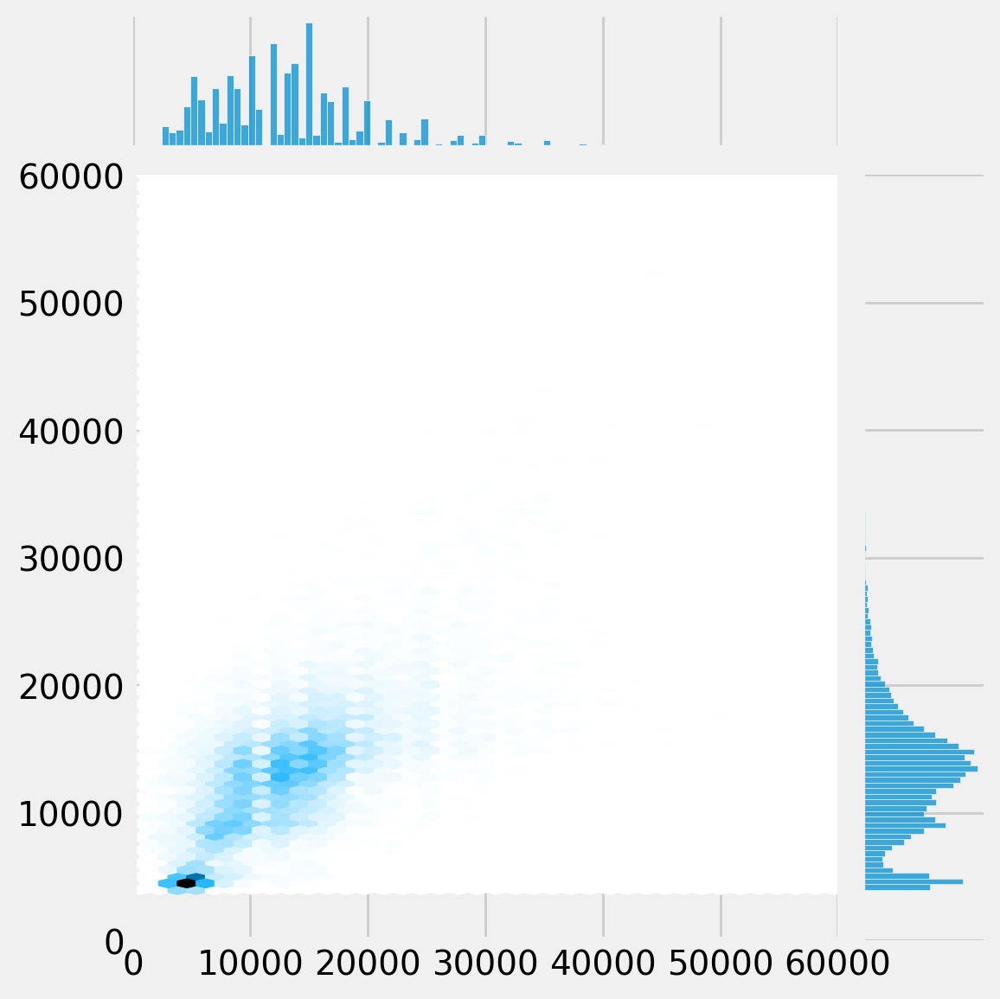

In [ ]:
test_n_plot(best_model,iter_dict['vld'],criterion,device) #gridsize 180
test_n_plot(best_model,iter_dict['vld'],criterion,device,scatter=False,gridsize=180) #gridsize 180

8490.48008065504 	r2 :  0.4568135738372803 	mape :  0.3495899


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


8490.48008065504 	r2 :  0.4568135738372803 	mape :  0.3495899


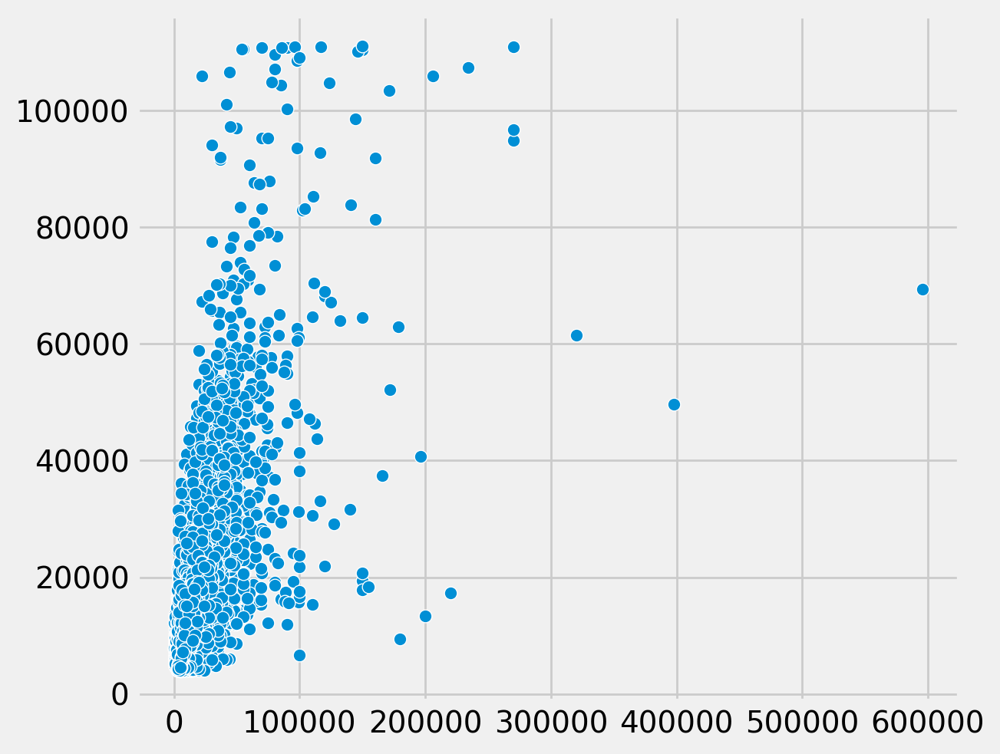

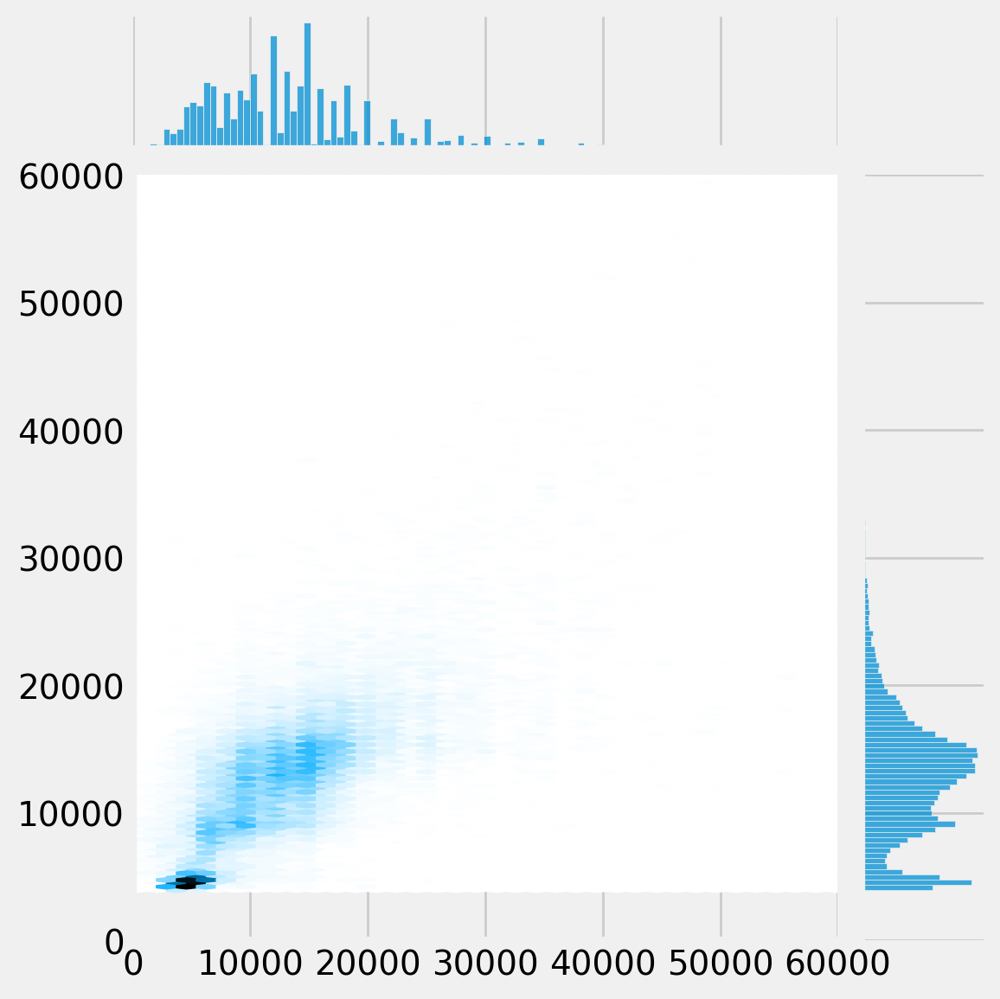

In [ ]:
test_n_plot(best_model,iter_dict['tst'],criterion,device) #gridsize 350
test_n_plot(best_model,iter_dict['tst'],criterion,device,scatter=False,gridsize=350) #gridsize 350

6960.8550535780505 	r2 :  0.5908410549163818 	mape :  0.32434478


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


6960.8550535780505 	r2 :  0.5908410549163818 	mape :  0.32434478


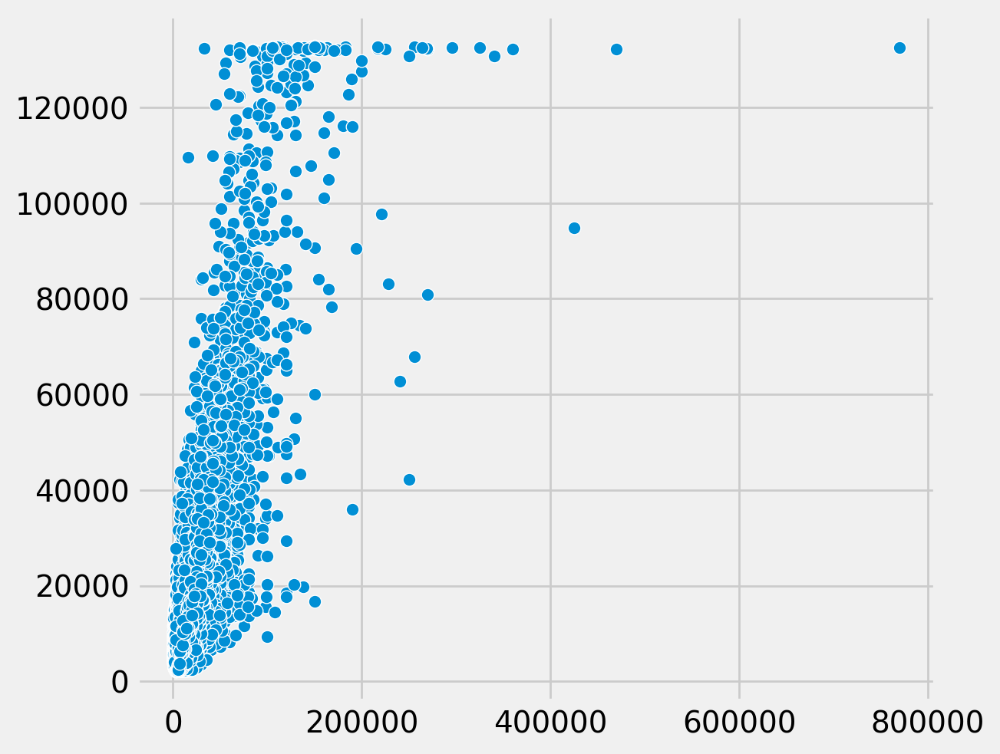

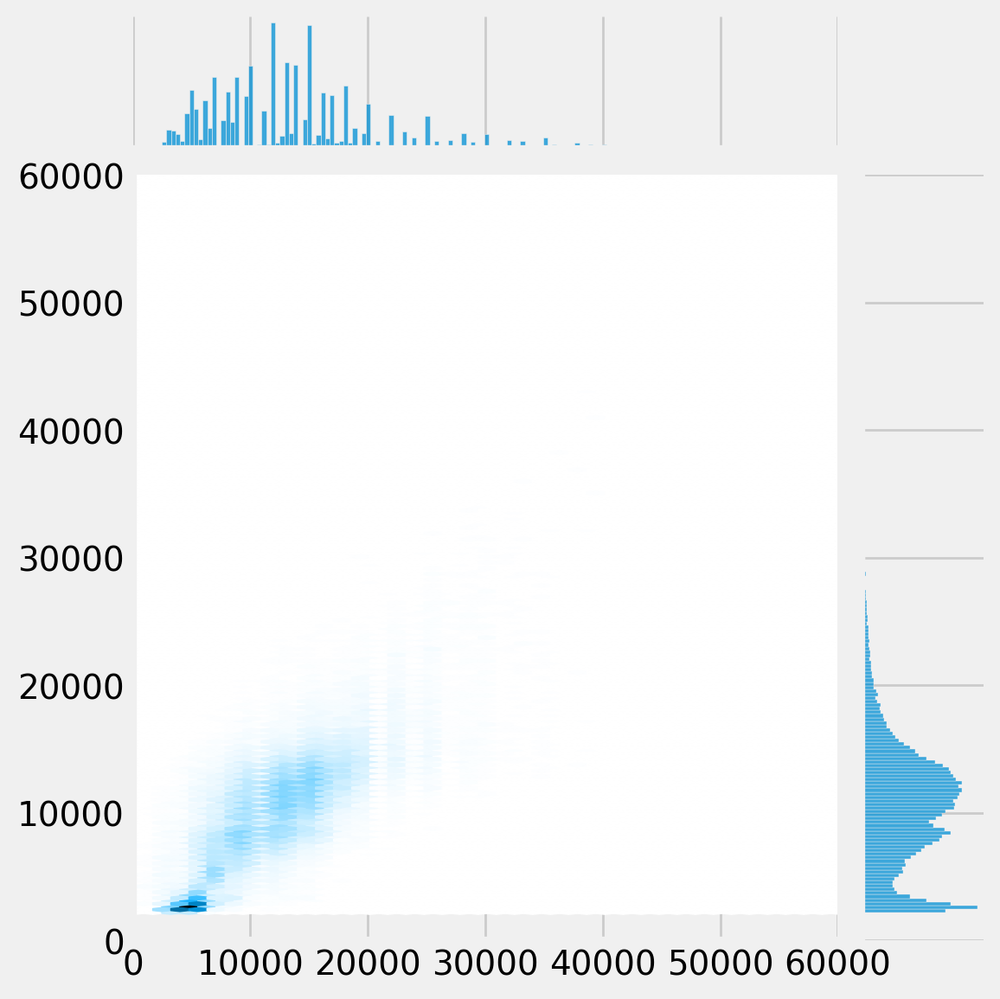

In [ ]:
test_n_plot(model,iter_dict['trn'],criterion,device) #gridsize 500
test_n_plot(model,iter_dict['trn'],criterion,device,scatter=False,gridsize=500) #gridsize 500

8470.957620009676 	r2 :  0.4246751070022583 	mape :  0.35380518


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


8470.957620009676 	r2 :  0.4246751070022583 	mape :  0.35380518


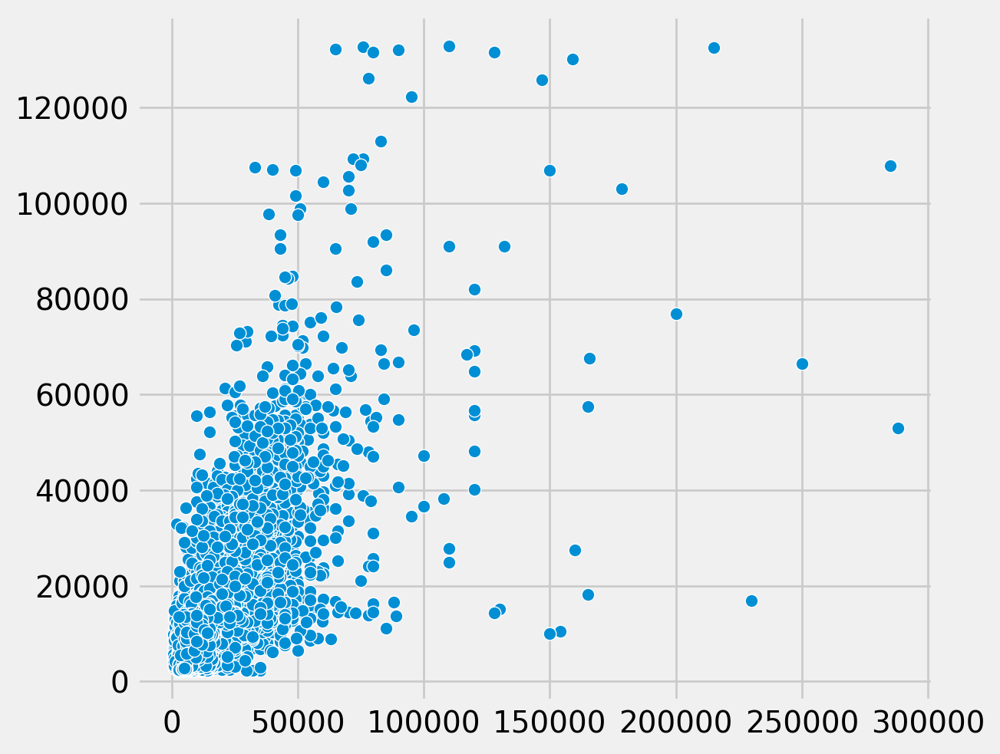

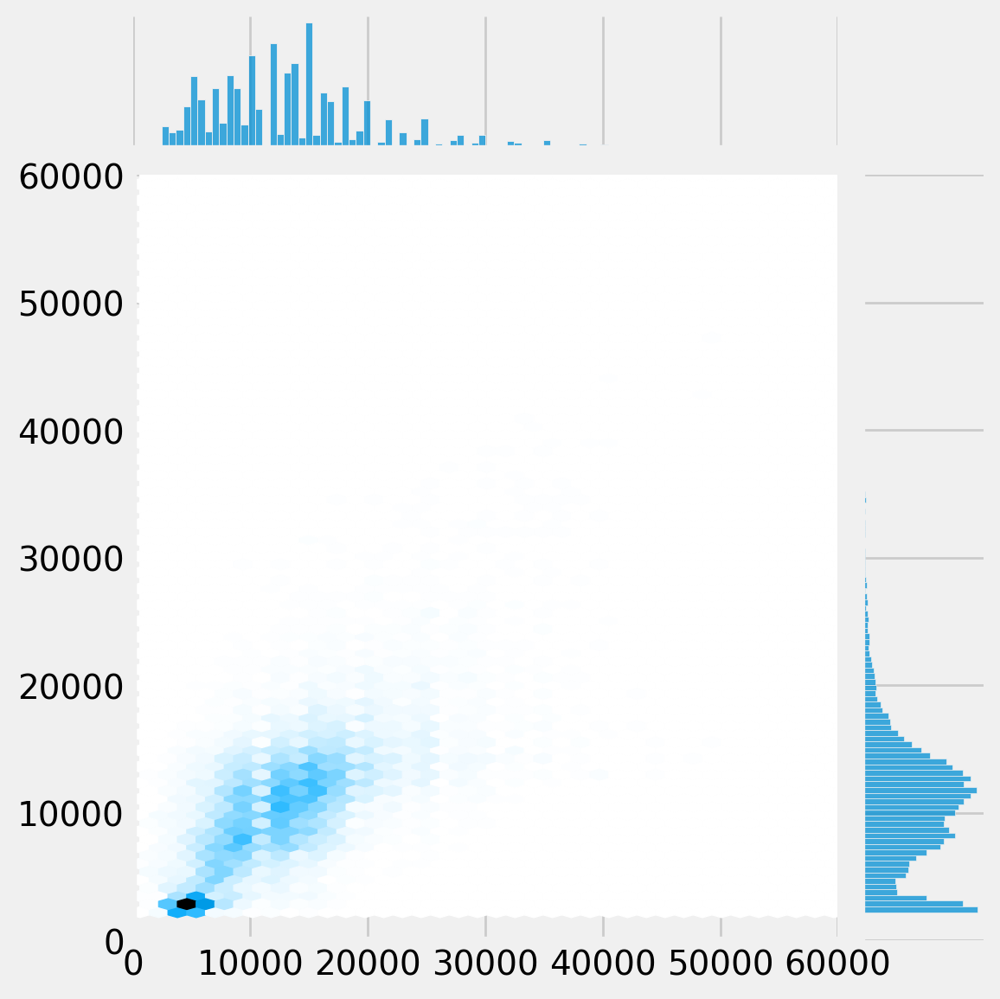

In [ ]:
test_n_plot(model,iter_dict['vld'],criterion,device) #gridsize 180
test_n_plot(model,iter_dict['vld'],criterion,device,scatter=False,gridsize=180)

8838.99230681869 	r2 :  0.41130274534225464 	mape :  0.35493135


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


8838.99230681869 	r2 :  0.41130274534225464 	mape :  0.35493135


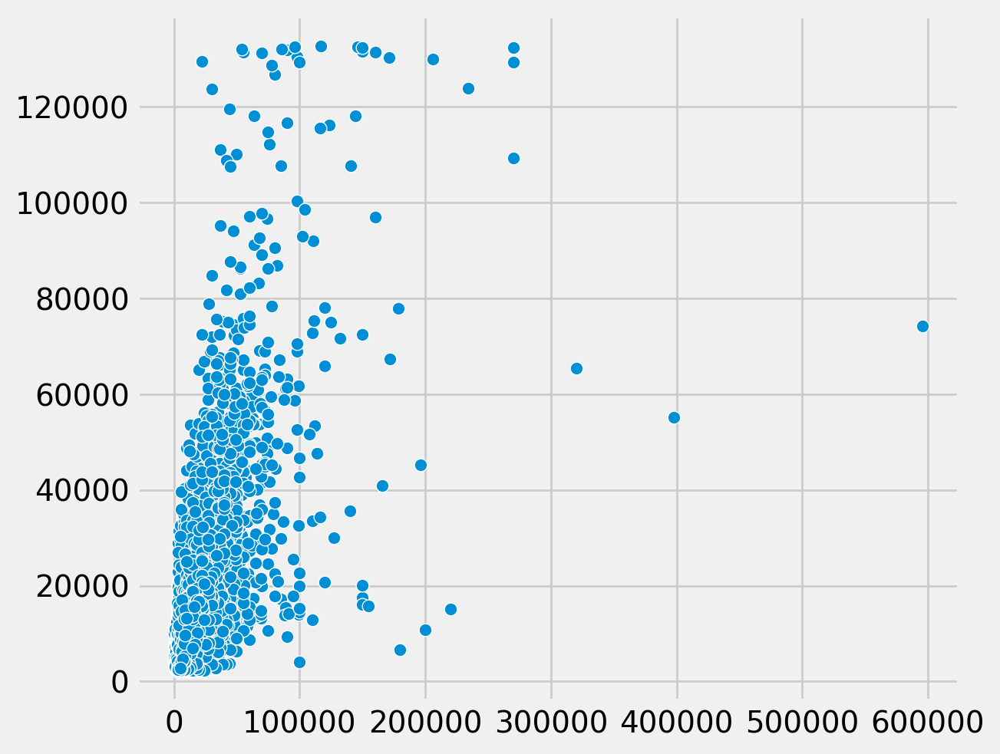

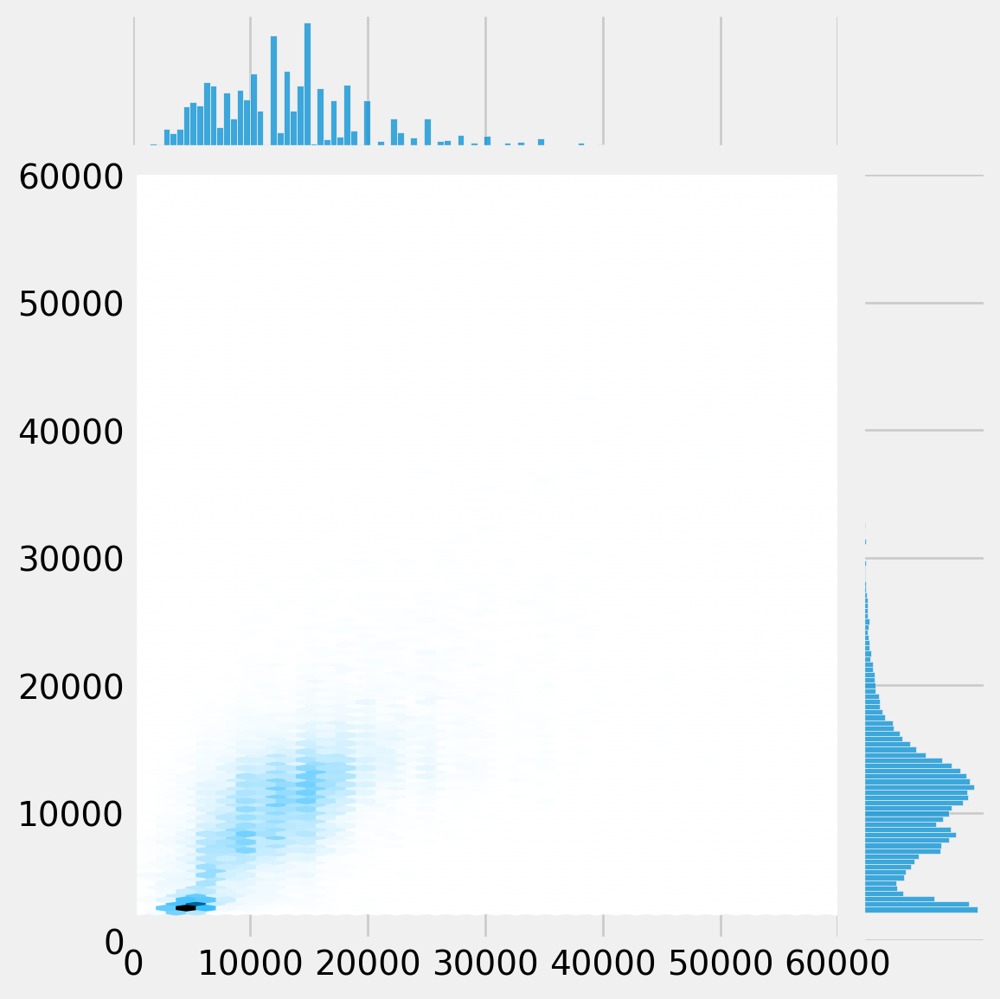

In [ ]:
test_n_plot(model,iter_dict['tst'],criterion,device) #gridsize 350
test_n_plot(model,iter_dict['tst'],criterion,device,scatter=False,gridsize=350) #gridsize 350

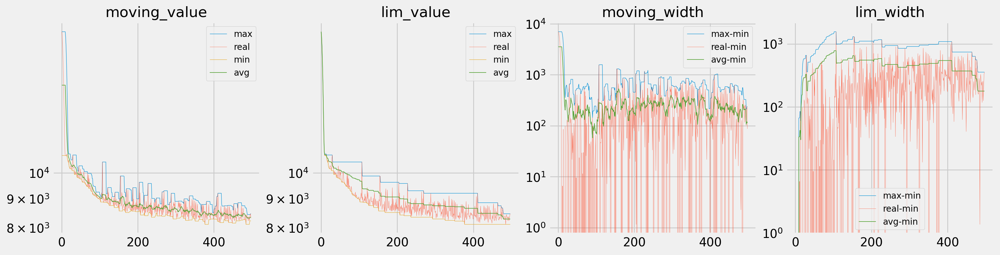

In [ ]:
x = val_loss
plot_area(x,start=0,end=-1);
#plot_area(x,start=750,end=-1,log=False);

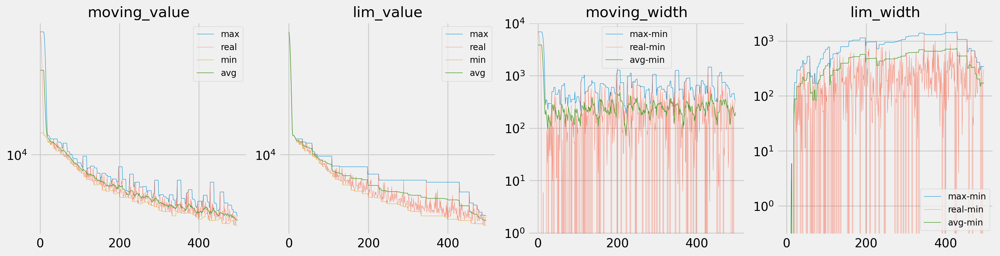

In [ ]:
x = train_loss
plot_area(x,start=0,end=-1);

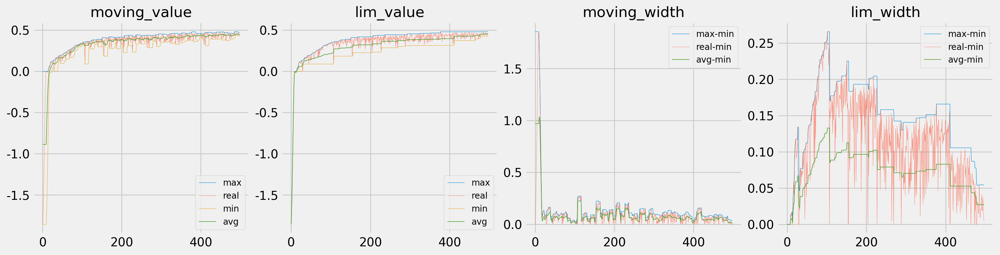

In [ ]:
x = val_score
plot_area(x,False,start=0,end=-1,log=False);

other lr

In [ ]:
d_model = 60 #64
head = 6
d_ff = 128
n_layers= 6

In [ ]:
from math import sqrt
display((len(data_dict['trn']['X'])/8192 * 60 * 100*sqrt(6))**(-0.5) * 0.05*1.5)
display((len(data_dict['trn']['X'])/8192 * 60 * 100*(6))**(-0.5) * 0.05*1.5)
display((len(data_dict['trn']['X'])/8192 * 60 * 500*sqrt(6))**(-0.5))

0.00017603964473286235

0.00011247931707602604

0.0010496976329535813

In [ ]:
# model parameter setting
batch_size = 8192

# optimizer parameter setting
init_lr = (378/450)*(443/450)*(248/450)*1.76*1e-4#1.76*1e-3 #9.52*1e-5 #5*1e-3#*3
factor = 0.95
adam_eps = 5e-7
patience = 10
warmup = 3
epoch = 500
clip = 1.0
weight_decay = 5e-20
drop_prob = 0.1

In [ ]:
model = Model4_5(col_start,d_model,head,d_ff,drop_prob,n_layers,device)
model, optimizer, scheduler, criterion =trainer_setting(model,init_lr,weight_decay,adam_eps,factor,patience)

The model has 11,852,587 trainable parameters


/content/drive/MyDrive/kdt-EST-AI/project/project2/module_aladin/torch_train.py:150: FutureWarning: `nn.init.kaiming_uniform` is now deprecated in favor of `nn.init.kaiming_uniform_`.
  nn.init.kaiming_uniform(m.weight.data)
/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(


# train, evaluate

In [ ]:
model_name = 'model4.5'
expt_name = f'{model_name}_{batch_size}_{epoch}_N{n_layers}_lr{init_lr:.5f}'
save_dir = os.path.join(RSLT_DIR,'model',expt_name)
if not os.path.exists(save_dir) : os.makedirs(save_dir)
file_name = 'model_{}.pt'.format(241110)

In [ ]:
iter_dict.keys()

dict_keys(['vld', 'trn', 'tst'])

In [ ]:
train_config =[optimizer, scheduler, criterion, clip]

In [ ]:
model,train_loss,val_loss,train_score,val_score = run(model,train_config,iter_dict['trn'],iter_dict['vld'],epoch,warmup,8500,save_dir,file_name[:-3])
torch.save(model,os.path.join(save_dir,file_name))
save_pkl(save_dir,'train_loss.pkl',train_loss)
save_pkl(save_dir,'valid_loss.pkl',val_loss)
save_pkl(save_dir,'valid_score.pkl',val_score)

Epoch:     1		lr: 0.00008021
	Train Loss: 17967.276	Train Score: -1.680	Val Loss: 17725.566	Val Score: -1.867
Epoch:     2		lr: 0.00008021
	Train Loss: 17814.316	Train Score: -1.636	Val Loss: 17477.859	Val Score: -1.785
Epoch:     3		lr: 0.00008021
	Train Loss: 17518.100	Train Score: -1.550	Val Loss: 17072.188	Val Score: -1.654
Epoch:     4		lr: 0.00008021
	Train Loss: 17081.992	Train Score: -1.426	Val Loss: 16529.498	Val Score: -1.484
Epoch:     5		lr: 0.00008021
	Train Loss: 16522.938	Train Score: -1.272	Val Loss: 15868.260	Val Score: -1.283
Epoch:     6		lr: 0.00008021
	Train Loss: 15855.615	Train Score: -1.093	Val Loss: 15105.383	Val Score: -1.062
Epoch:     7		lr: 0.00008021
	Train Loss: 15093.879	Train Score: -0.898	Val Loss: 14259.269	Val Score: -0.829
Epoch:     8		lr: 0.00008021
	Train Loss: 14261.235	Train Score: -0.696	Val Loss: 13364.921	Val Score: -0.598
Epoch:     9		lr: 0.00008021
	Train Loss: 13389.639	Train Score: -0.497	Val Loss: 12472.219	Val Score: -0.383
Epoch:    

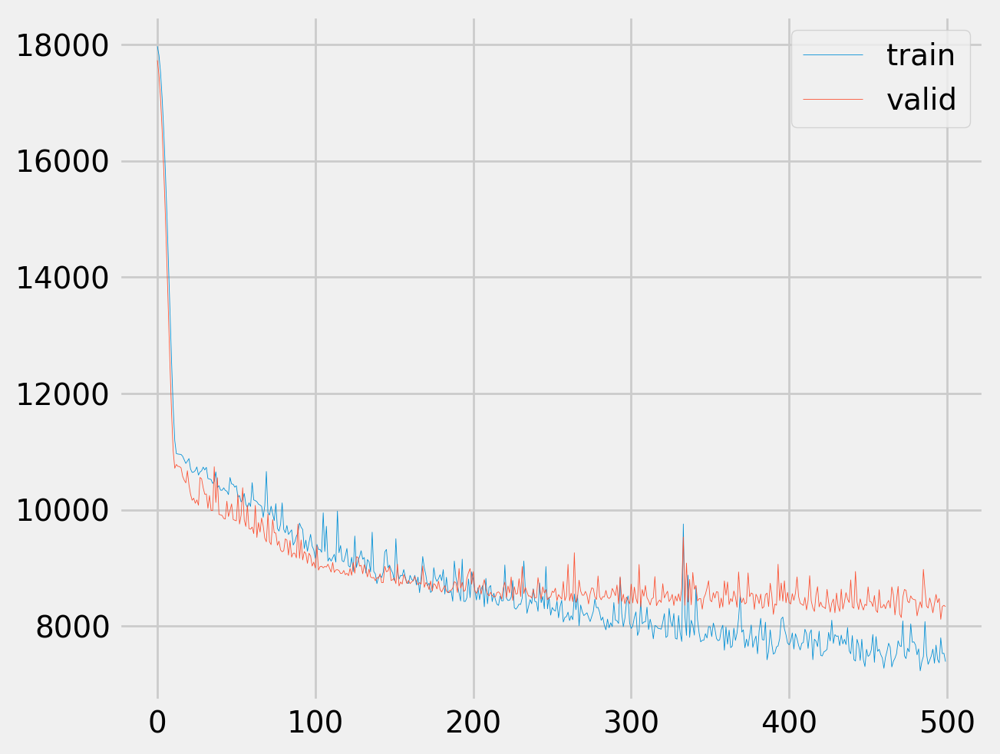

In [ ]:
loss_train = np.array(train_loss)
loss_valid = np.array(val_loss)

fig, ax = plt.subplots()

ax.plot(range(len(loss_train)),loss_train,label='train',lw=0.3)
ax.plot(range(len(loss_valid)),loss_valid,label='valid',lw=0.3)
#ax.set_yscale('log')
ax.legend();

In [ ]:
os.listdir(save_dir)

['best_model_241110.pt',
 'model_241110.pt',
 'train_loss.pkl',
 'valid_loss.pkl',
 'valid_score.pkl']

In [ ]:
best_model = torch.load(os.path.join(save_dir,f'best_{file_name}'))
model = torch.load(os.path.join(save_dir,file_name))

<ipython-input-144-13cdeefa0288>:1: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  best_model = torch.load(os.path.join(save_dir,f'best_{file_name}'))
<ipython-input-144-13cd

6708.71302572546 	r2 :  0.6219034194946289 	mape :  0.3224947


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


6708.71302572546 	r2 :  0.6219034194946289 	mape :  0.3224947


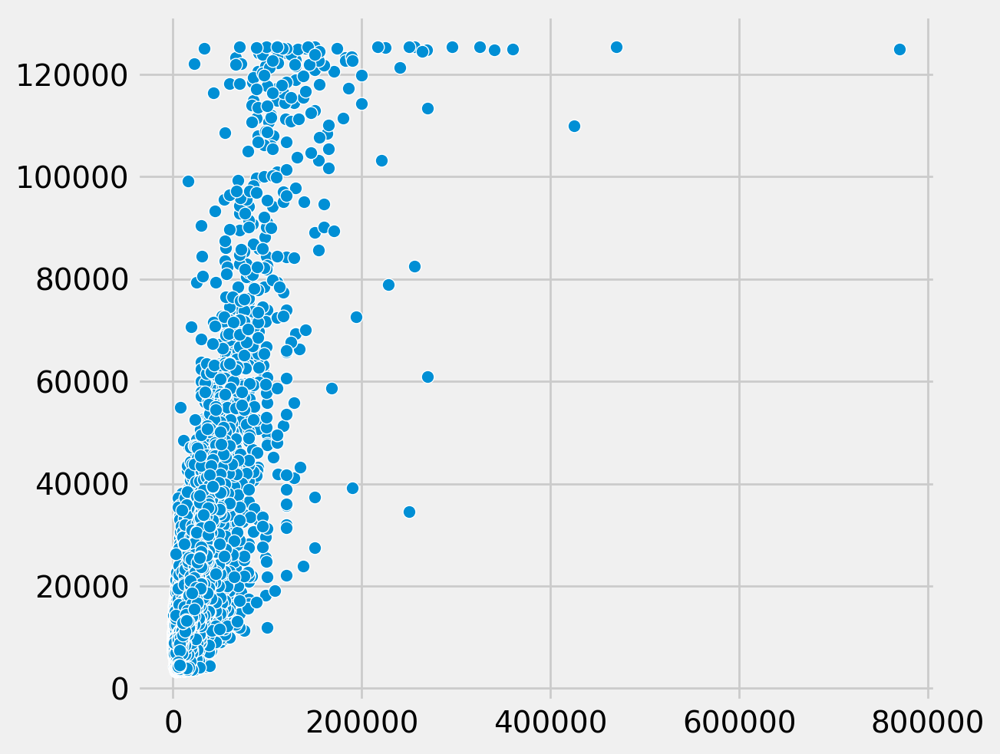

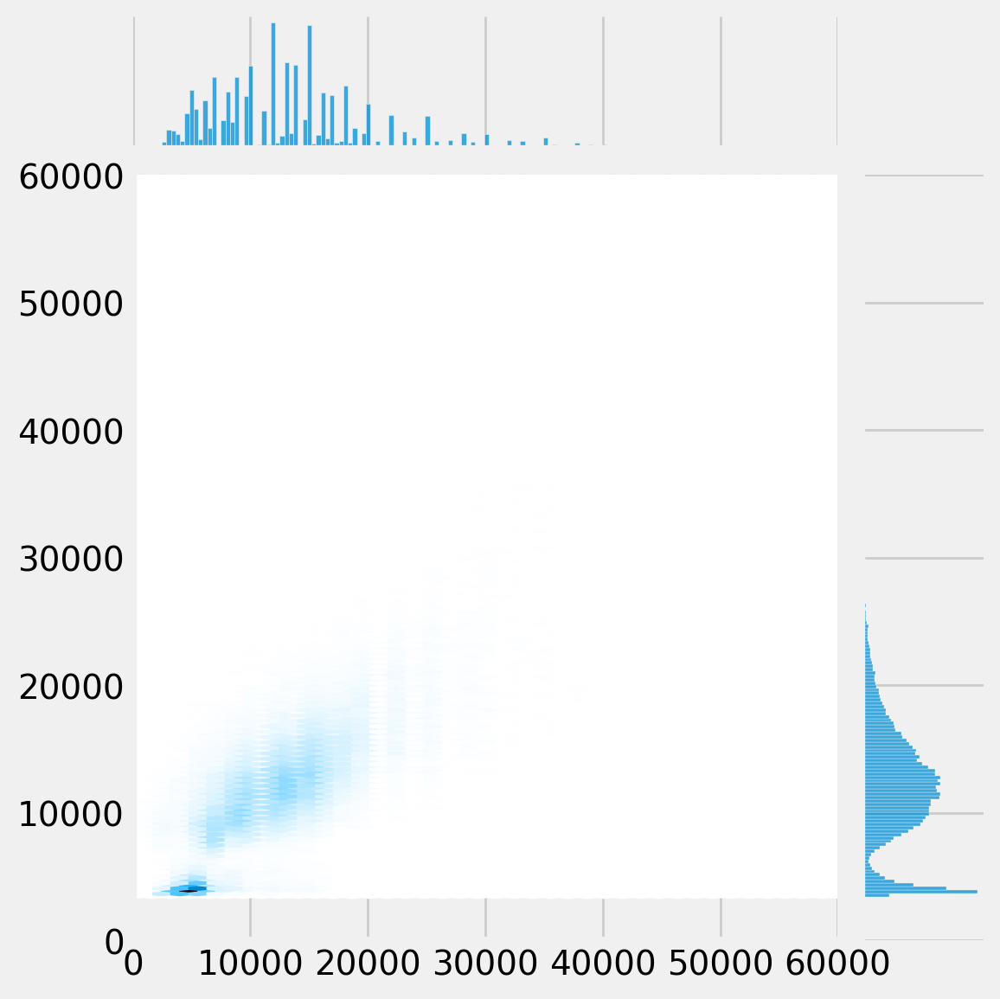

In [ ]:
test_n_plot(best_model,iter_dict['trn'],criterion,device) #gridsize 500
test_n_plot(best_model,iter_dict['trn'],criterion,device,scatter=False,gridsize=500) #gridsize 500

8116.169909507809 	r2 :  0.48272043466567993 	mape :  0.3505594


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


8116.169909507809 	r2 :  0.48272043466567993 	mape :  0.3505594


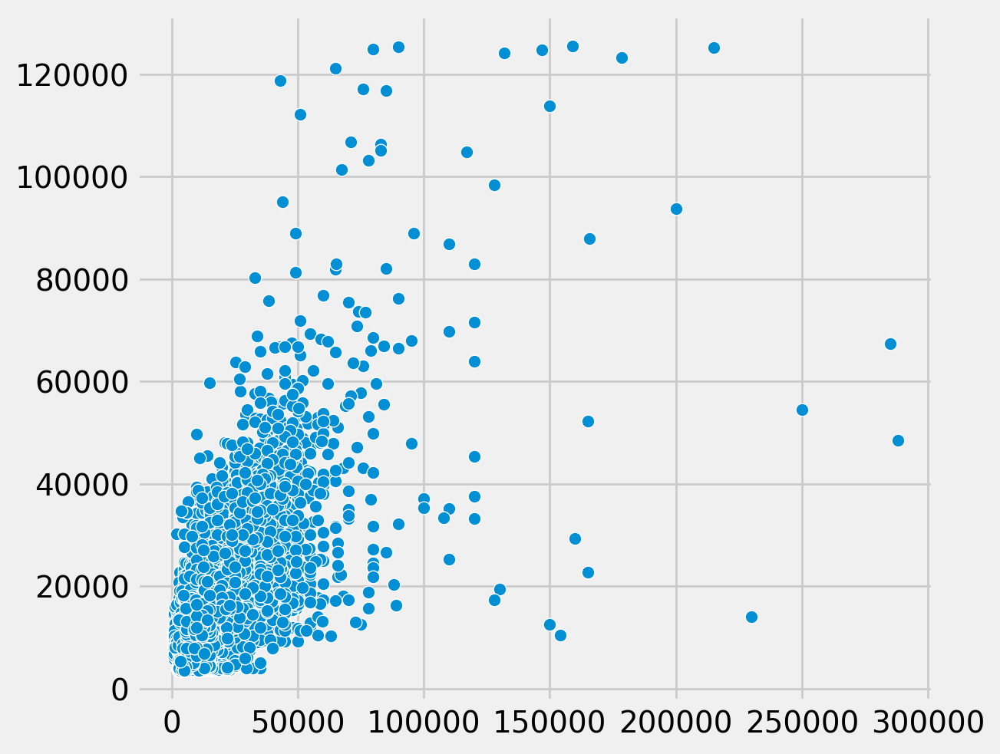

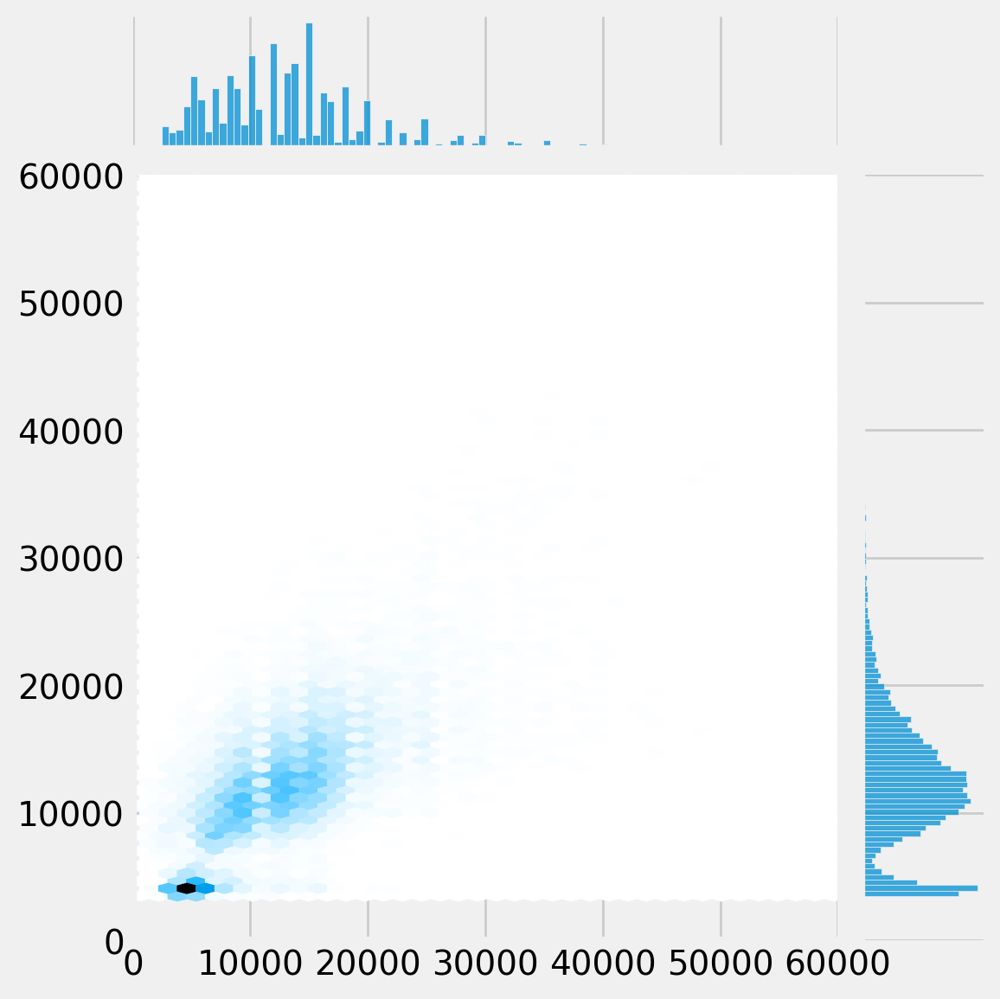

In [ ]:
test_n_plot(best_model,iter_dict['vld'],criterion,device) #gridsize 180
test_n_plot(best_model,iter_dict['vld'],criterion,device,scatter=False,gridsize=180) #gridsize 180

8465.909165588773 	r2 :  0.4596795439720154 	mape :  0.35489988


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


8465.909165588773 	r2 :  0.4596795439720154 	mape :  0.35489988


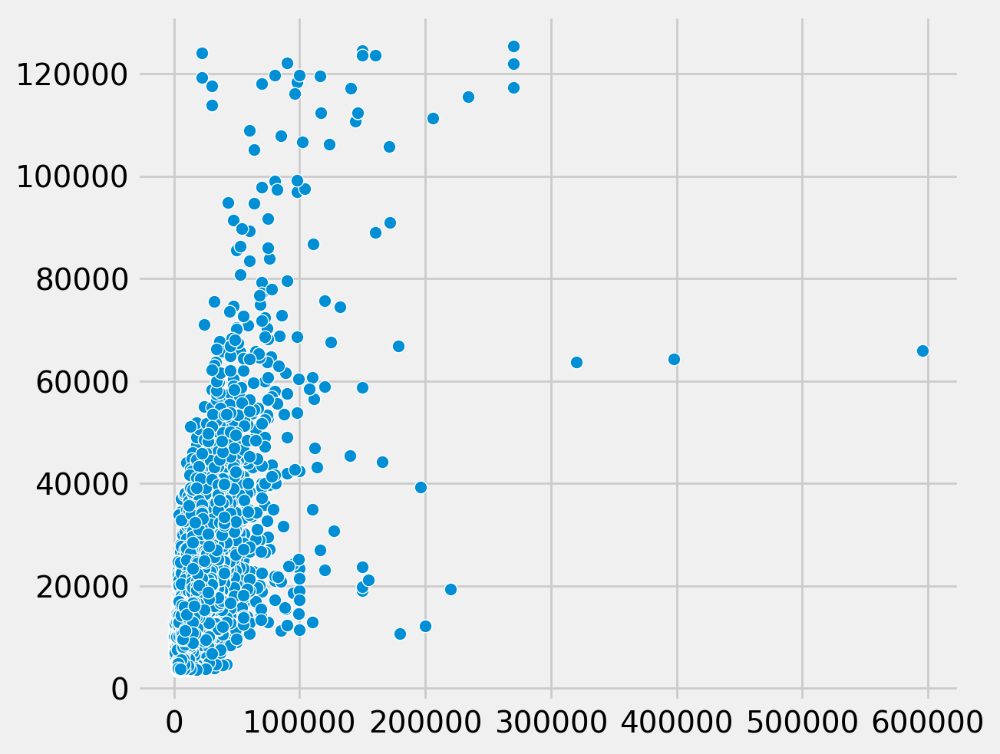

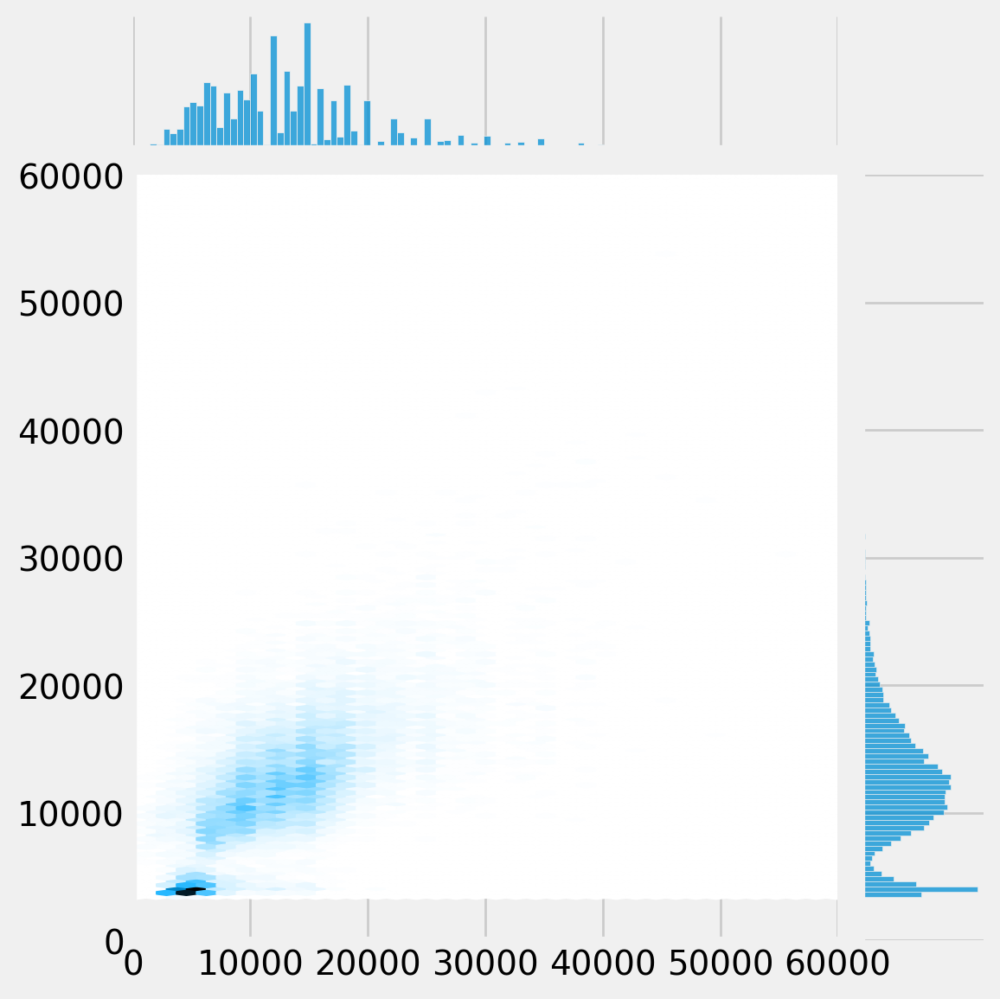

In [ ]:
test_n_plot(best_model,iter_dict['tst'],criterion,device) #gridsize 350
test_n_plot(best_model,iter_dict['tst'],criterion,device,scatter=False,gridsize=350) #gridsize 350

6770.928228605224 	r2 :  0.6152123212814331 	mape :  0.34604093


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


6770.928228605224 	r2 :  0.6152123212814331 	mape :  0.34604093


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


0.0 	r2 :  1.0 	mape :  0.0


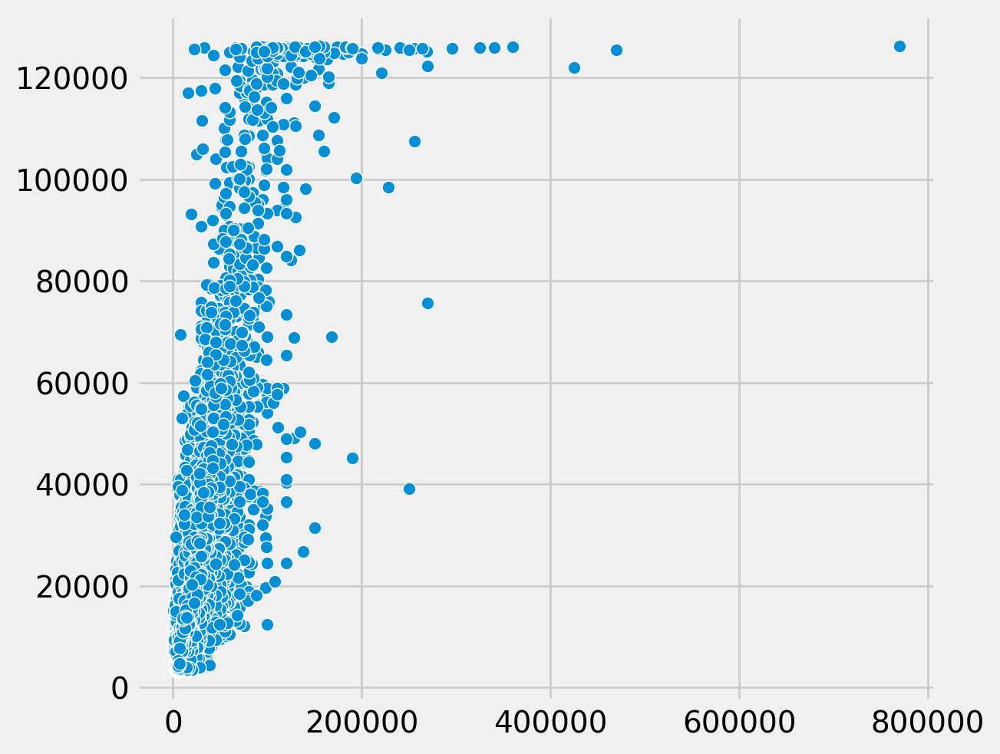

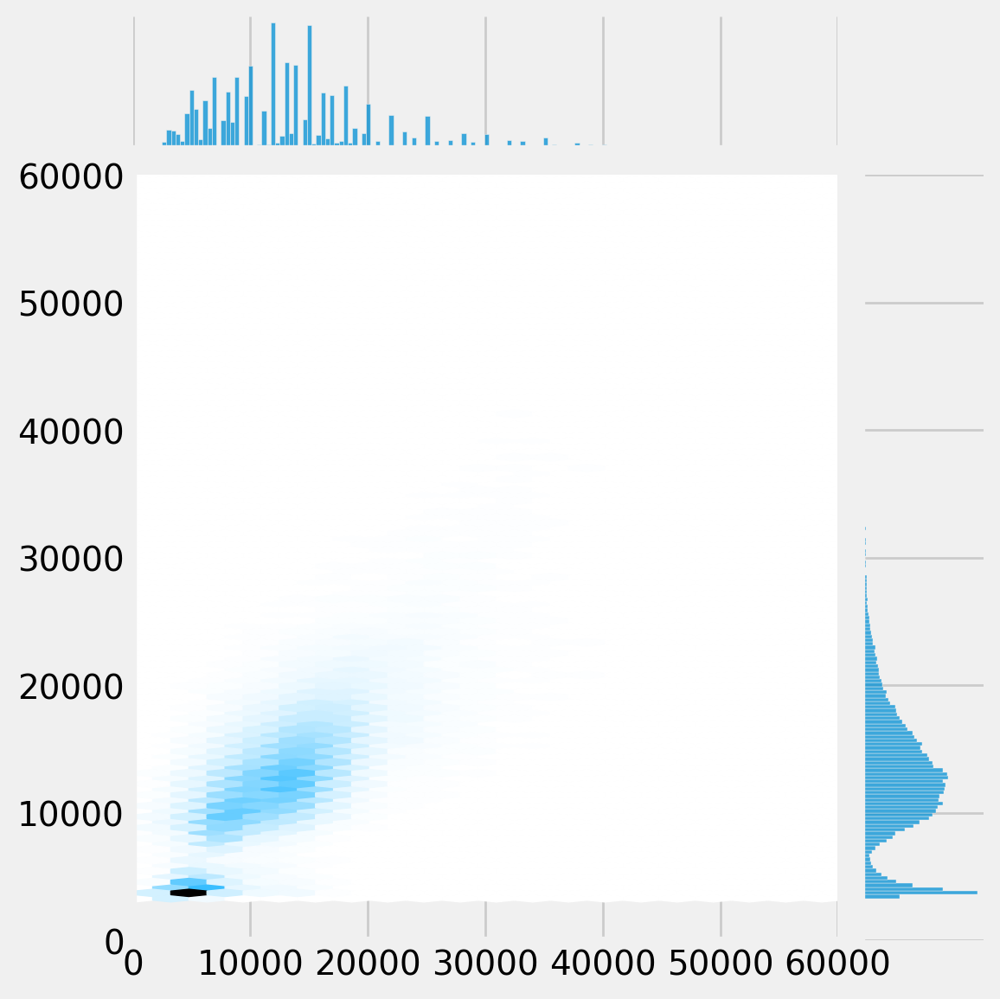

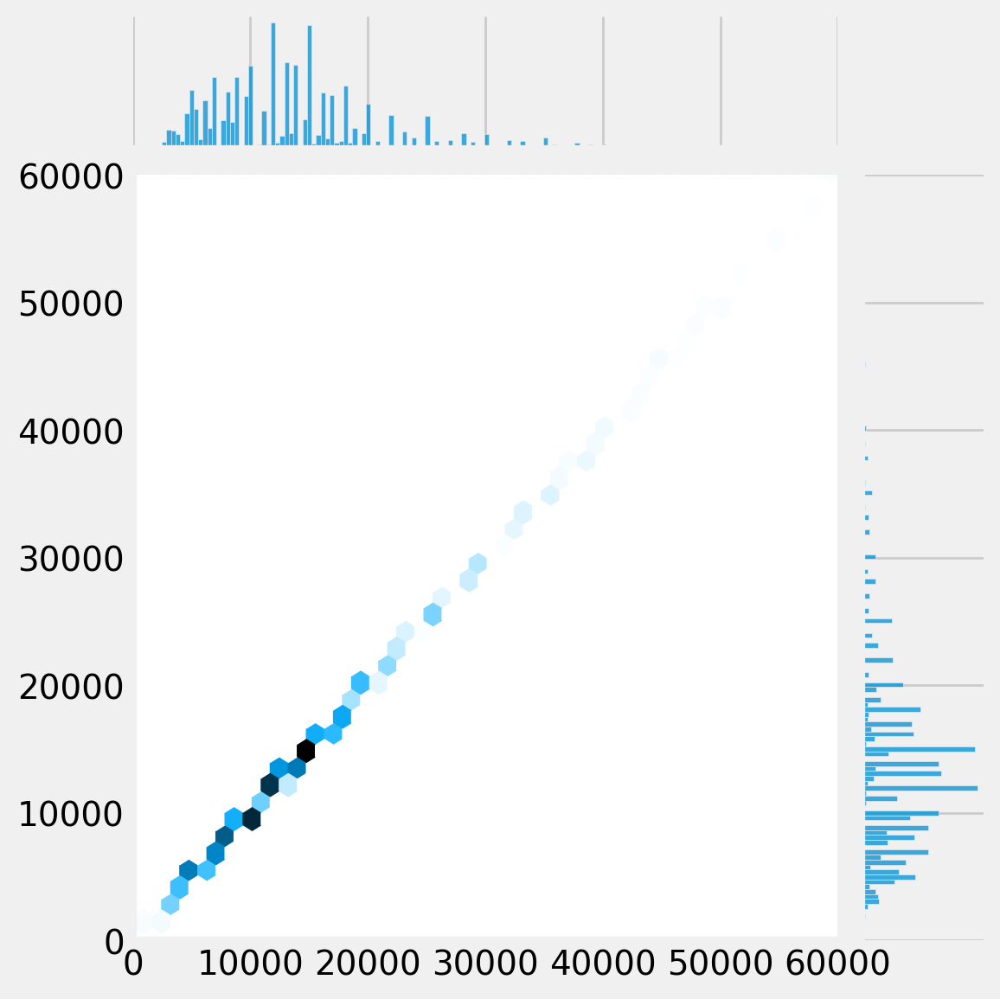

In [ ]:
test_n_plot(model,iter_dict['trn'],criterion,device) #gridsize 500
test_n_plot(model,iter_dict['trn'],criterion,device,scatter=False,gridsize=250) #gridsize 500
test_n_plot(answer_trn,iter_dict['trn'],criterion,device,scatter=False,gridsize=500) #gridsize 500
#https://stackoverflow.com/questions/29096632/getting-colorbar-in-a-hex-jointplot
#https://stackoverflow.com/questions/60845764/how-to-add-a-colorbar-to-the-side-of-a-kde-jointplot

8334.290611683757 	r2 :  0.4540553689002991 	mape :  0.38088948


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


8334.290611683757 	r2 :  0.4540553689002991 	mape :  0.38088948


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


0.0 	r2 :  1.0 	mape :  0.0


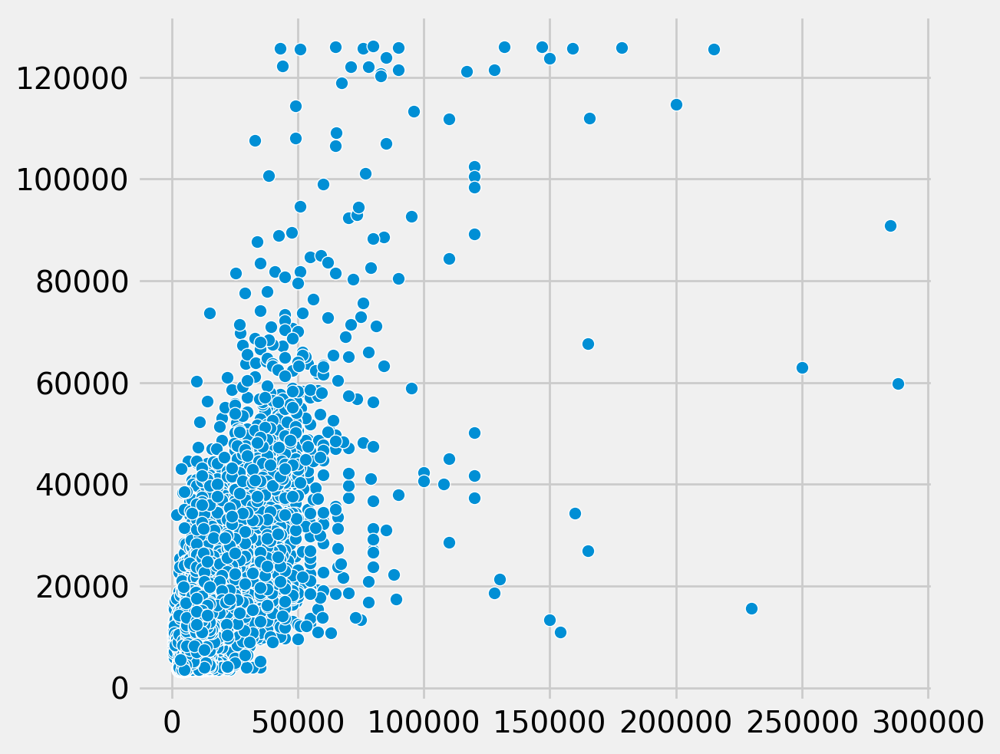

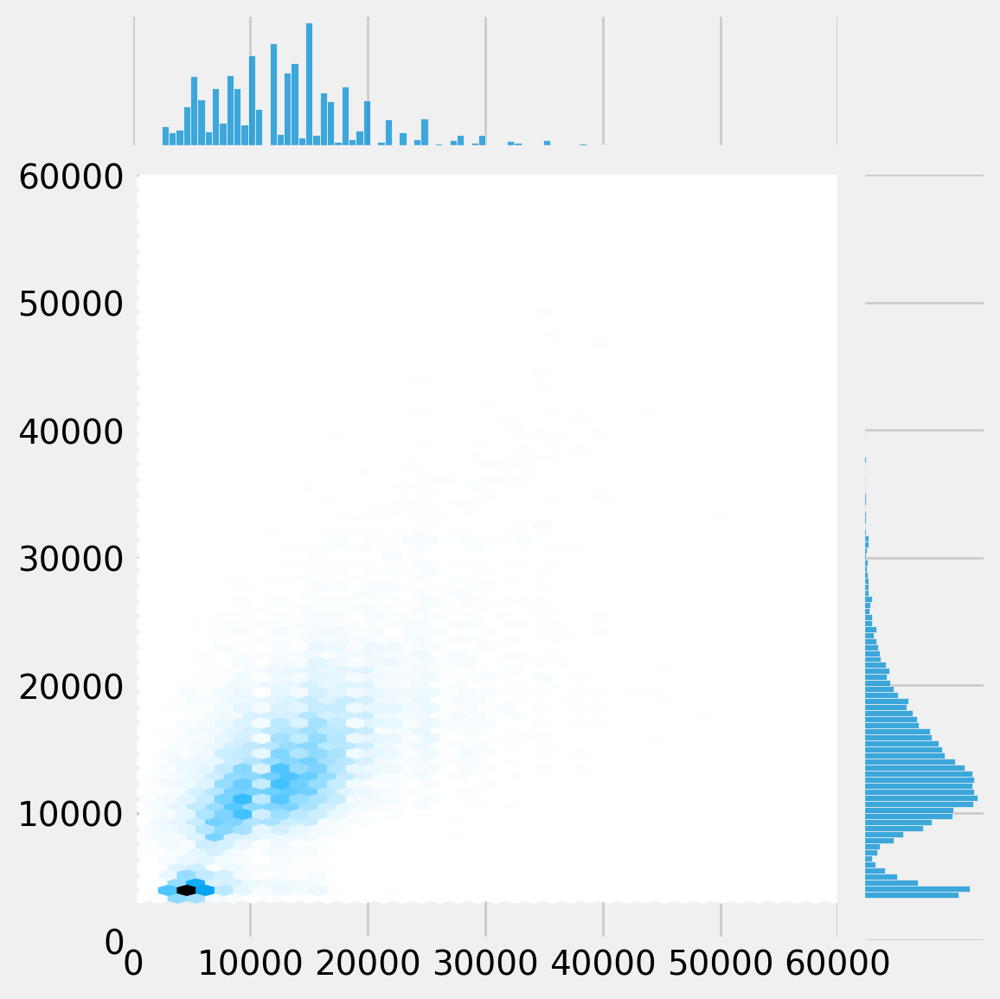

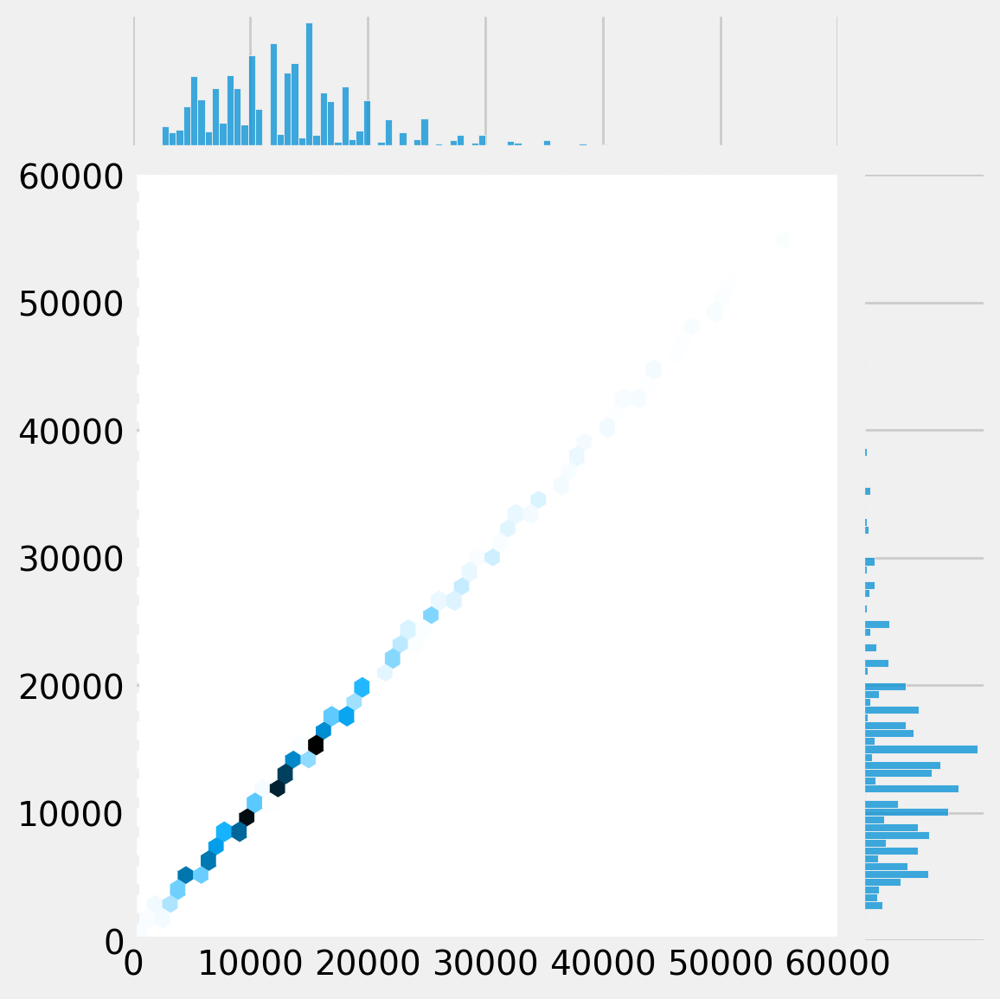

In [ ]:
test_n_plot(model,iter_dict['vld'],criterion,device) #gridsize 180
test_n_plot(model,iter_dict['vld'],criterion,device,scatter=False,gridsize=180)
test_n_plot(answer_vld,iter_dict['vld'],criterion,device,scatter=False,gridsize=220)

8602.280453461164 	r2 :  0.44127368927001953 	mape :  0.38540113


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


8602.280453461164 	r2 :  0.44127368927001953 	mape :  0.38540113


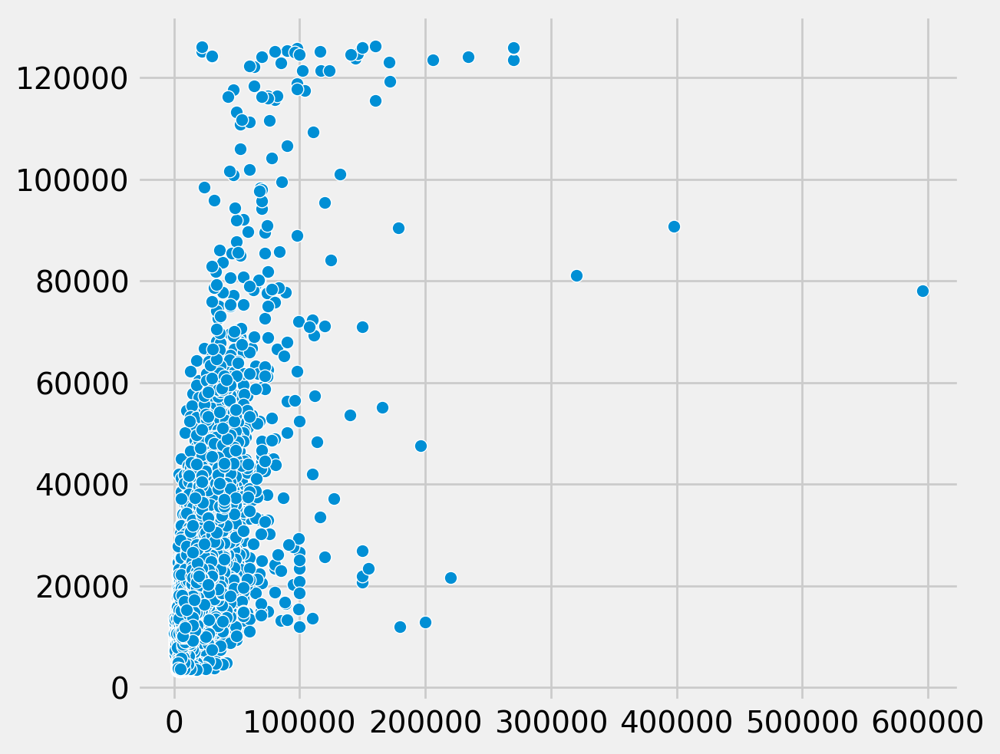

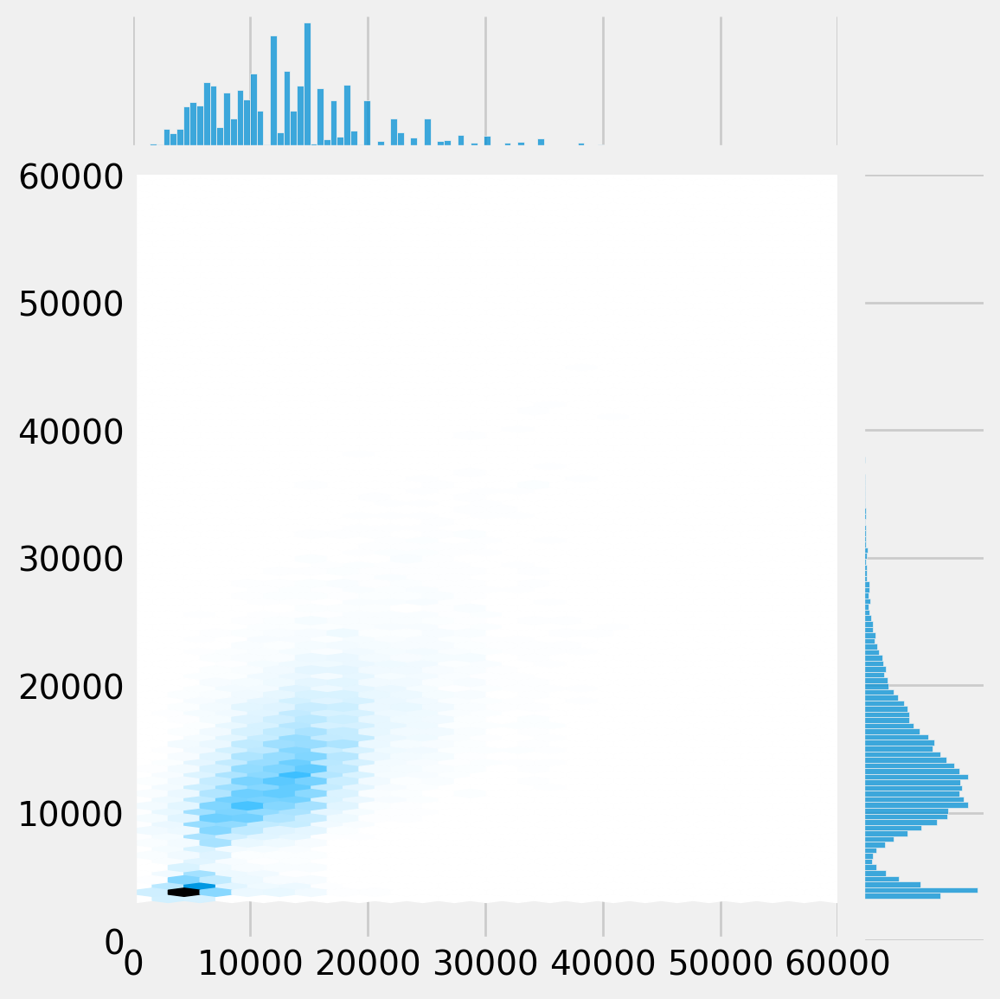

In [ ]:
test_n_plot(model,iter_dict['tst'],criterion,device) #gridsize 350
test_n_plot(model,iter_dict['tst'],criterion,device,scatter=False,gridsize=220) #gridsize 350

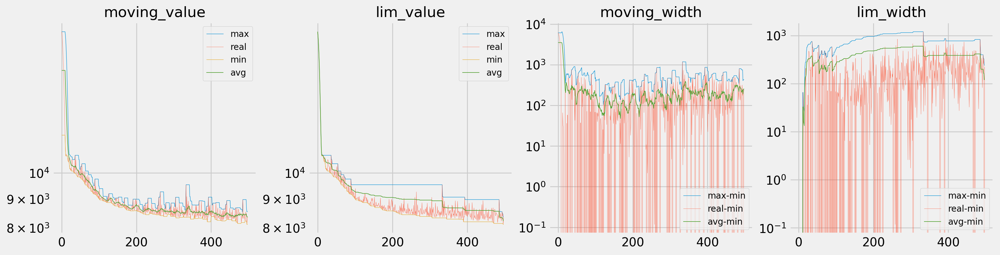

In [ ]:
x = val_loss
plot_area(x,start=0,end=-1);
#plot_area(x,start=750,end=-1,log=False);

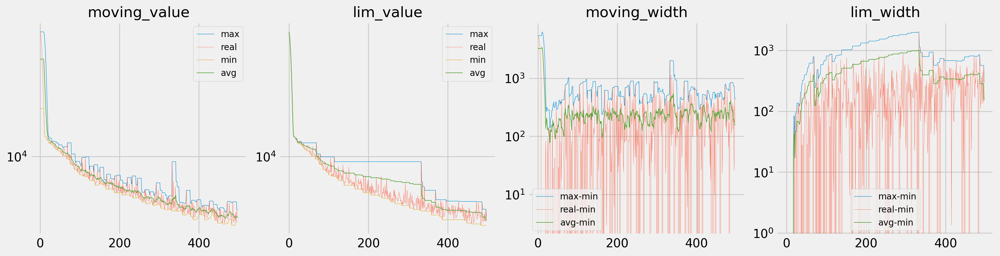

In [ ]:
x = train_loss
plot_area(x,start=0,end=-1);

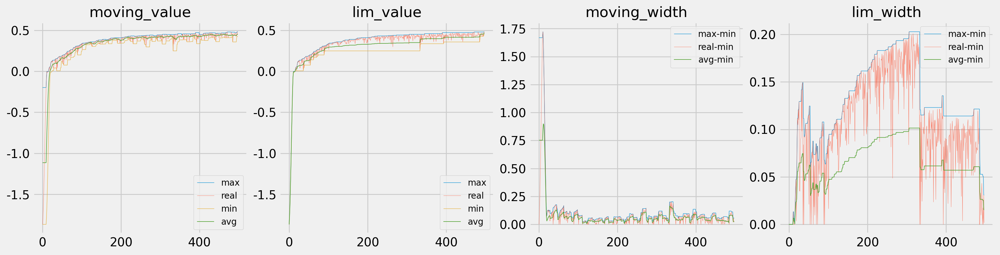

In [ ]:
x = val_score
plot_area(x,False,start=0,end=-1,log=False);

other lr

In [ ]:
d_model = 60 #64
head = 6
d_ff = 128
n_layers= 6

In [ ]:
from math import sqrt
display((len(data_dict['trn']['X'])/8192 * 60 * 100*sqrt(6))**(-0.5) * 0.05*1.5)
display((len(data_dict['trn']['X'])/8192 * 60 * 100*(6))**(-0.5) * 0.05*1.5)
display((len(data_dict['trn']['X'])/8192 * 60 * 500*sqrt(6))**(-0.5))

0.00017603964473286235

0.00011247931707602604

0.0010496976329535813

In [ ]:
# model parameter setting
batch_size = 8192

# optimizer parameter setting
init_lr = (497/450)* (378/450)*(443/450)*(248/450)*1.76*1e-4#1.76*1e-3 #9.52*1e-5 #5*1e-3#*3
factor = 0.95
adam_eps = 5e-7
patience = 10
warmup = 3
epoch = 500
clip = 1.0
weight_decay = 5e-20
drop_prob = 0.1

In [ ]:
model = Model4_5(col_start,d_model,head,d_ff,drop_prob,n_layers,device)
model, optimizer, scheduler, criterion =trainer_setting(model,init_lr,weight_decay,adam_eps,factor,patience)

The model has 11,852,587 trainable parameters


/content/drive/MyDrive/kdt-EST-AI/project/project2/module_aladin/torch_train.py:151: FutureWarning: `nn.init.kaiming_uniform` is now deprecated in favor of `nn.init.kaiming_uniform_`.
  nn.init.kaiming_uniform(m.weight.data)
/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(


# train, evaluate

In [ ]:
model_name = 'model4.5'
expt_name = f'{model_name}_{batch_size}_{epoch}_N{n_layers}_lr{init_lr:.6f}'
save_dir = os.path.join(RSLT_DIR,'model',expt_name)
if not os.path.exists(save_dir) : os.makedirs(save_dir)
file_name = 'model_{}.pt'.format(241115)

In [ ]:
iter_dict.keys()

dict_keys(['vld', 'trn', 'tst'])

In [ ]:
train_config =[optimizer, scheduler, criterion, clip]

In [ ]:
model,train_loss,val_loss,train_score,val_score,best_epoch = run(model,train_config,iter_dict['trn'],iter_dict['vld'],epoch,warmup,8500,save_dir,file_name[:-3])
torch.save(model,os.path.join(save_dir,file_name))
save_pkl(save_dir,'train_loss.pkl',train_loss)
save_pkl(save_dir,'valid_loss.pkl',val_loss)
save_pkl(save_dir,'valid_score.pkl',val_score)

Epoch:     1		lr: 0.00008859
	Train Loss: 17959.517	Train Score: -1.678	Val Loss: 17700.619	Val Score: -1.859
Epoch:     2		lr: 0.00008859
	Train Loss: 17762.216	Train Score: -1.621	Val Loss: 17377.978	Val Score: -1.753
Epoch:     3		lr: 0.00008859
	Train Loss: 17372.026	Train Score: -1.509	Val Loss: 16852.167	Val Score: -1.584
Epoch:     4		lr: 0.00008859
	Train Loss: 16797.352	Train Score: -1.348	Val Loss: 16145.919	Val Score: -1.366
Epoch:     5		lr: 0.00008859
	Train Loss: 16065.399	Train Score: -1.149	Val Loss: 15292.412	Val Score: -1.115
Epoch:     6		lr: 0.00008859
	Train Loss: 15201.654	Train Score: -0.926	Val Loss: 14325.709	Val Score: -0.847
Epoch:     7		lr: 0.00008859
	Train Loss: 14241.960	Train Score: -0.692	Val Loss: 13295.258	Val Score: -0.581
Epoch:     8		lr: 0.00008859
	Train Loss: 13237.385	Train Score: -0.464	Val Loss: 12275.117	Val Score: -0.337
Epoch:     9		lr: 0.00008859
	Train Loss: 12267.772	Train Score: -0.258	Val Loss: 11385.913	Val Score: -0.140
Epoch:    

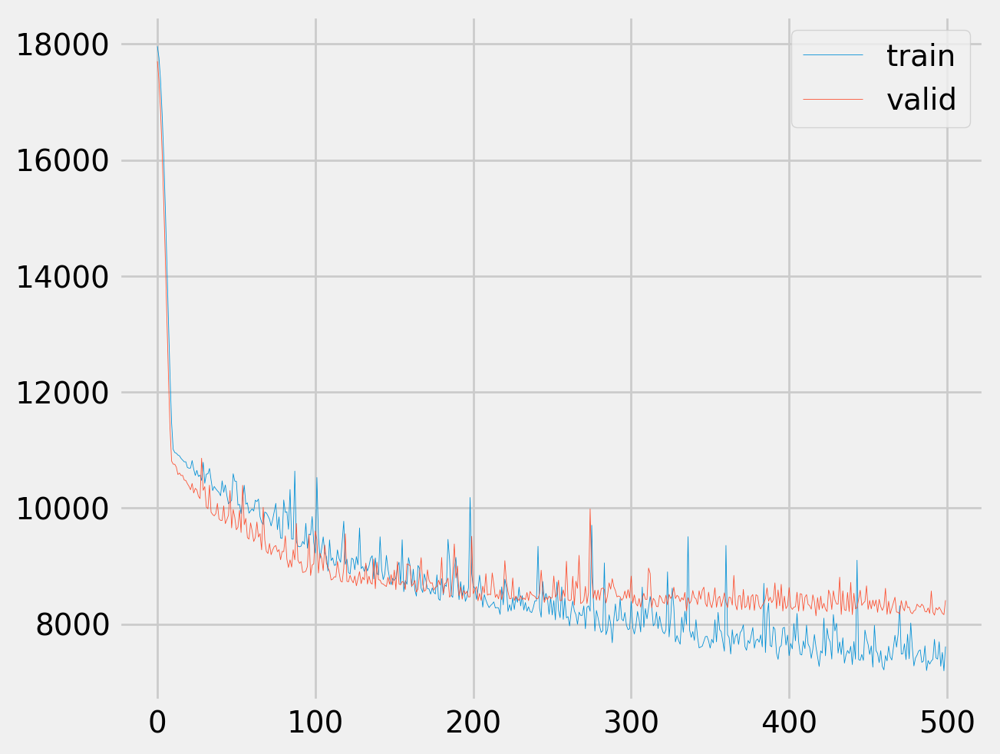

In [ ]:
loss_train = np.array(train_loss)
loss_valid = np.array(val_loss)

fig, ax = plt.subplots()

ax.plot(range(len(loss_train)),loss_train,label='train',lw=0.3)
ax.plot(range(len(loss_valid)),loss_valid,label='valid',lw=0.3)
#ax.set_yscale('log')
ax.legend();

In [ ]:
os.listdir(save_dir)

['best_model_241115.pt',
 'model_241115.pt',
 'train_loss.pkl',
 'valid_loss.pkl',
 'valid_score.pkl']

In [ ]:
best_model = torch.load(os.path.join(save_dir,f'best_{file_name}'))
model = torch.load(os.path.join(save_dir,file_name))

<ipython-input-54-13cdeefa0288>:1: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  best_model = torch.load(os.path.join(save_dir,f'best_{file_name}'))
<ipython-input-54-13cdee

6832.658205548273 	r2 :  0.6076463460922241 	mape :  0.33293268


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


6832.658205548273 	r2 :  0.6076463460922241 	mape :  0.33293268


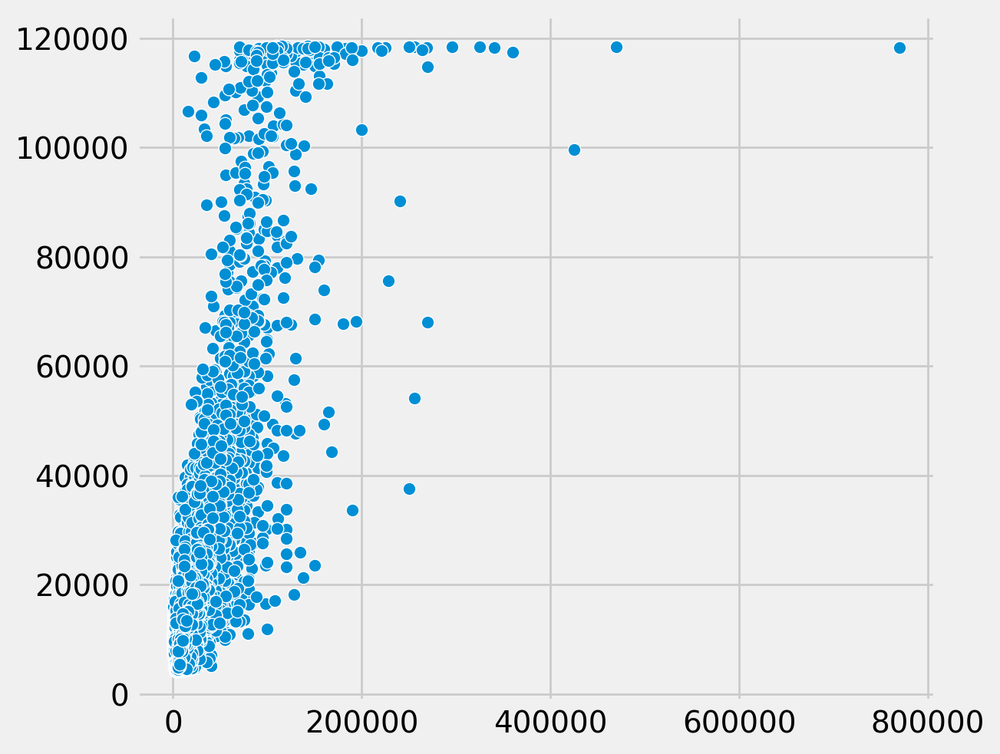

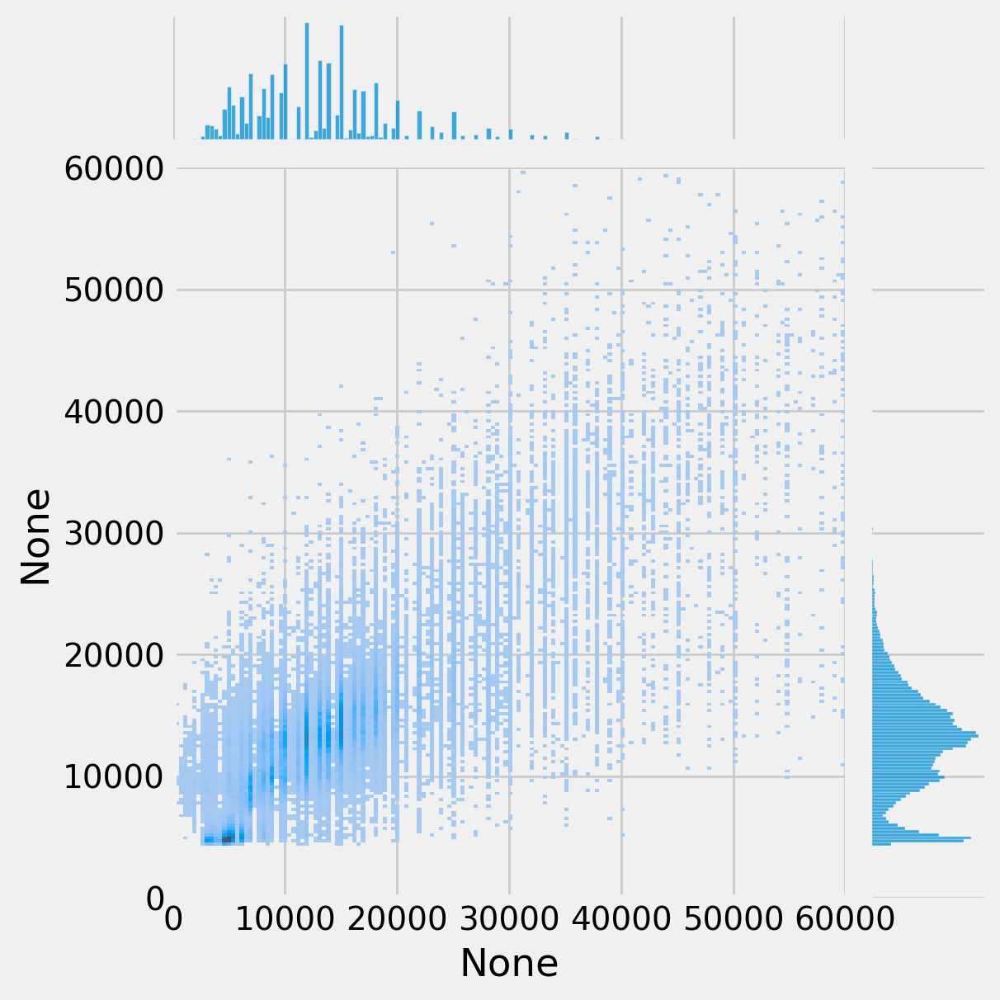

In [ ]:
test_n_plot(best_model,iter_dict['trn'],criterion,device) #gridsize 500
test_n_plot(best_model,iter_dict['trn'],criterion,device,scatter=False,kind='hist')#,gridsize=500) #gridsize 500

8141.857773260351 	r2 :  0.48707646131515503 	mape :  0.36604953


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


8141.857773260351 	r2 :  0.48707646131515503 	mape :  0.36604953


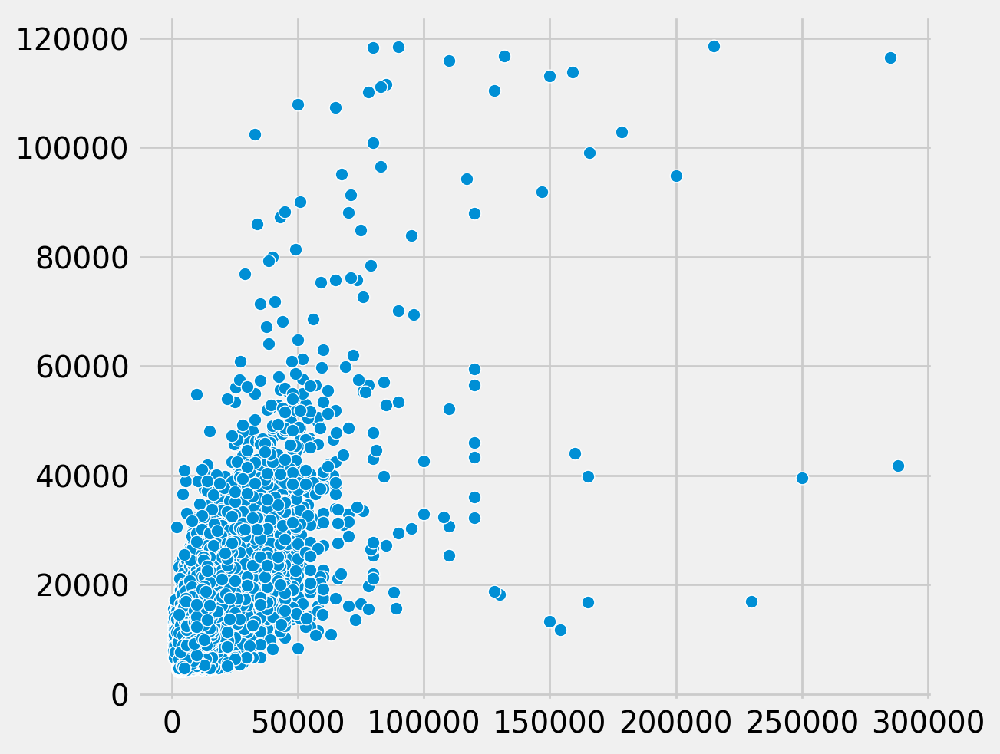

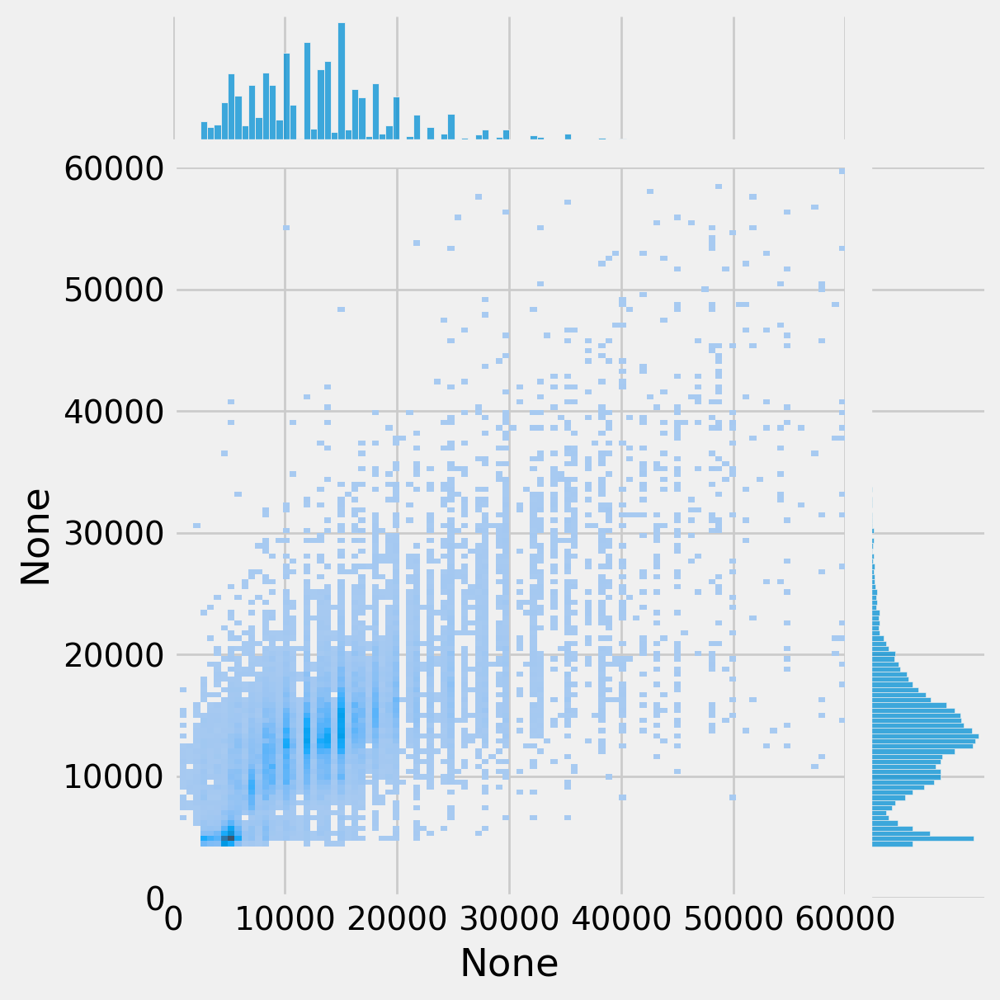

In [ ]:
test_n_plot(best_model,iter_dict['vld'],criterion,device) #gridsize 180
test_n_plot(best_model,iter_dict['vld'],criterion,device,scatter=False,kind='hist')#gridsize=180) #gridsize 180

8470.584041257132 	r2 :  0.4597567319869995 	mape :  0.3711025


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


8470.584041257132 	r2 :  0.4597567319869995 	mape :  0.3711025


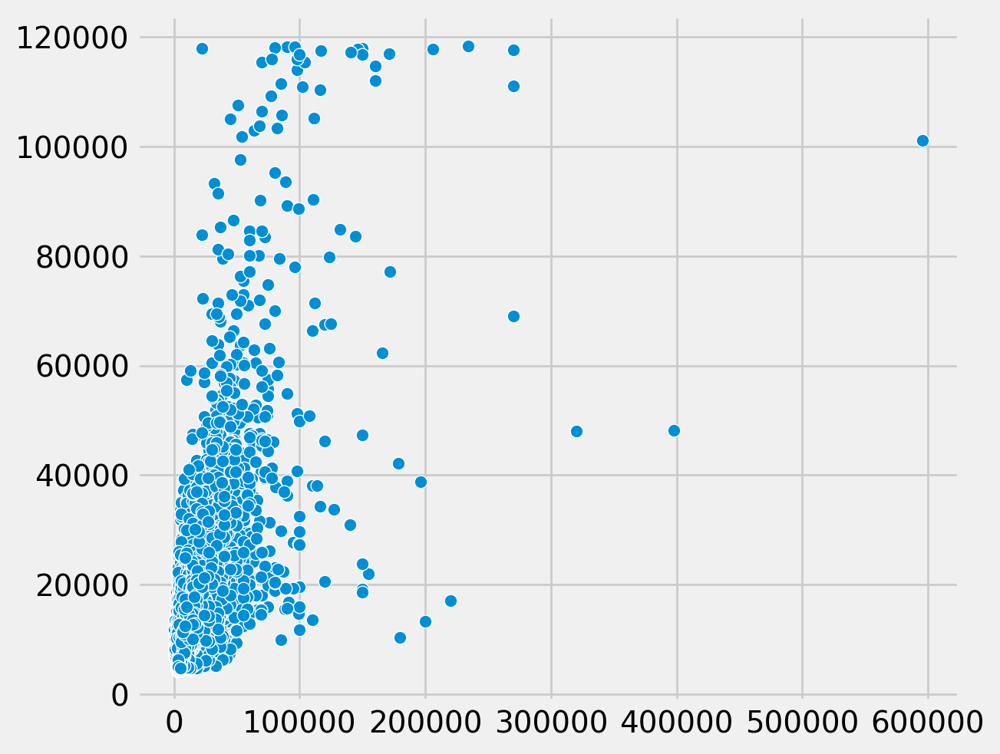

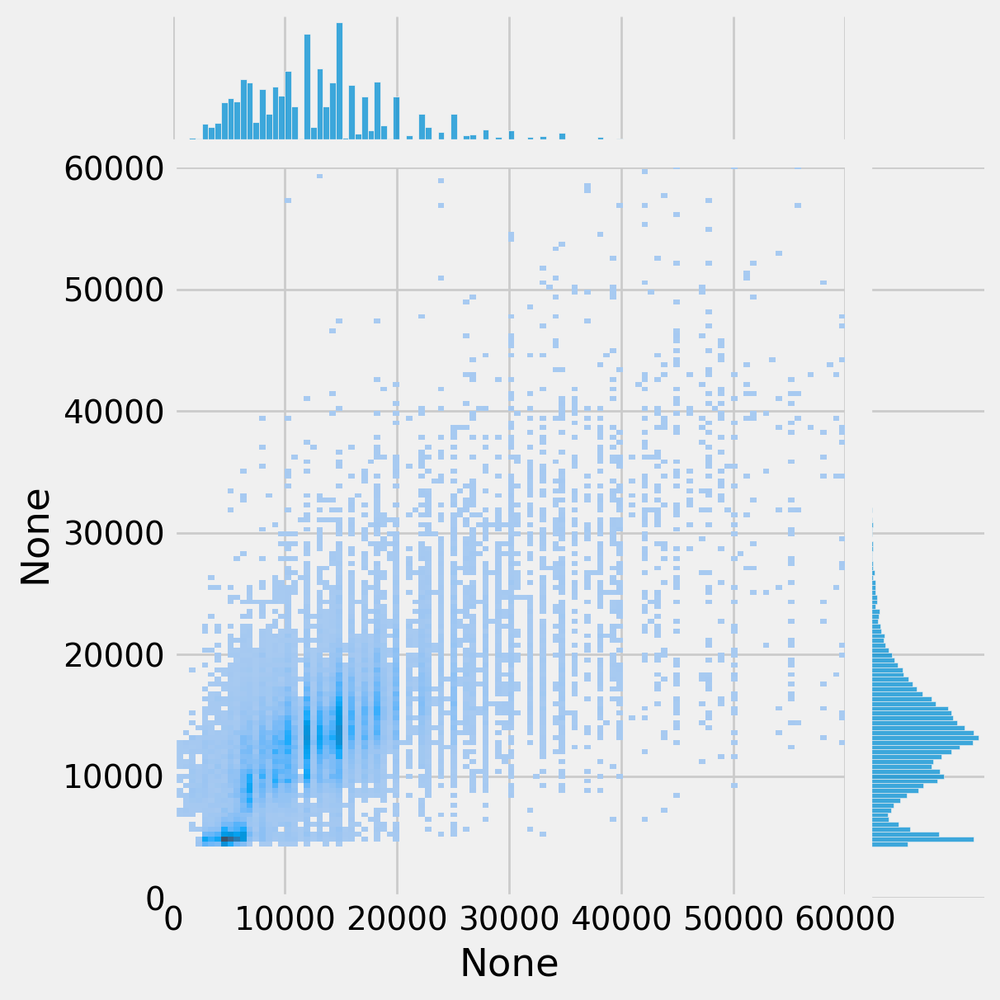

In [ ]:
test_n_plot(best_model,iter_dict['tst'],criterion,device) #gridsize 350
test_n_plot(best_model,iter_dict['tst'],criterion,device,scatter=False,kind='hist')#,gridsize=350) #gridsize 350

7039.425981842991 	r2 :  0.5833323001861572 	mape :  0.3281054


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


7039.425981842991 	r2 :  0.5833323001861572 	mape :  0.3281054


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


0.0 	r2 :  1.0 	mape :  0.0


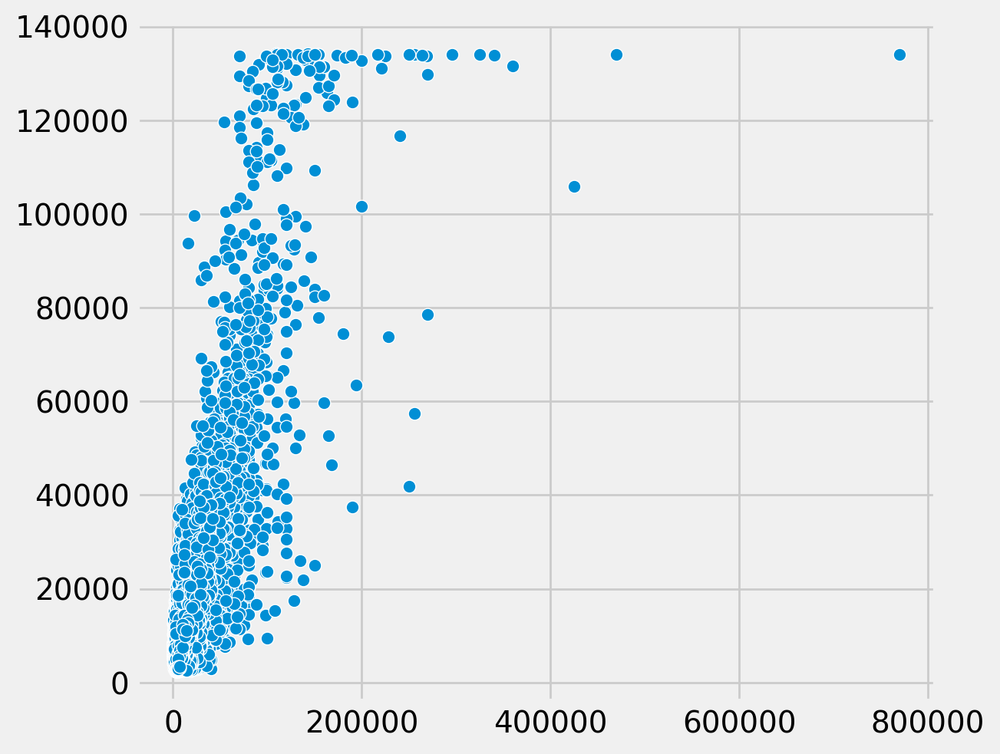

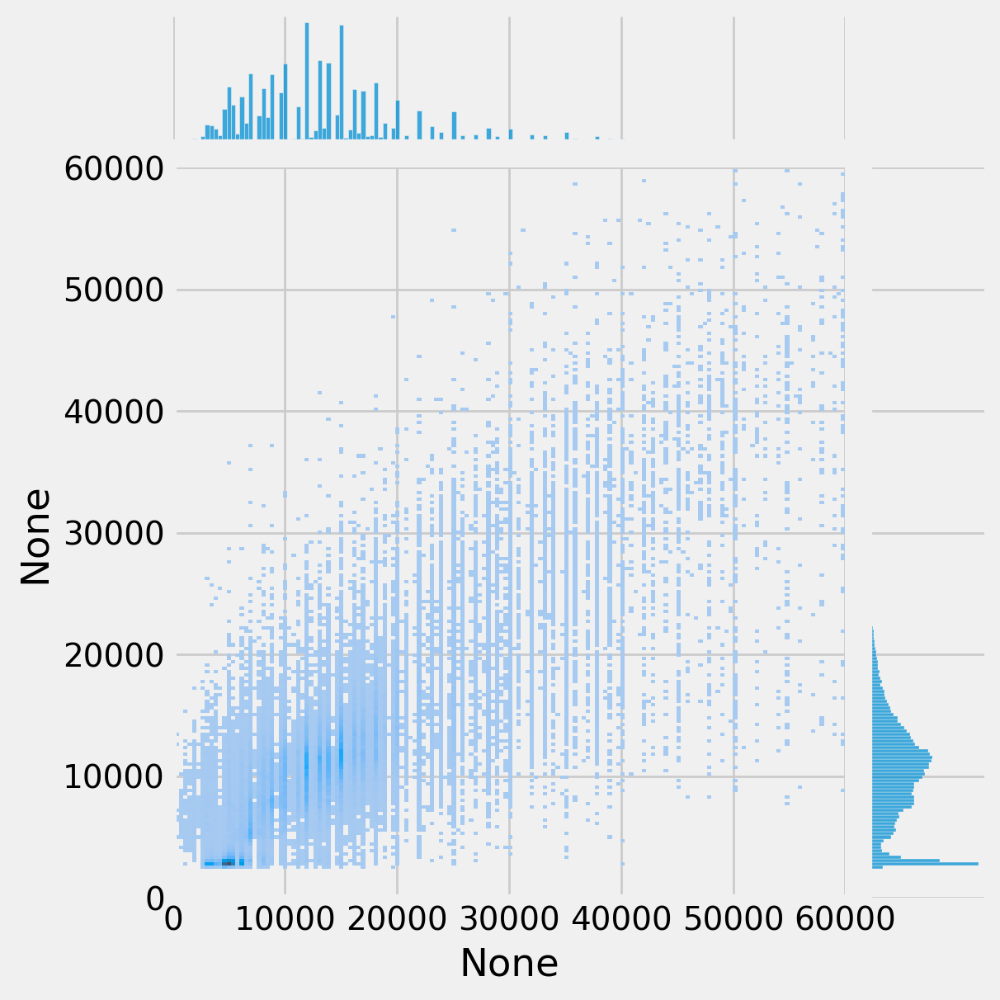

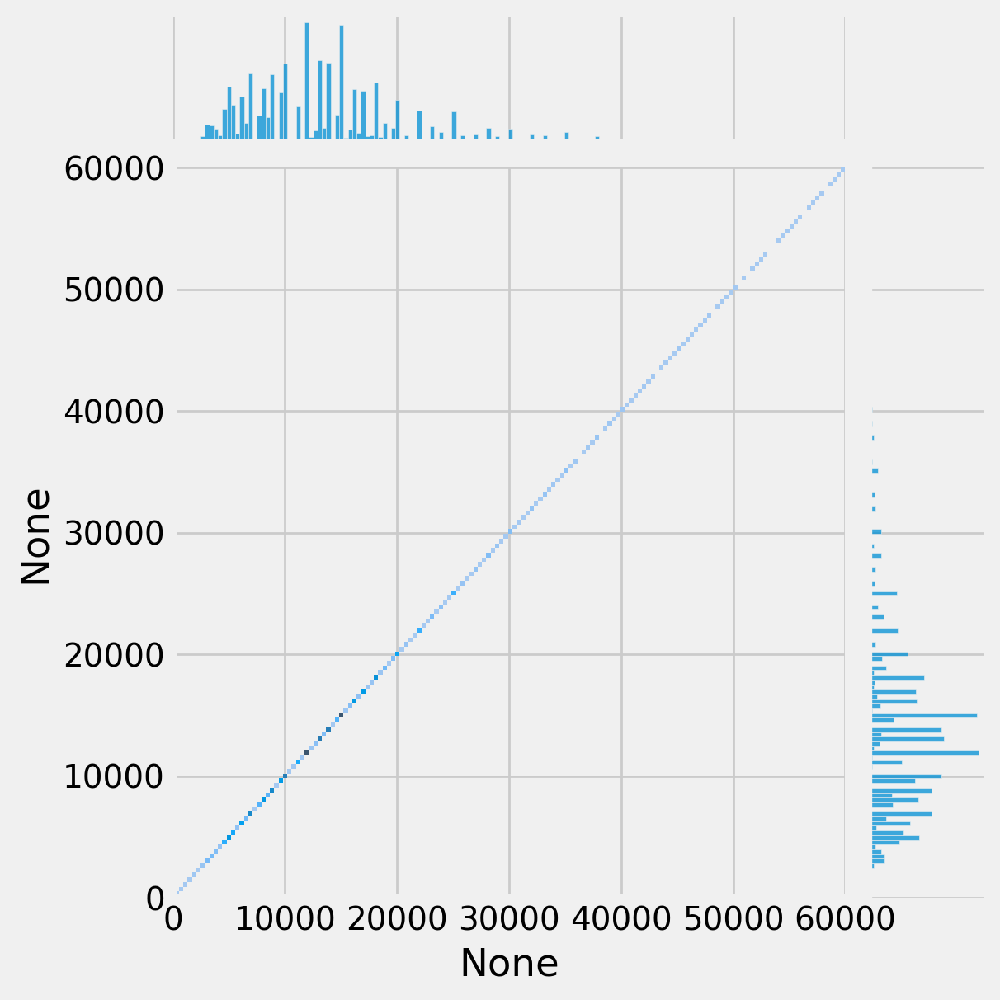

In [ ]:
test_n_plot(model,iter_dict['trn'],criterion,device) #gridsize 500
test_n_plot(model,iter_dict['trn'],criterion,device,scatter=False,kind='hist')#gridsize=250) #gridsize 500
test_n_plot(answer_trn,iter_dict['trn'],criterion,device,scatter=False,kind='hist')#gridsize=500) #gridsize 500
#https://stackoverflow.com/questions/29096632/getting-colorbar-in-a-hex-jointplot
#https://stackoverflow.com/questions/60845764/how-to-add-a-colorbar-to-the-side-of-a-kde-jointplot

8410.534703572657 	r2 :  0.4416388273239136 	mape :  0.3564607


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


8410.534703572657 	r2 :  0.4416388273239136 	mape :  0.3564607


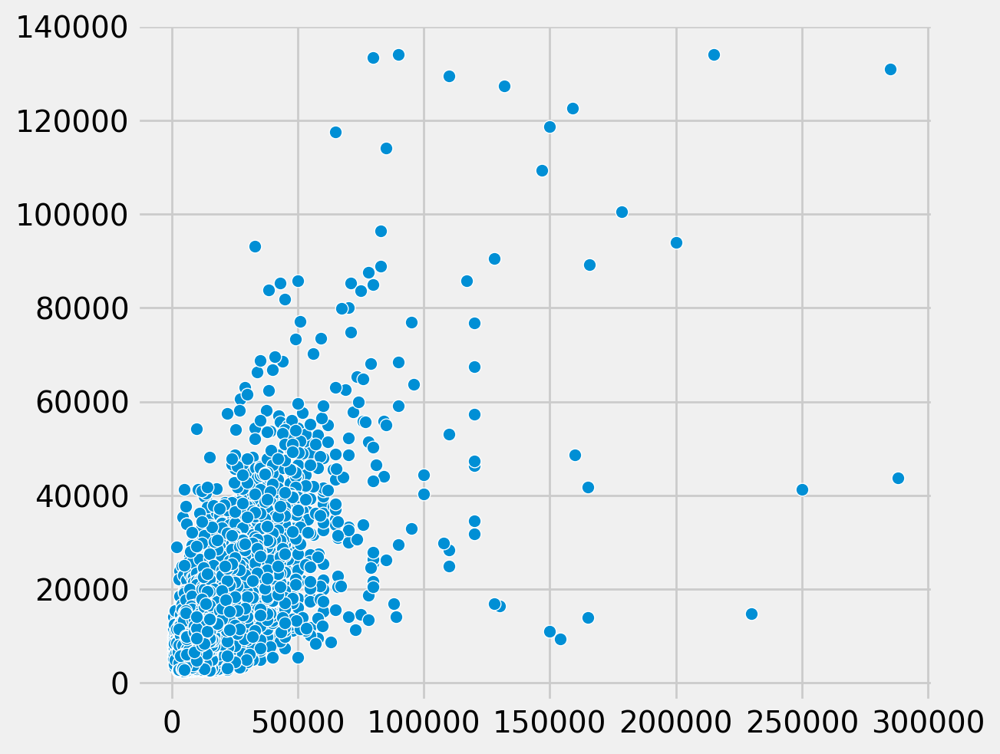

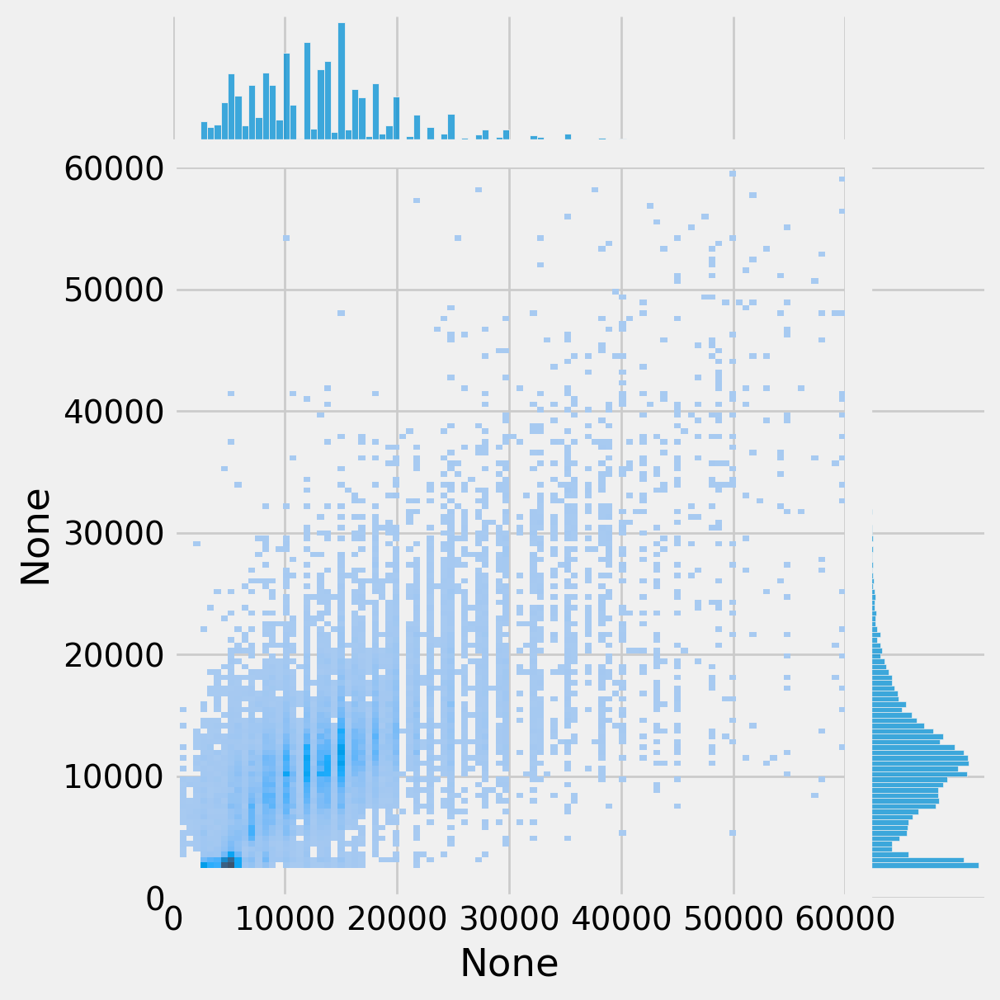

In [ ]:
test_n_plot(model,iter_dict['vld'],criterion,device) #gridsize 180
test_n_plot(model,iter_dict['vld'],criterion,device,scatter=False,kind='hist')#gridsize=180)
#test_n_plot(answer_vld,iter_dict['vld'],criterion,device,scatter=False,gridsize=220)

8802.711343671335 	r2 :  0.4163846969604492 	mape :  0.3603205


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


8802.711343671335 	r2 :  0.4163846969604492 	mape :  0.3603205


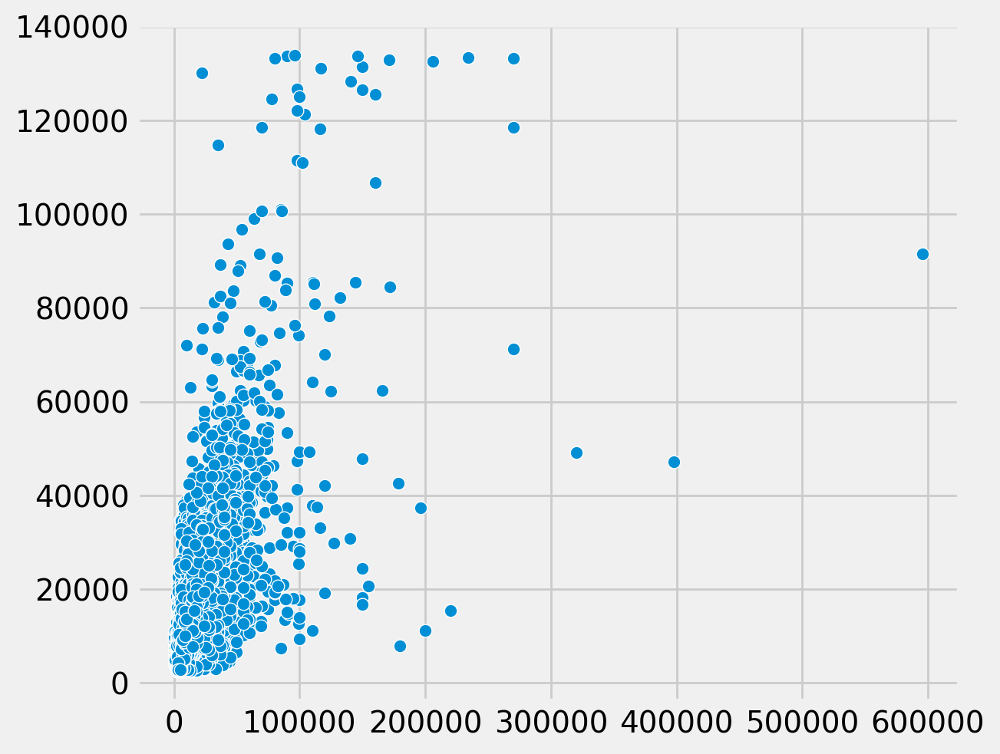

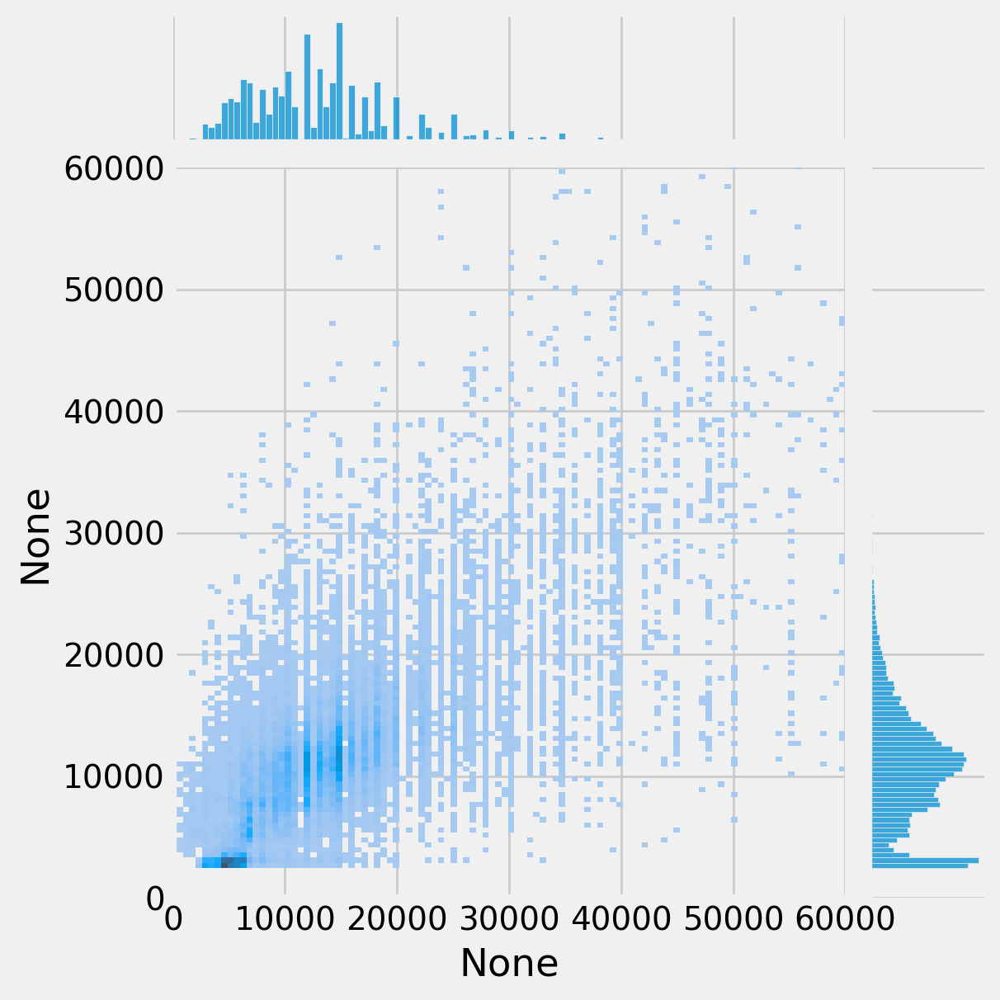

In [ ]:
test_n_plot(model,iter_dict['tst'],criterion,device) #gridsize 350
test_n_plot(model,iter_dict['tst'],criterion,device,scatter=False,kind='hist')#gridsize=220) #gridsize 350

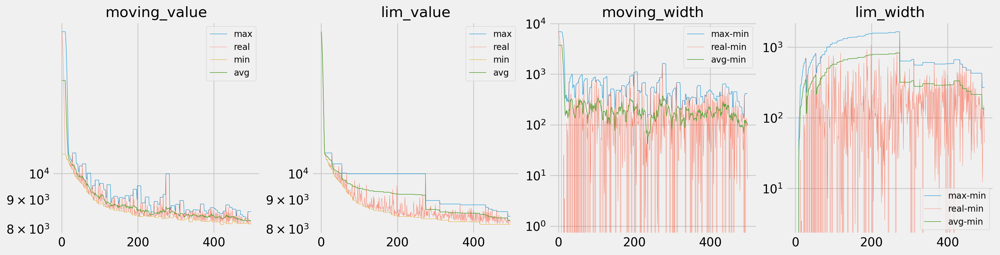

In [ ]:
x = val_loss
plot_area(x,start=0,end=-1);
#plot_area(x,start=750,end=-1,log=False);

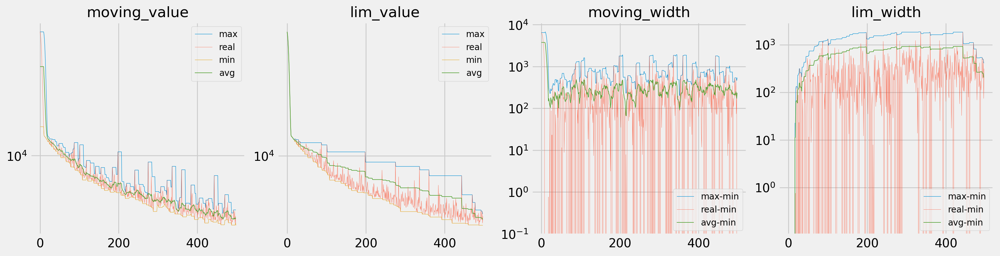

In [ ]:
x = train_loss
plot_area(x,start=0,end=-1);

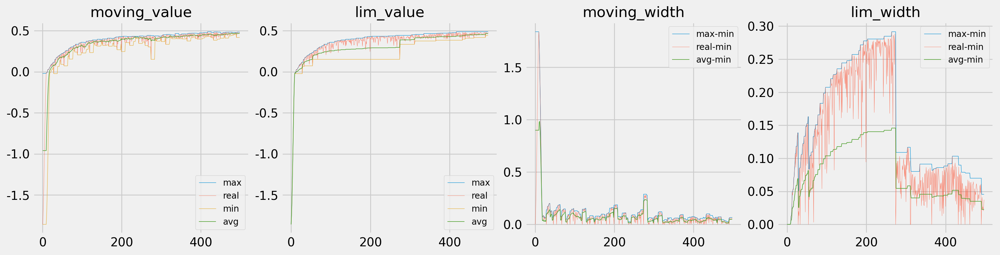

In [ ]:
x = val_score
plot_area(x,False,start=0,end=-1,log=False);

other lr

In [ ]:
d_model = 60 #64
head = 6
d_ff = 128
n_layers= 6

In [ ]:
from math import sqrt
display((len(data_dict['trn']['X'])/8192 * 60 * 100*sqrt(6))**(-0.5) * 0.05*1.5)
display((len(data_dict['trn']['X'])/8192 * 60 * 100*(6))**(-0.5) * 0.05*1.5)
display((len(data_dict['trn']['X'])/8192 * 60 * 500*sqrt(6))**(-0.5))

0.00017603964473286235

0.00011247931707602604

0.0010496976329535813

In [ ]:
# model parameter setting
batch_size = 8192

# optimizer parameter setting
init_lr = (418/450)*(497/450)* (378/450)*(443/450)*(248/450)*1.76*1e-4#1.76*1e-3 #9.52*1e-5 #5*1e-3#*3
factor = 0.95
adam_eps = 5e-7
patience = 10
warmup = 3
epoch = 500
clip = 1.0
weight_decay = 5e-20
drop_prob = 0.1

In [ ]:
model = Model4_5(col_start,d_model,head,d_ff,drop_prob,n_layers,device)
model, optimizer, scheduler, criterion =trainer_setting(model,init_lr,weight_decay,adam_eps,factor,patience)

The model has 11,852,587 trainable parameters


# train, evaluate

In [ ]:
model_name = 'model4.5'
expt_name = f'{model_name}_{batch_size}_{epoch}_N{n_layers}_lr{init_lr:.6f}'
save_dir = os.path.join(RSLT_DIR,'model',expt_name)
if not os.path.exists(save_dir) : os.makedirs(save_dir)
file_name = 'model_{}.pt'.format(241115)

In [ ]:
iter_dict.keys()

dict_keys(['vld', 'trn', 'tst'])

In [ ]:
train_config =[optimizer, scheduler, criterion, clip]

In [ ]:
model,train_loss,val_loss,train_score,val_score,best_epoch = run(model,train_config,iter_dict['trn'],iter_dict['vld'],epoch,warmup,8500,save_dir,file_name[:-3])
torch.save(model,os.path.join(save_dir,file_name))
save_pkl(save_dir,'train_loss.pkl',train_loss)
save_pkl(save_dir,'valid_loss.pkl',val_loss)
save_pkl(save_dir,'valid_score.pkl',val_score)

Epoch:     1		lr: 0.00008229
	Train Loss: 17967.227	Train Score: -1.680	Val Loss: 17722.767	Val Score: -1.866
Epoch:     2		lr: 0.00008229
	Train Loss: 17804.585	Train Score: -1.633	Val Loss: 17458.627	Val Score: -1.779
Epoch:     3		lr: 0.00008229
	Train Loss: 17486.314	Train Score: -1.541	Val Loss: 17020.683	Val Score: -1.638
Epoch:     4		lr: 0.00008229
	Train Loss: 17013.777	Train Score: -1.407	Val Loss: 16432.015	Val Score: -1.453
Epoch:     5		lr: 0.00008229
	Train Loss: 16406.745	Train Score: -1.240	Val Loss: 15715.518	Val Score: -1.238
Epoch:     6		lr: 0.00008229
	Train Loss: 15685.225	Train Score: -1.049	Val Loss: 14895.061	Val Score: -1.003
Epoch:     7		lr: 0.00008229
	Train Loss: 14869.858	Train Score: -0.843	Val Loss: 13995.865	Val Score: -0.760
Epoch:     8		lr: 0.00008229
	Train Loss: 13985.482	Train Score: -0.632	Val Loss: 13054.689	Val Score: -0.522
Epoch:     9		lr: 0.00008229
	Train Loss: 13076.079	Train Score: -0.428	Val Loss: 12141.853	Val Score: -0.306
Epoch:    

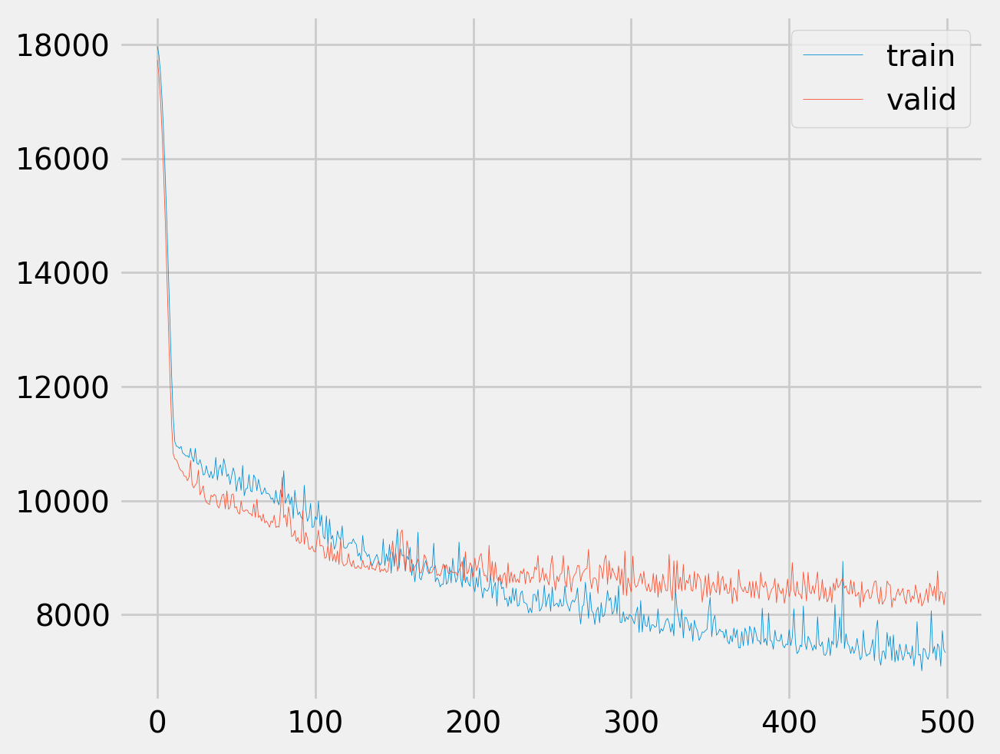

In [ ]:
loss_train = np.array(train_loss)
loss_valid = np.array(val_loss)

fig, ax = plt.subplots()

ax.plot(range(len(loss_train)),loss_train,label='train',lw=0.3)
ax.plot(range(len(loss_valid)),loss_valid,label='valid',lw=0.3)
#ax.set_yscale('log')
ax.legend();

In [ ]:
os.listdir(save_dir)

['best_model_241115.pt',
 'model_241115.pt',
 'train_loss.pkl',
 'valid_loss.pkl',
 'valid_score.pkl']

In [ ]:
best_model = torch.load(os.path.join(save_dir,f'best_{file_name}'))
model = torch.load(os.path.join(save_dir,file_name))

<ipython-input-49-13cdeefa0288>:1: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  best_model = torch.load(os.path.join(save_dir,f'best_{file_name}'))
<ipython-input-49-13cdee

6665.691388918909 	r2 :  0.6253294348716736 	mape :  0.3139447


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


6665.691388918909 	r2 :  0.6253294348716736 	mape :  0.3139447


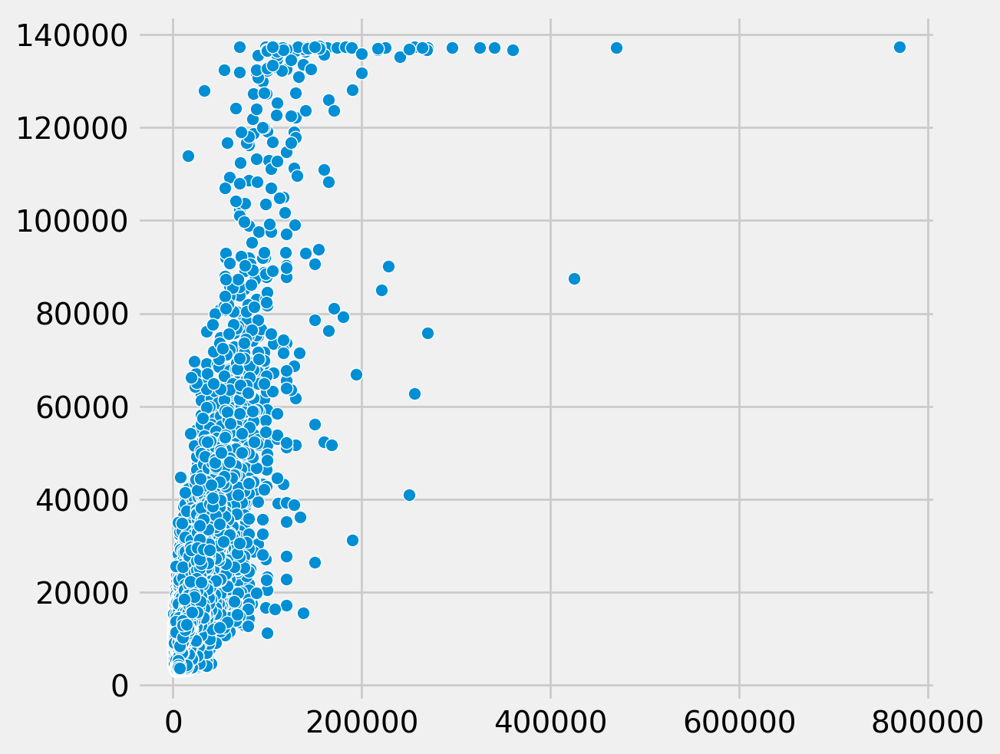

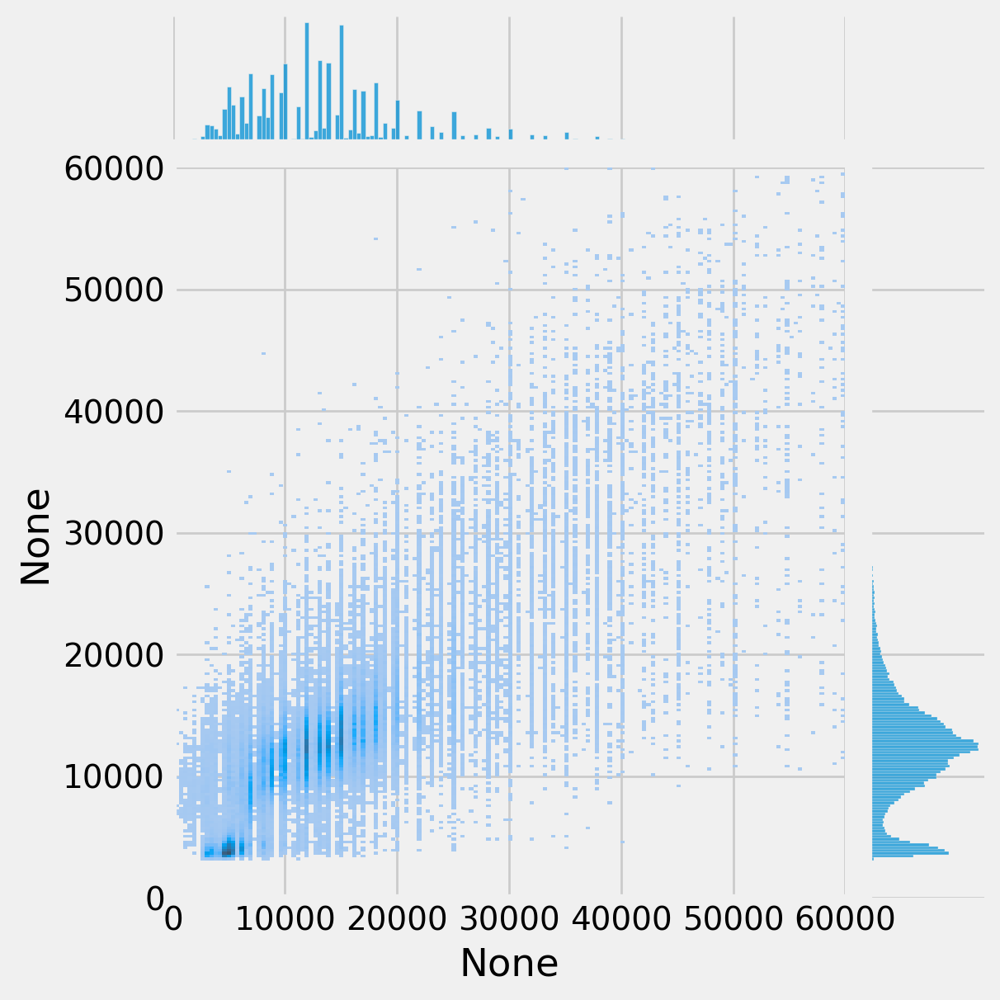

In [ ]:
test_n_plot(best_model,iter_dict['trn'],criterion,device) #gridsize 500
test_n_plot(best_model,iter_dict['trn'],criterion,device,scatter=False,kind='hist')#,gridsize=500) #gridsize 500

8126.324876597047 	r2 :  0.4845612645149231 	mape :  0.3391312


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


8126.324876597047 	r2 :  0.4845612645149231 	mape :  0.3391312


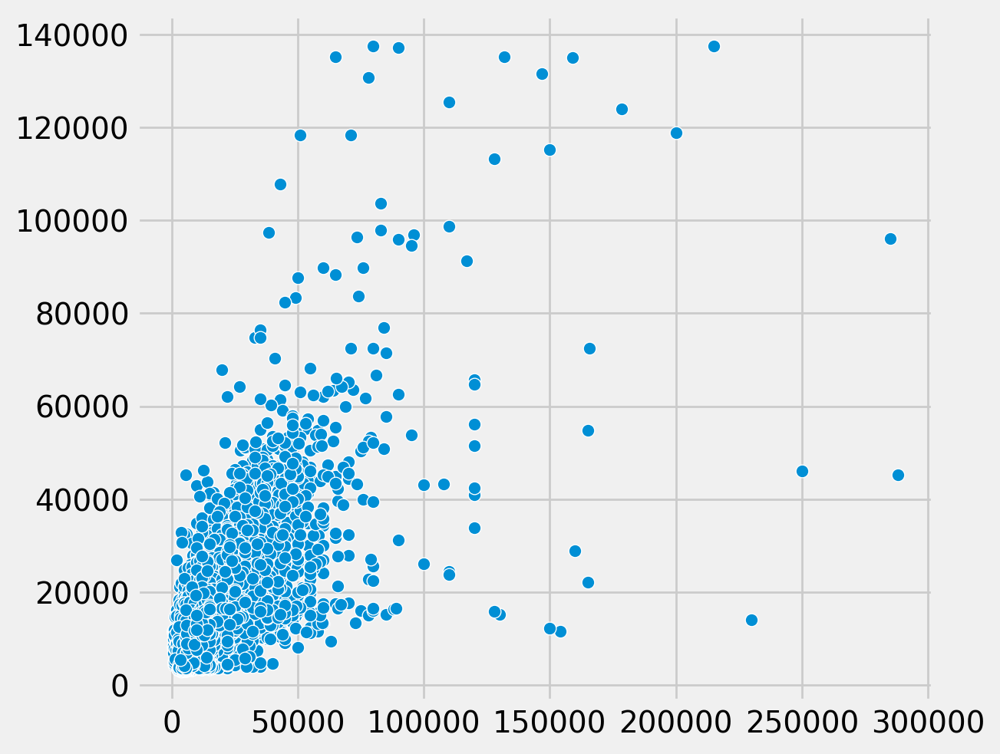

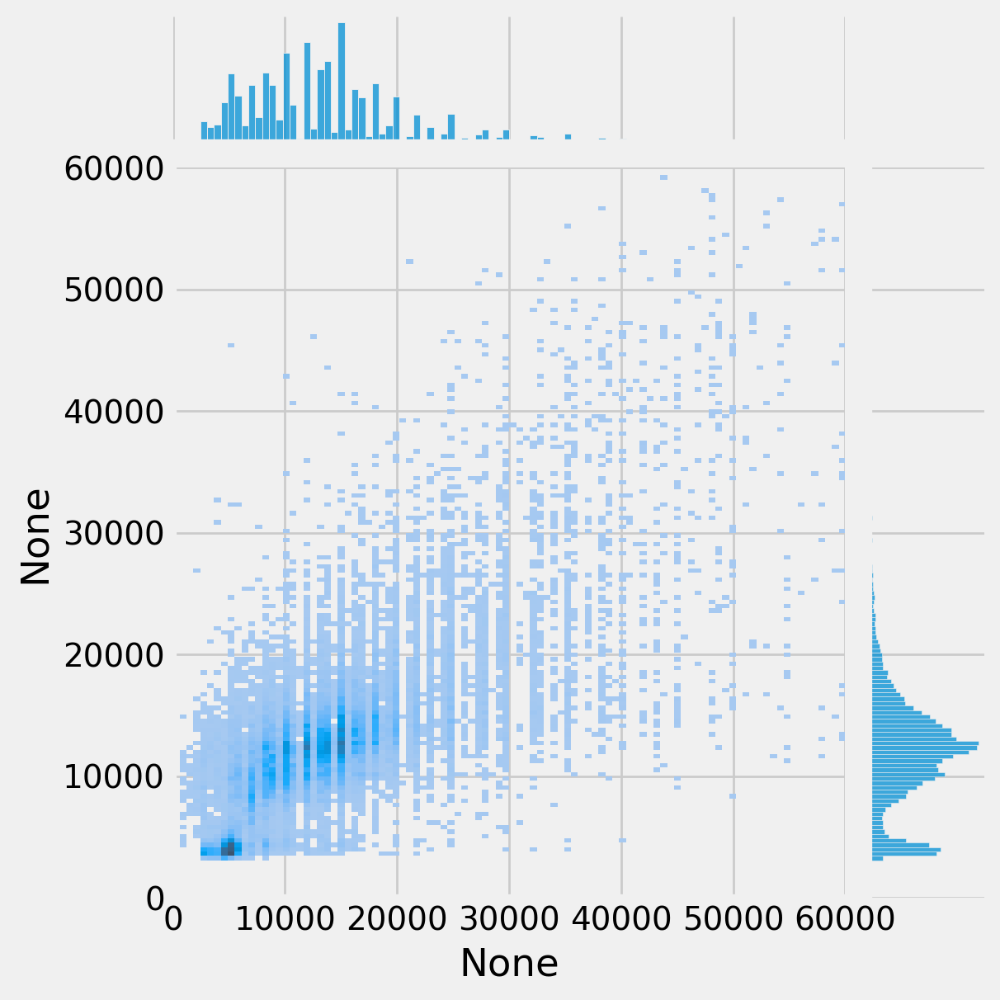

In [ ]:
test_n_plot(best_model,iter_dict['vld'],criterion,device) #gridsize 180
test_n_plot(best_model,iter_dict['vld'],criterion,device,scatter=False,kind='hist')#gridsize=180) #gridsize 180

8276.549522596963 	r2 :  0.48380517959594727 	mape :  0.3414135


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


8276.549522596963 	r2 :  0.48380517959594727 	mape :  0.3414135


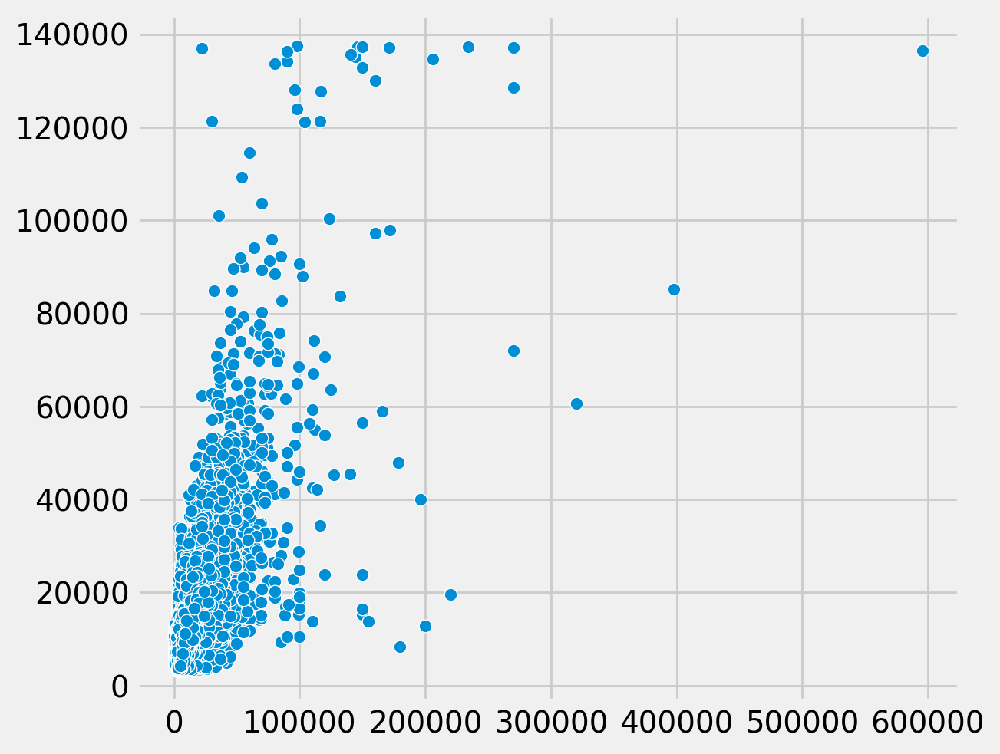

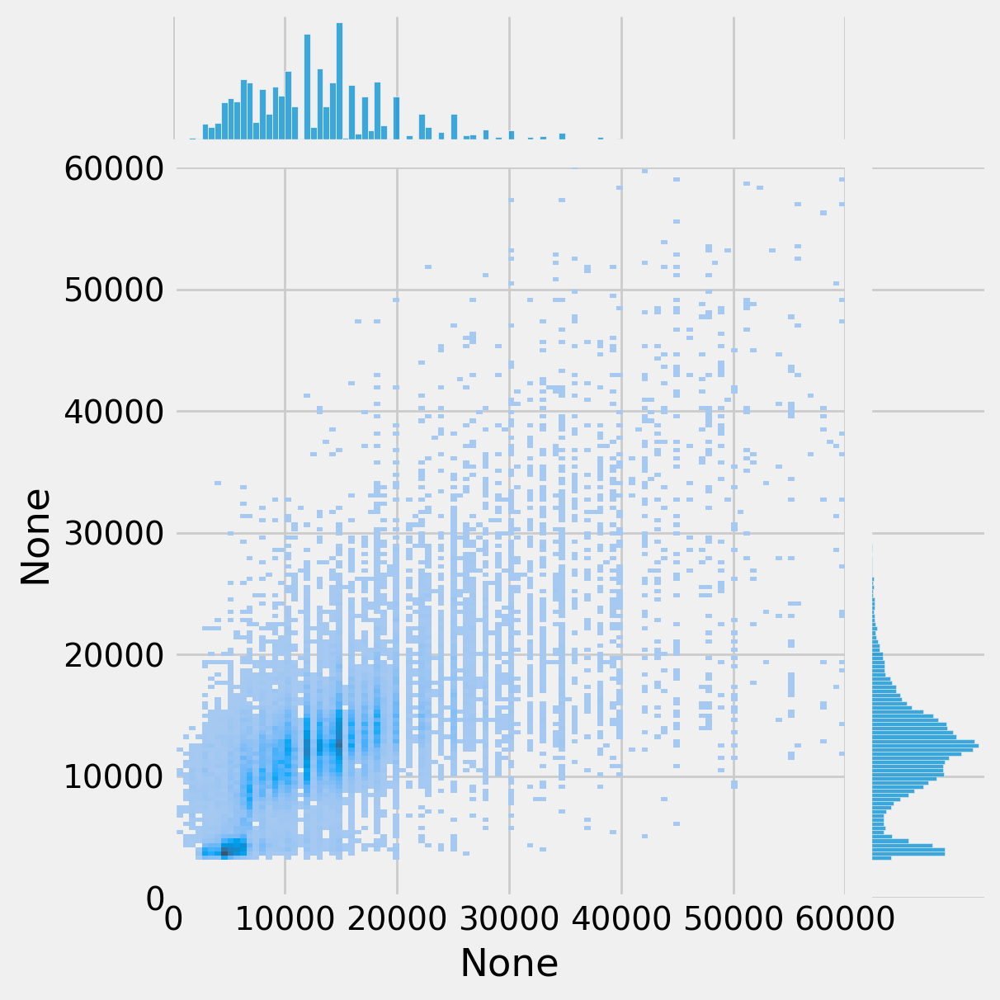

In [ ]:
test_n_plot(best_model,iter_dict['tst'],criterion,device) #gridsize 350
test_n_plot(best_model,iter_dict['tst'],criterion,device,scatter=False,kind='hist')#,gridsize=350) #gridsize 350

6739.636100653415 	r2 :  0.6179050207138062 	mape :  0.31786883


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


6739.636100653415 	r2 :  0.6179050207138062 	mape :  0.31786883


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


0.0 	r2 :  1.0 	mape :  0.0


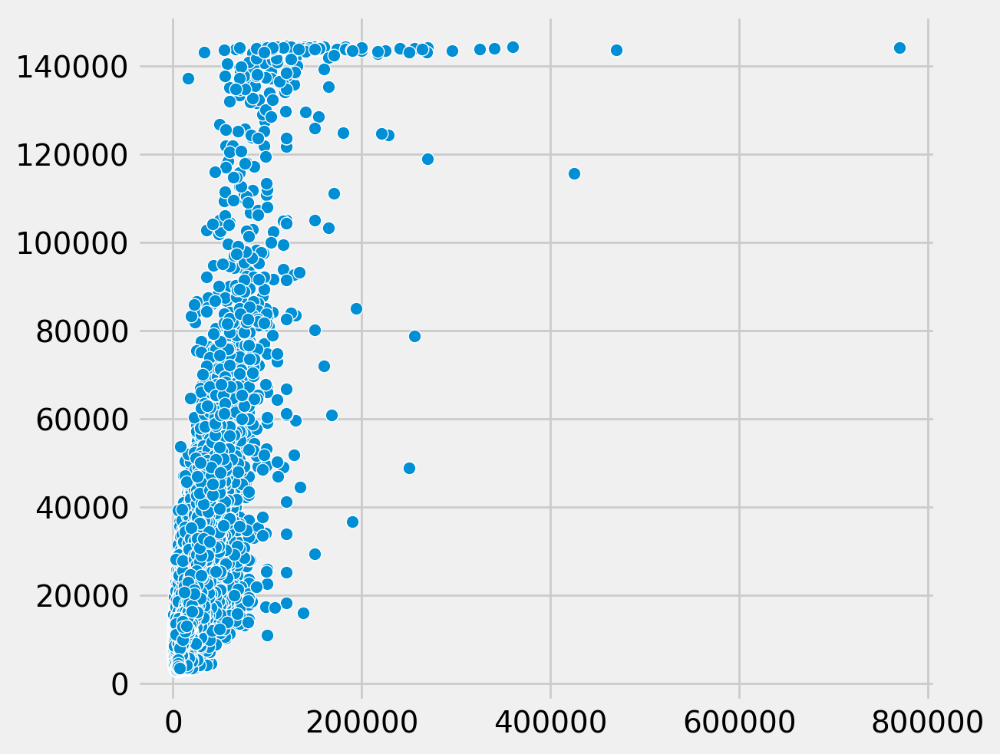

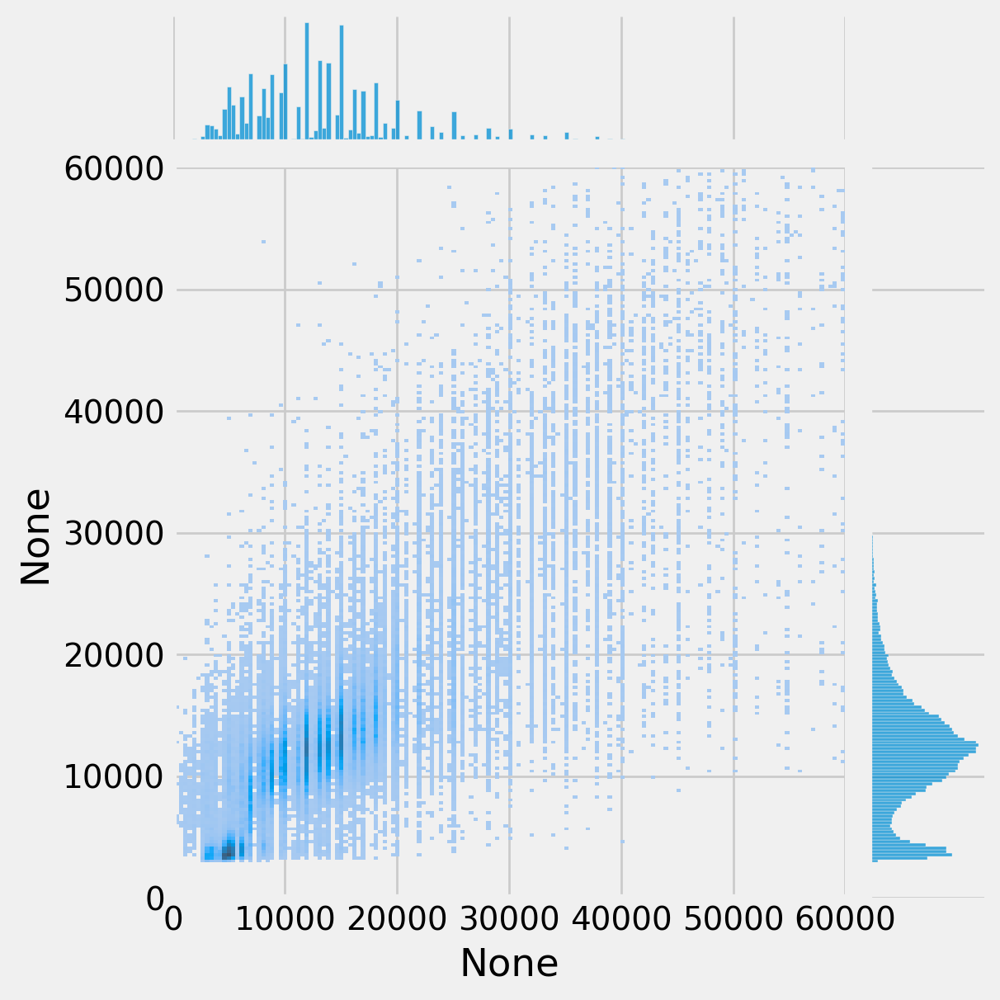

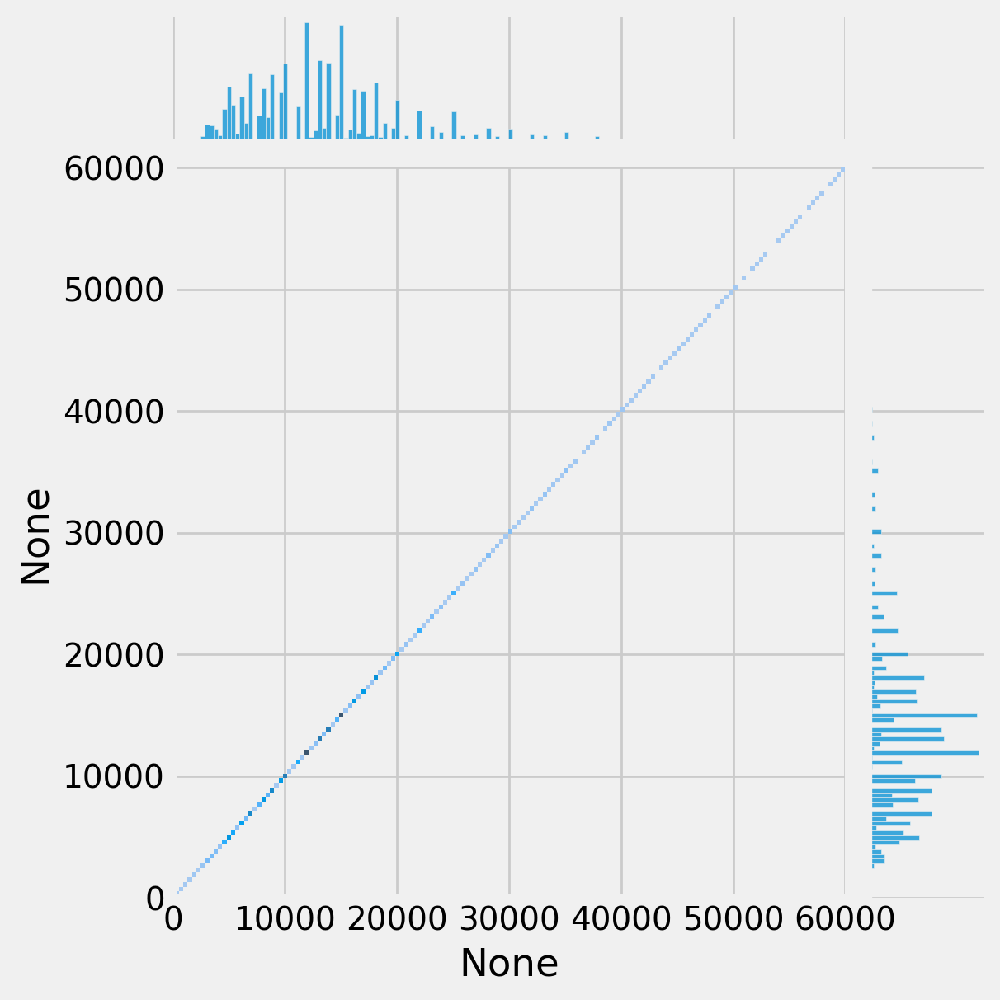

In [ ]:
test_n_plot(model,iter_dict['trn'],criterion,device) #gridsize 500
test_n_plot(model,iter_dict['trn'],criterion,device,scatter=False,kind='hist')#gridsize=250) #gridsize 500
test_n_plot(answer_trn,iter_dict['trn'],criterion,device,scatter=False,kind='hist')#gridsize=500) #gridsize 500
#https://stackoverflow.com/questions/29096632/getting-colorbar-in-a-hex-jointplot
#https://stackoverflow.com/questions/60845764/how-to-add-a-colorbar-to-the-side-of-a-kde-jointplot

8400.580813253331 	r2 :  0.45333361625671387 	mape :  0.34995356


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


8400.580813253331 	r2 :  0.45333361625671387 	mape :  0.34995356


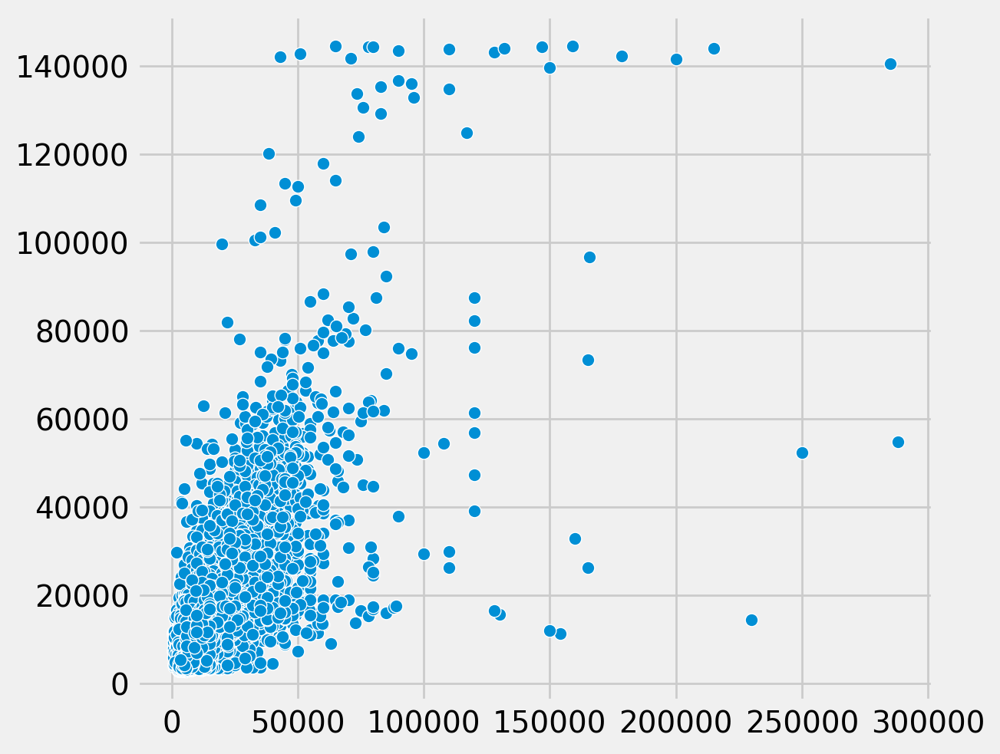

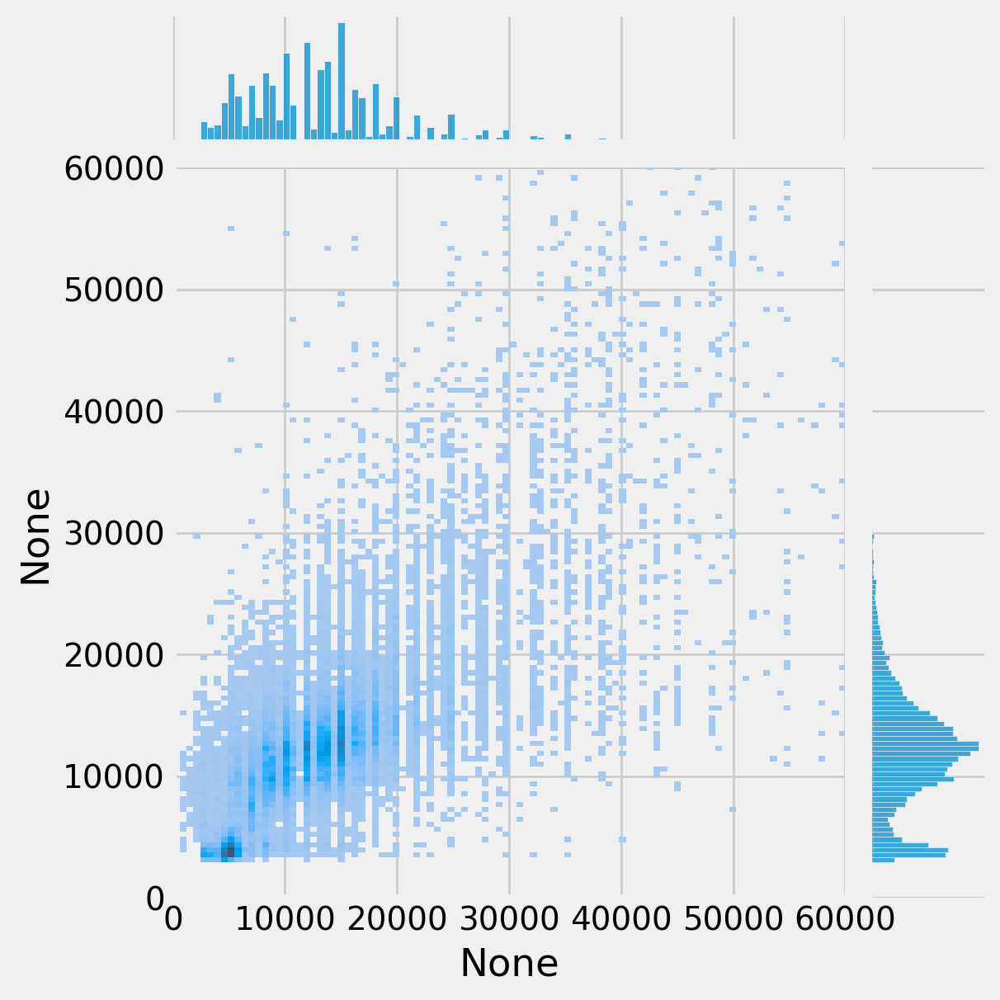

In [ ]:
test_n_plot(model,iter_dict['vld'],criterion,device) #gridsize 180
test_n_plot(model,iter_dict['vld'],criterion,device,scatter=False,kind='hist')#gridsize=180)
#test_n_plot(answer_vld,iter_dict['vld'],criterion,device,scatter=False,gridsize=220)

8421.990263589718 	r2 :  0.46420949697494507 	mape :  0.35052872


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


8421.990263589718 	r2 :  0.46420949697494507 	mape :  0.35052872


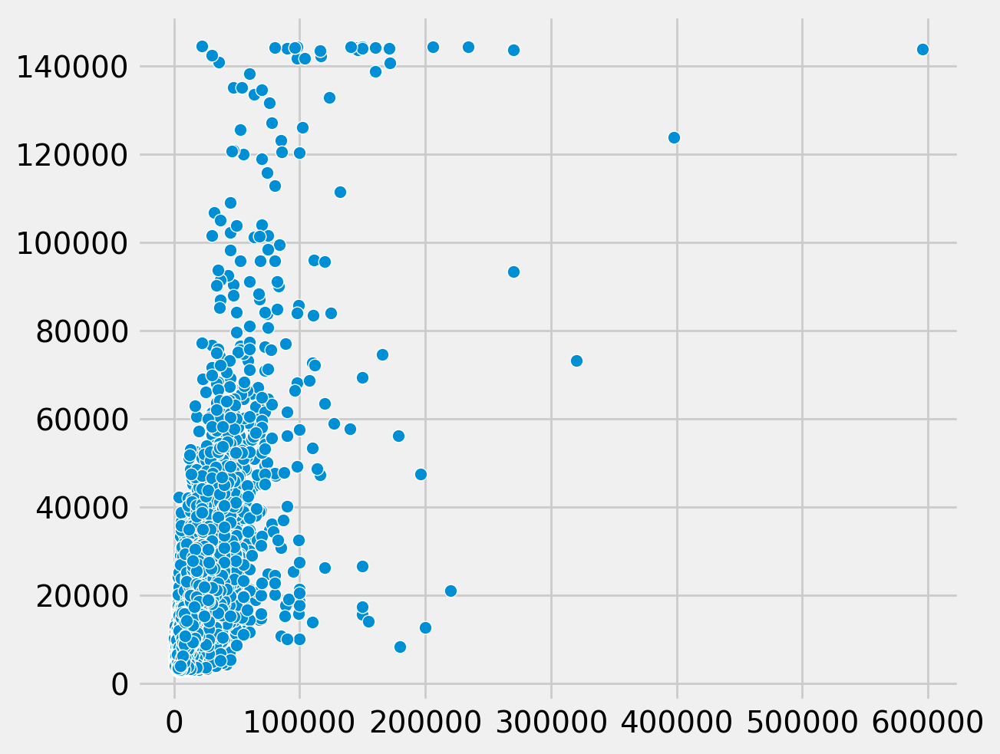

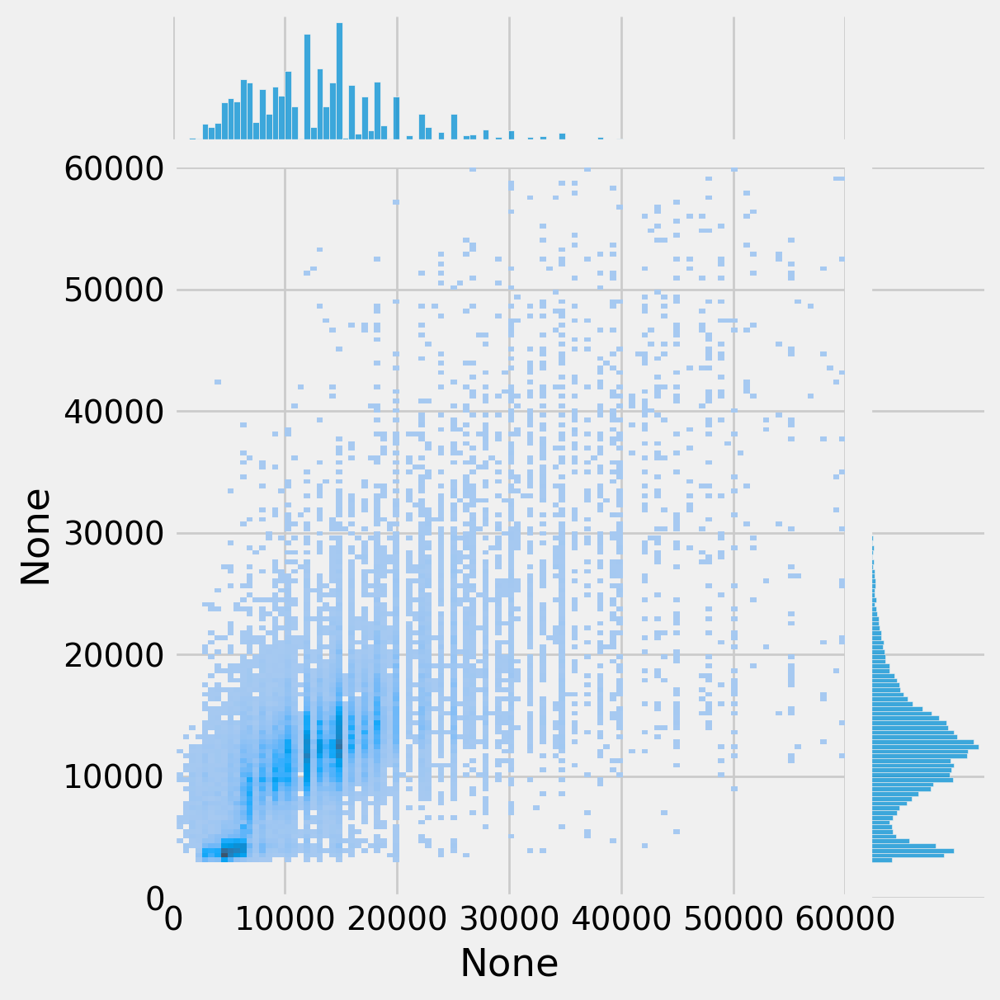

In [ ]:
test_n_plot(model,iter_dict['tst'],criterion,device) #gridsize 350
test_n_plot(model,iter_dict['tst'],criterion,device,scatter=False,kind='hist')#gridsize=220) #gridsize 350

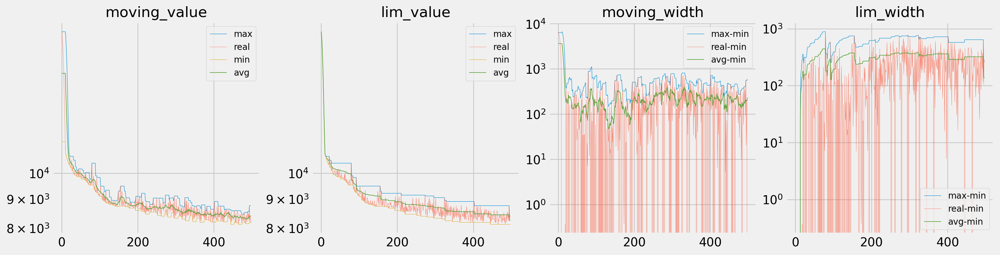

In [ ]:
x = val_loss
plot_area(x,start=0,end=-1);
#plot_area(x,start=750,end=-1,log=False);

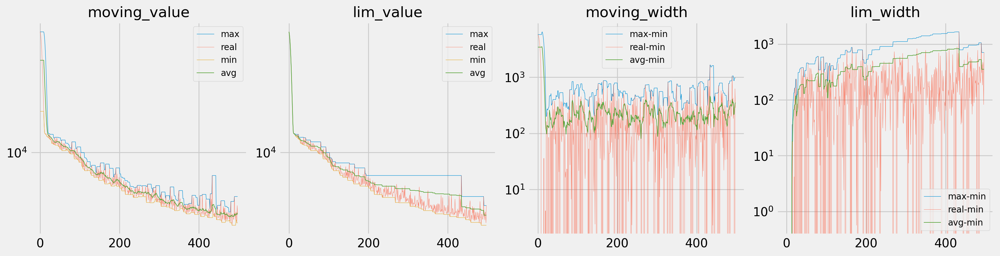

In [ ]:
x = train_loss
plot_area(x,start=0,end=-1);

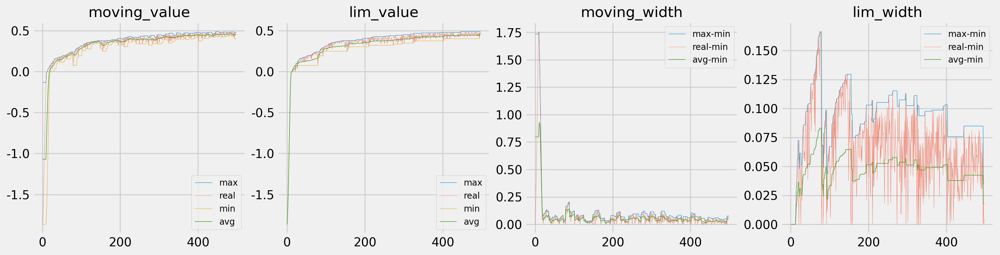

In [ ]:
x = val_score
plot_area(x,False,start=0,end=-1,log=False);

other lr

In [ ]:
d_model = 60 #64
head = 6
d_ff = 128
n_layers= 6

In [ ]:
from math import sqrt
display((len(data_dict['trn']['X'])/8192 * 60 * 100*sqrt(6))**(-0.5) * 0.05*1.5)
display((len(data_dict['trn']['X'])/8192 * 60 * 100*(6))**(-0.5) * 0.05*1.5)
display((len(data_dict['trn']['X'])/8192 * 60 * 500*sqrt(6))**(-0.5))

0.00017603964473286235

0.00011247931707602604

0.0010496976329535813

In [ ]:
# model parameter setting
batch_size = 8192

# optimizer parameter setting
init_lr = (466/450)*(418/450)*(497/450)* (378/450)*(443/450)*(248/450)*1.76*1e-4#1.76*1e-3 #9.52*1e-5 #5*1e-3#*3
factor = 0.95
adam_eps = 5e-7
patience = 10
warmup = 3
epoch = 500
clip = 1.0
weight_decay = 5e-20
drop_prob = 0.1

In [ ]:
model = Model4_5(col_start,d_model,head,d_ff,drop_prob,n_layers,device)
model, optimizer, scheduler, criterion =trainer_setting(model,init_lr,weight_decay,adam_eps,factor,patience)

The model has 11,852,587 trainable parameters


/content/drive/MyDrive/kdt-EST-AI/project/project2/module_aladin/torch_train.py:151: FutureWarning: `nn.init.kaiming_uniform` is now deprecated in favor of `nn.init.kaiming_uniform_`.
  nn.init.kaiming_uniform(m.weight.data)
/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(


# train, evaluate

In [ ]:
model_name = 'model4.5'
expt_name = f'{model_name}_{batch_size}_{epoch}_N{n_layers}_lr{init_lr:.6f}'
save_dir = os.path.join(RSLT_DIR,'model',expt_name)
if not os.path.exists(save_dir) : os.makedirs(save_dir)
file_name = 'model_{}.pt'.format(241115)

In [ ]:
iter_dict.keys()

dict_keys(['vld', 'trn', 'tst'])

In [ ]:
train_config =[optimizer, scheduler, criterion, clip]

In [ ]:
model,train_loss,val_loss,train_score,val_score,best_epoch = run(model,train_config,iter_dict['trn'],iter_dict['vld'],epoch,warmup,8500,save_dir,file_name[:-3])
torch.save(model,os.path.join(save_dir,file_name))
save_pkl(save_dir,'train_loss.pkl',train_loss)
save_pkl(save_dir,'valid_loss.pkl',val_loss)
save_pkl(save_dir,'valid_score.pkl',val_score)

Epoch:     1		lr: 0.00008521
	Train Loss: 17961.609	Train Score: -1.679	Val Loss: 17709.825	Val Score: -1.862
Epoch:     2		lr: 0.00008521
	Train Loss: 17779.112	Train Score: -1.626	Val Loss: 17416.837	Val Score: -1.765
Epoch:     3		lr: 0.00008521
	Train Loss: 17421.861	Train Score: -1.523	Val Loss: 16933.624	Val Score: -1.610
Epoch:     4		lr: 0.00008521
	Train Loss: 16893.308	Train Score: -1.374	Val Loss: 16281.140	Val Score: -1.407
Epoch:     5		lr: 0.00008521
	Train Loss: 16214.757	Train Score: -1.189	Val Loss: 15488.891	Val Score: -1.172
Epoch:     6		lr: 0.00008521
	Train Loss: 15408.767	Train Score: -0.978	Val Loss: 14580.050	Val Score: -0.916
Epoch:     7		lr: 0.00008521
	Train Loss: 14504.635	Train Score: -0.755	Val Loss: 13598.707	Val Score: -0.657
Epoch:     8		lr: 0.00008521
	Train Loss: 13545.265	Train Score: -0.532	Val Loss: 12607.112	Val Score: -0.414
Epoch:     9		lr: 0.00008521
	Train Loss: 12595.801	Train Score: -0.326	Val Loss: 11695.857	Val Score: -0.207
Epoch:    

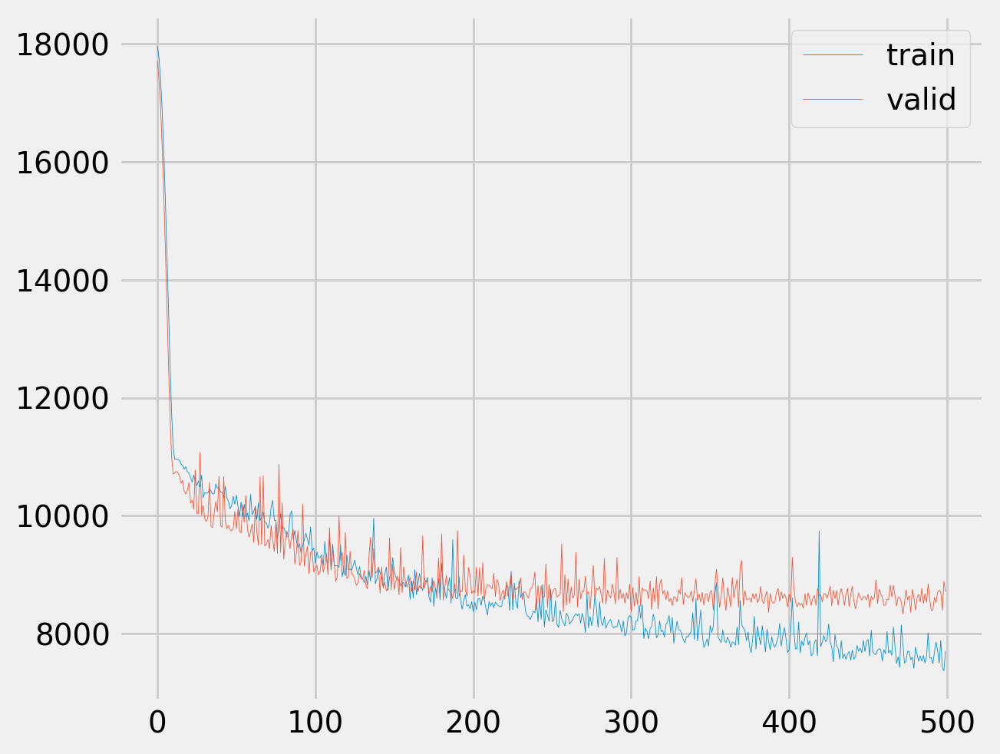

In [ ]:
loss_train = np.array(train_loss)
loss_valid = np.array(val_loss)

fig, ax = plt.subplots()

ax.plot(range(len(loss_train)),loss_train,label='train',lw=0.3)
ax.plot(range(len(loss_valid)),loss_valid,label='valid',lw=0.3)
#ax.set_yscale('log')
ax.legend();

In [ ]:
os.listdir(save_dir)

['best_model_241115.pt',
 'model_241115.pt',
 'train_loss.pkl',
 'valid_loss.pkl',
 'valid_score.pkl']

In [ ]:
best_model = torch.load(os.path.join(save_dir,f'best_{file_name}'))
model = torch.load(os.path.join(save_dir,file_name))

<ipython-input-40-13cdeefa0288>:1: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  best_model = torch.load(os.path.join(save_dir,f'best_{file_name}'))
<ipython-input-40-13cdee

7144.623949839164 	r2 :  0.5707331895828247 	mape :  0.31550002


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


7144.623949839164 	r2 :  0.5707331895828247 	mape :  0.31550002


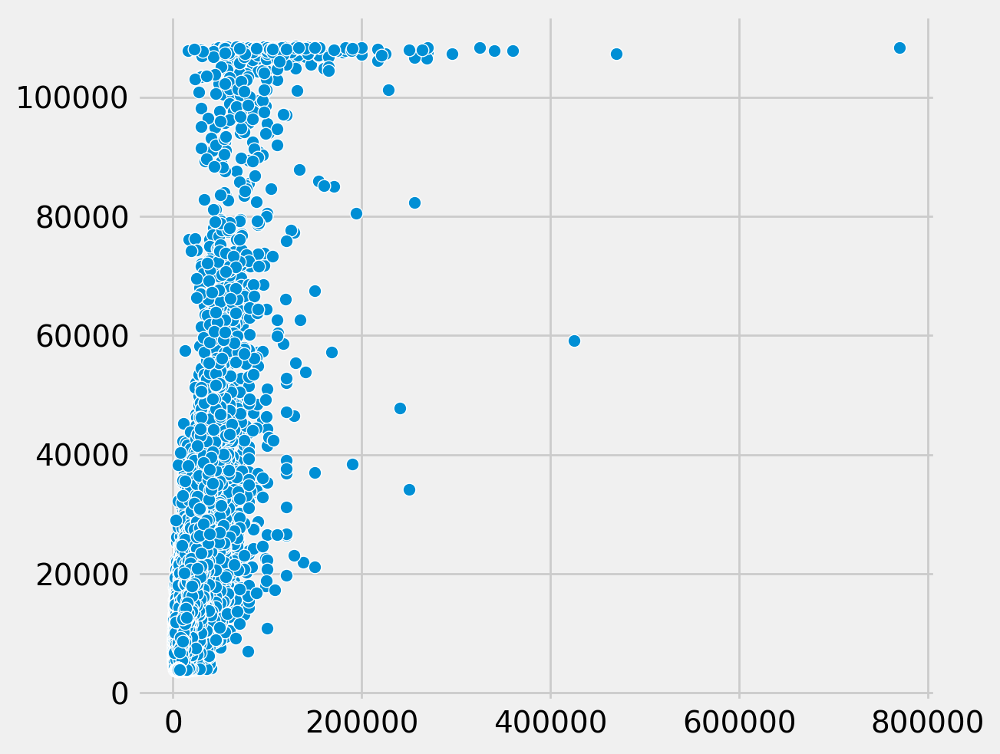

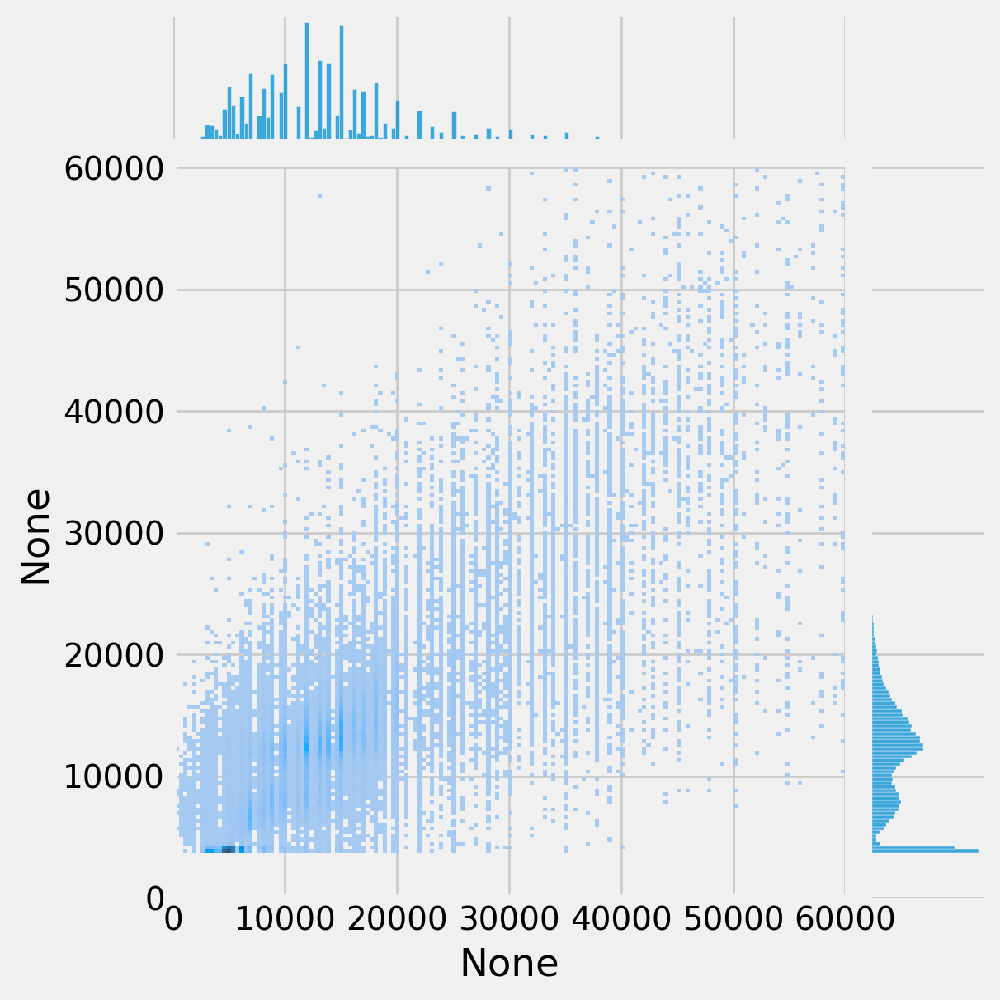

In [ ]:
test_n_plot(best_model,iter_dict['trn'],criterion,device) #gridsize 500
test_n_plot(best_model,iter_dict['trn'],criterion,device,scatter=False,kind='hist')#,gridsize=500) #gridsize 500

8335.454456716801 	r2 :  0.4503004550933838 	mape :  0.34447175


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


8335.454456716801 	r2 :  0.4503004550933838 	mape :  0.34447175


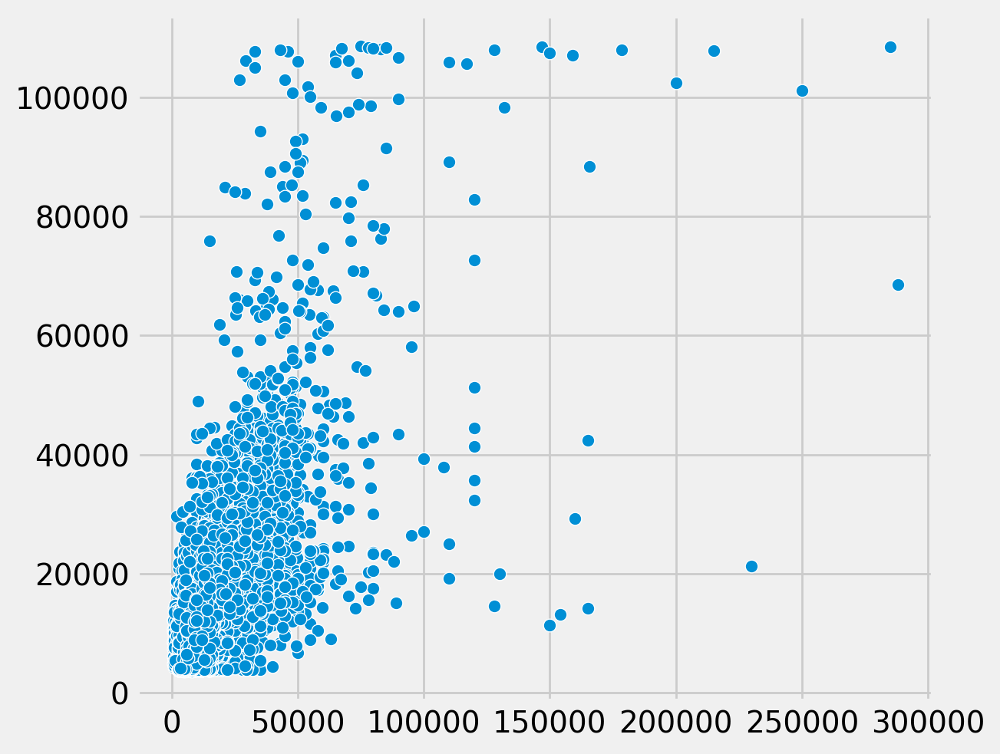

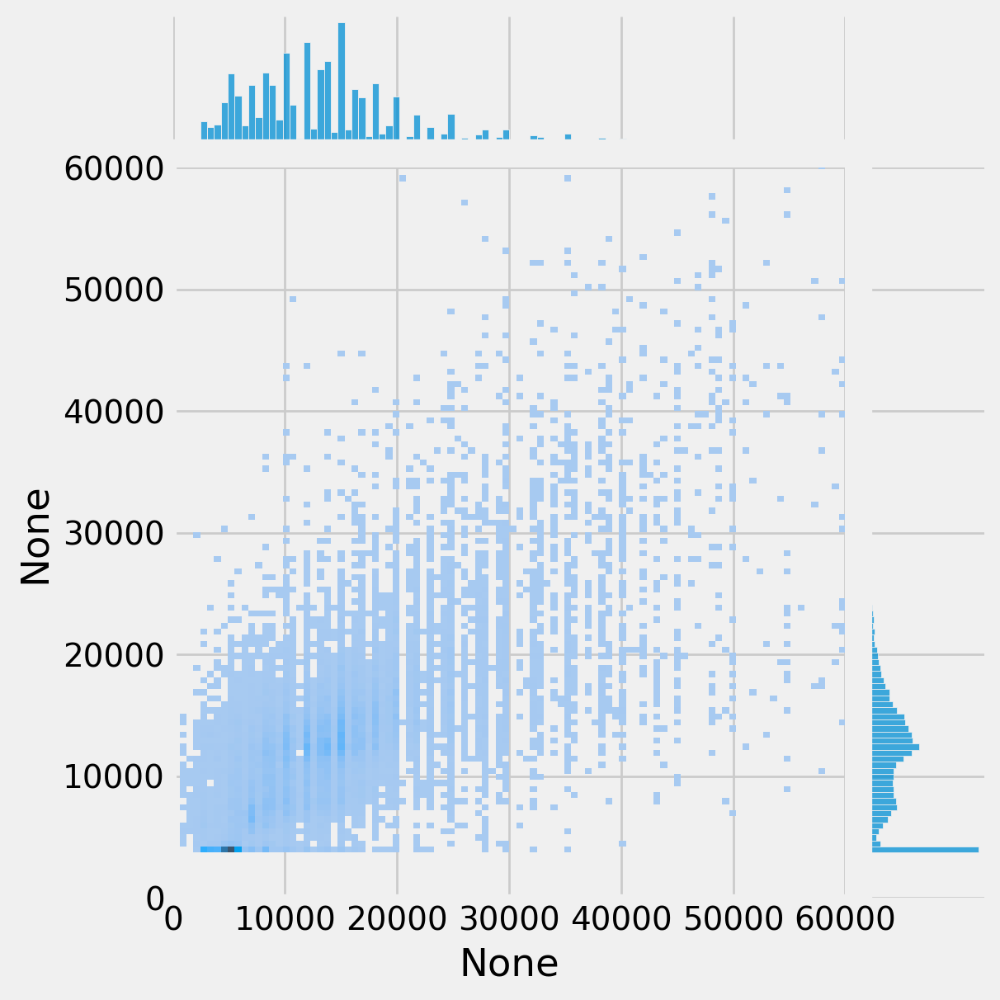

In [ ]:
test_n_plot(best_model,iter_dict['vld'],criterion,device) #gridsize 180
test_n_plot(best_model,iter_dict['vld'],criterion,device,scatter=False,kind='hist')#gridsize=180) #gridsize 180

8781.949100285197 	r2 :  0.4180050492286682 	mape :  0.34739926


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


8781.949100285197 	r2 :  0.4180050492286682 	mape :  0.34739926


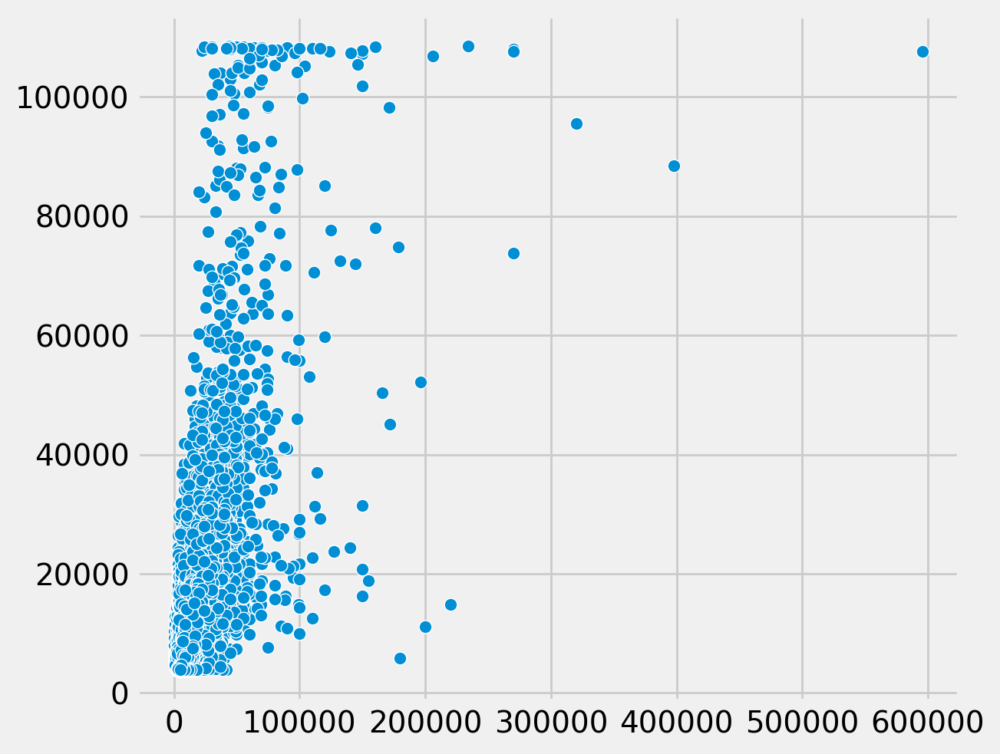

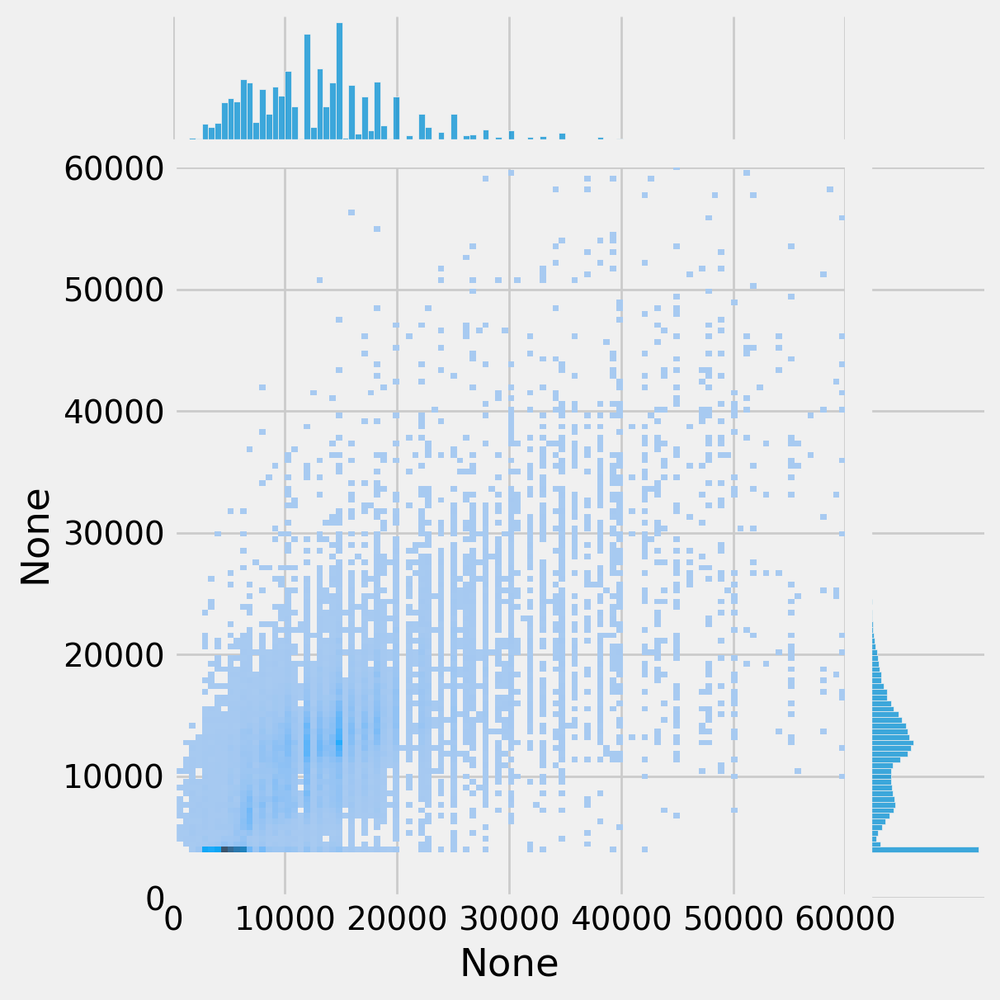

In [ ]:
test_n_plot(best_model,iter_dict['tst'],criterion,device) #gridsize 350
test_n_plot(best_model,iter_dict['tst'],criterion,device,scatter=False,kind='hist')#,gridsize=350) #gridsize 350

7360.7962361941 	r2 :  0.5442909002304077 	mape :  0.3301314


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


7360.7962361941 	r2 :  0.5442909002304077 	mape :  0.3301314


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


0.0 	r2 :  1.0 	mape :  0.0


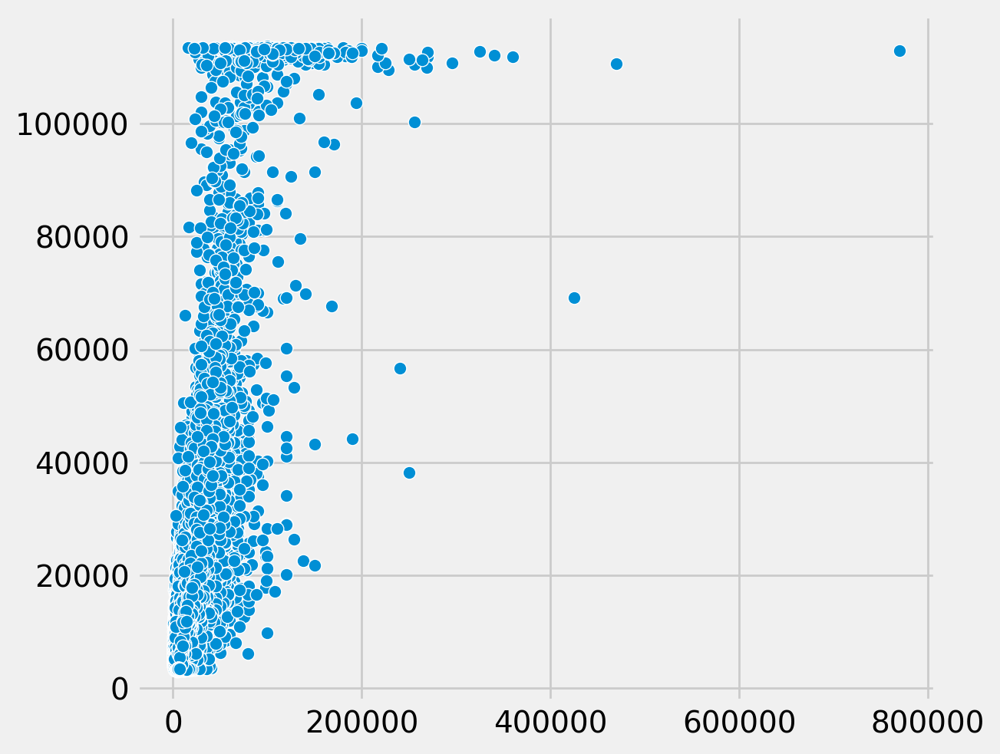

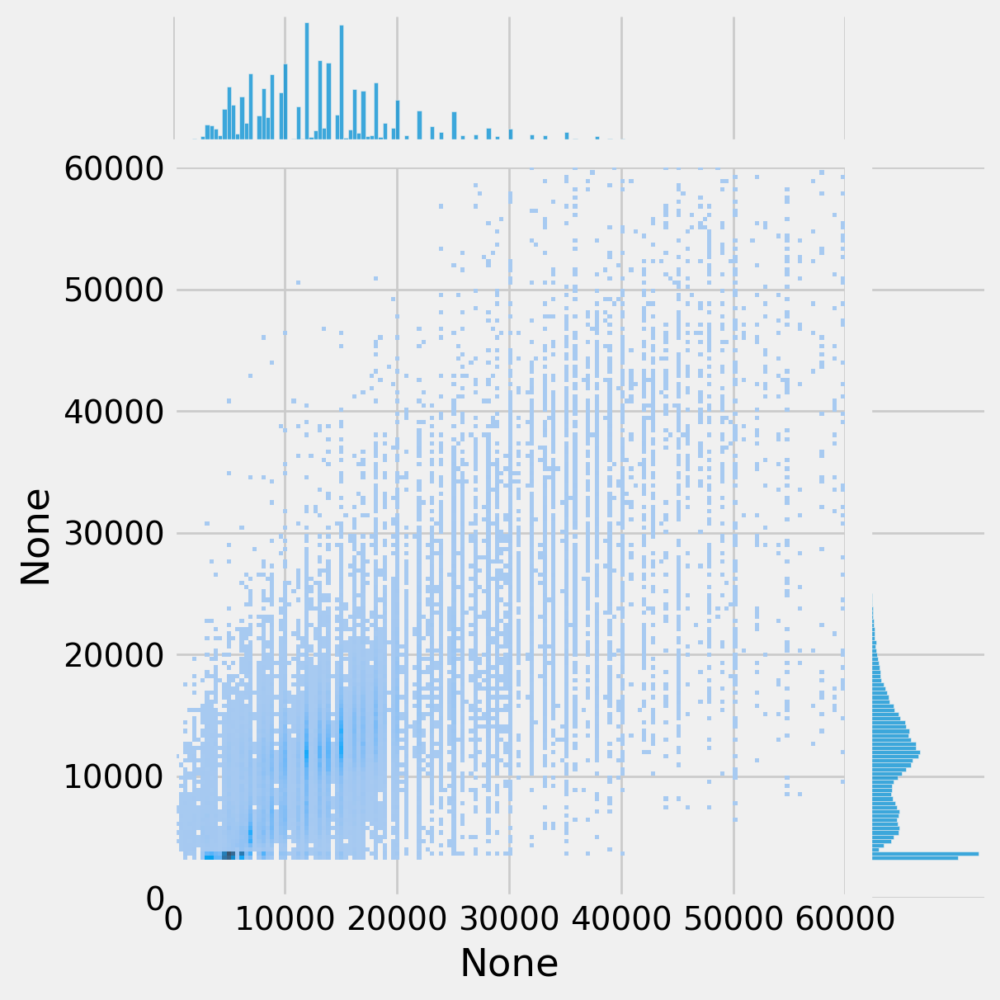

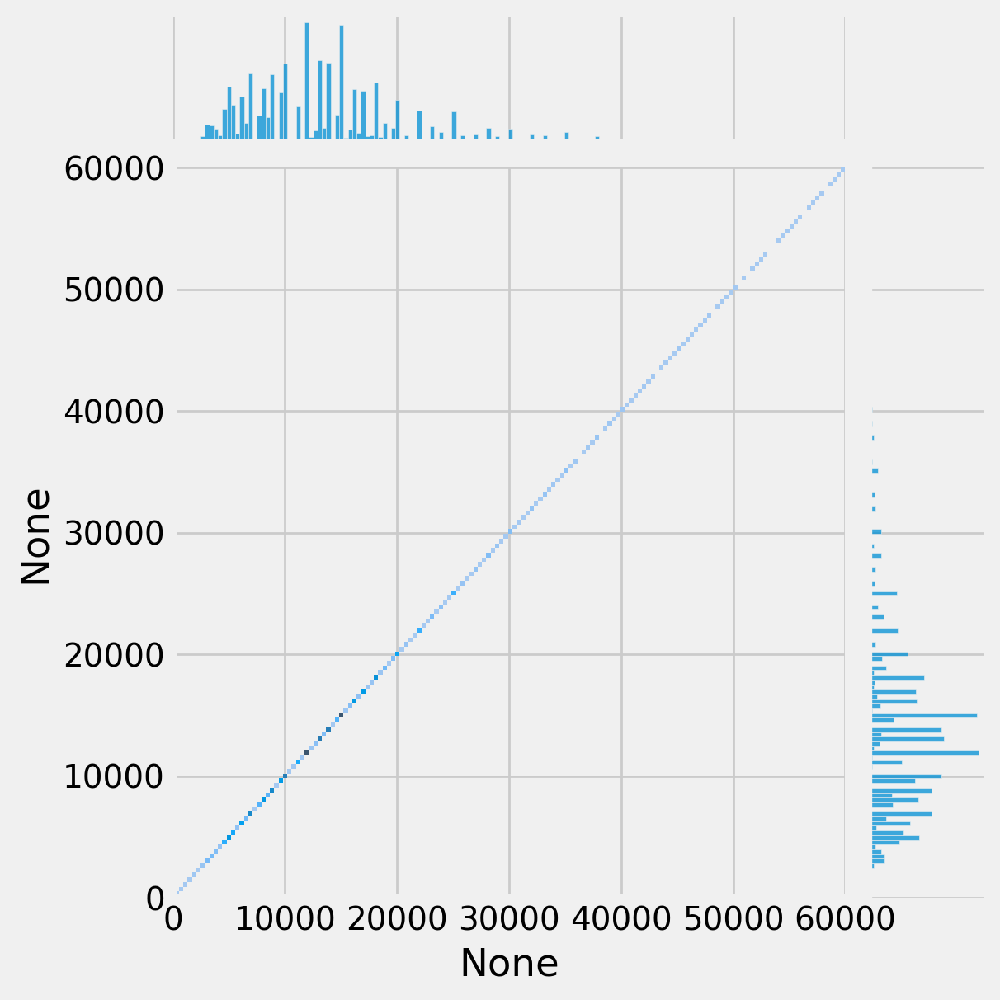

In [ ]:
test_n_plot(model,iter_dict['trn'],criterion,device) #gridsize 500
test_n_plot(model,iter_dict['trn'],criterion,device,scatter=False,kind='hist')#gridsize=250) #gridsize 500
test_n_plot(answer_trn,iter_dict['trn'],criterion,device,scatter=False,kind='hist')#gridsize=500) #gridsize 500
#https://stackoverflow.com/questions/29096632/getting-colorbar-in-a-hex-jointplot
#https://stackoverflow.com/questions/60845764/how-to-add-a-colorbar-to-the-side-of-a-kde-jointplot

8400.580813253331 	r2 :  0.45333361625671387 	mape :  0.34995356


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


8400.580813253331 	r2 :  0.45333361625671387 	mape :  0.34995356


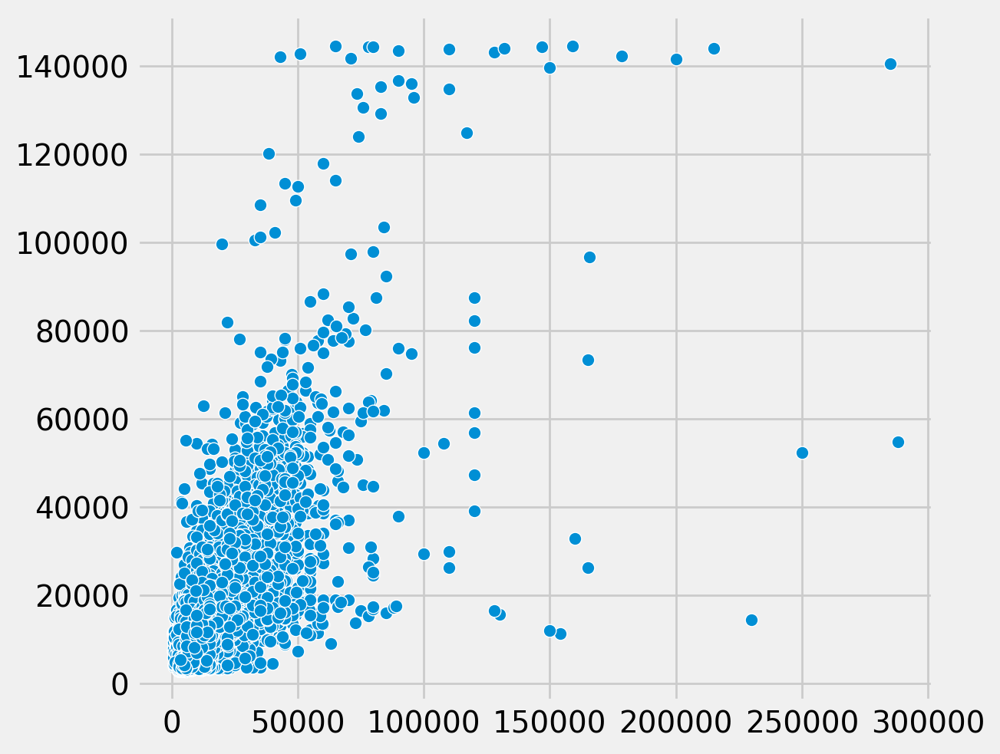

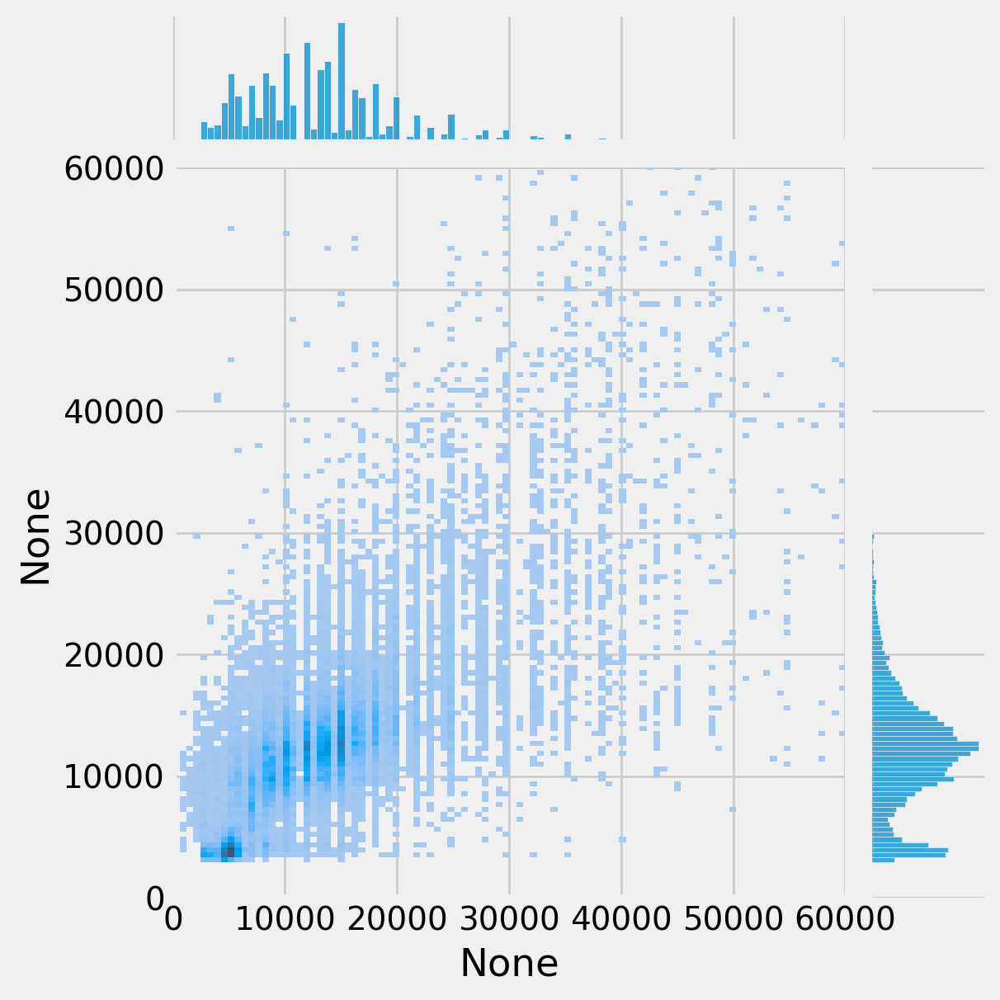

In [ ]:
test_n_plot(model,iter_dict['vld'],criterion,device) #gridsize 180
test_n_plot(model,iter_dict['vld'],criterion,device,scatter=False,kind='hist')#gridsize=180)
#test_n_plot(answer_vld,iter_dict['vld'],criterion,device,scatter=False,gridsize=220)

8421.990263589718 	r2 :  0.46420949697494507 	mape :  0.35052872


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


8421.990263589718 	r2 :  0.46420949697494507 	mape :  0.35052872


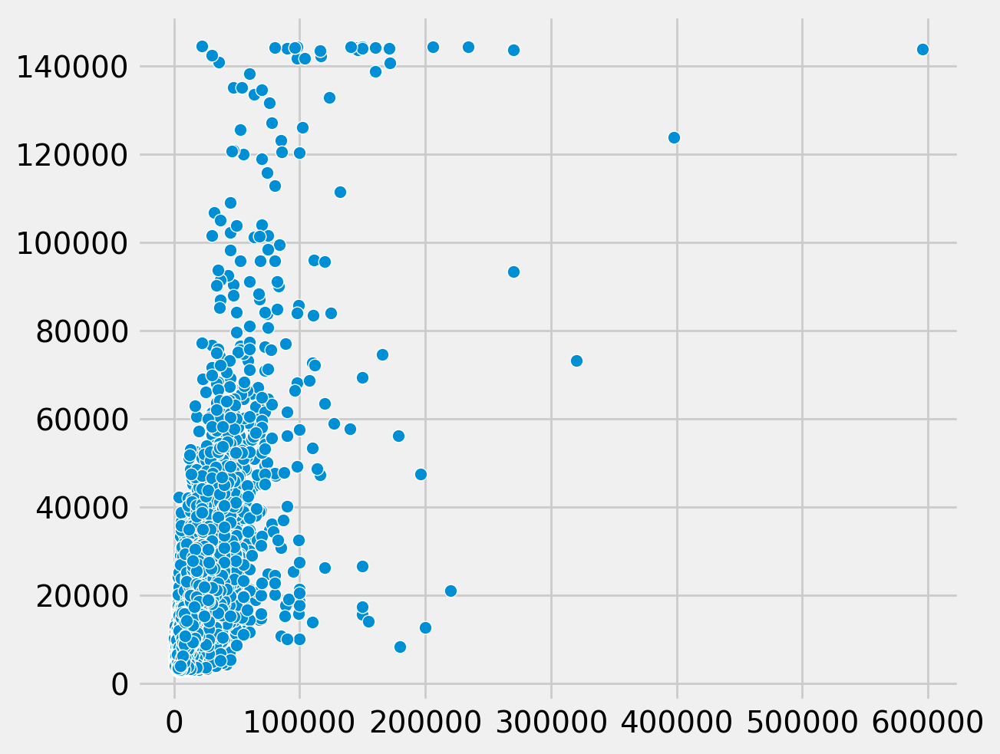

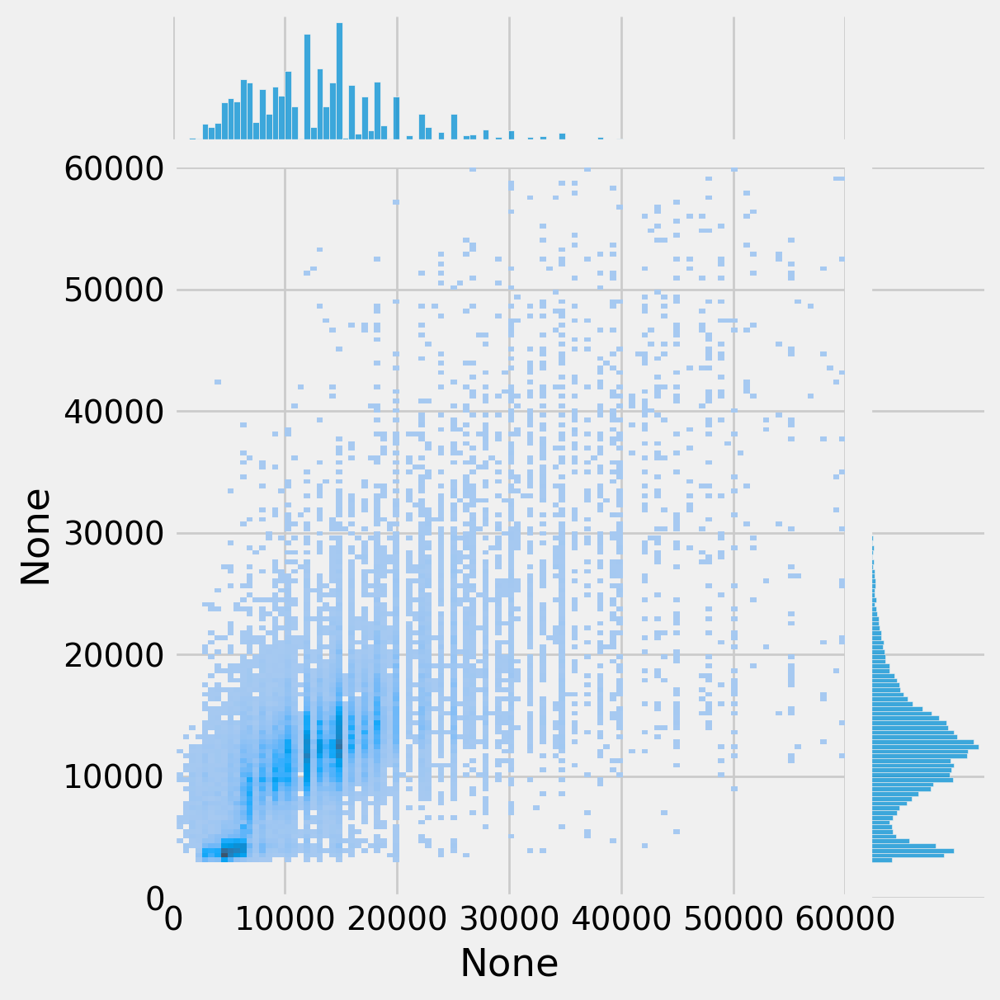

In [ ]:
test_n_plot(model,iter_dict['tst'],criterion,device) #gridsize 350
test_n_plot(model,iter_dict['tst'],criterion,device,scatter=False,kind='hist')#gridsize=220) #gridsize 350

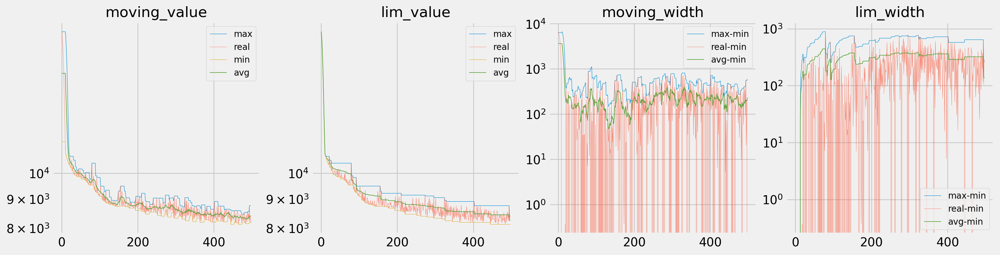

In [ ]:
x = val_loss
plot_area(x,start=0,end=-1);
#plot_area(x,start=750,end=-1,log=False);

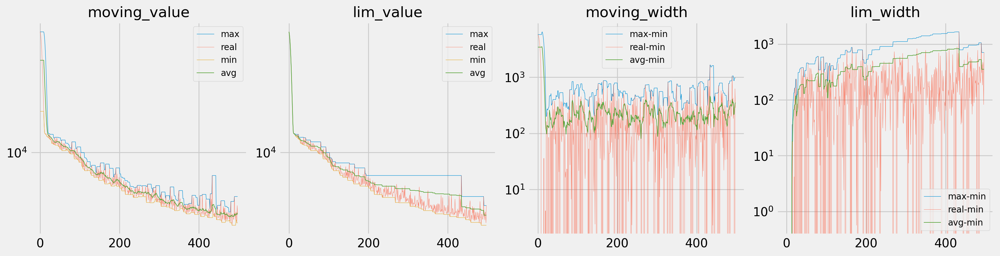

In [ ]:
x = train_loss
plot_area(x,start=0,end=-1);

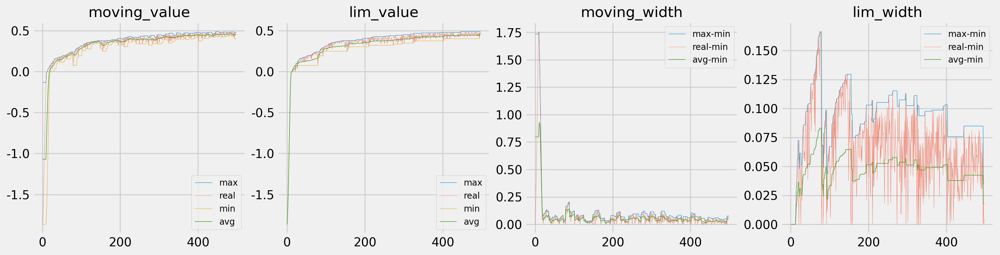

In [ ]:
x = val_score
plot_area(x,False,start=0,end=-1,log=False);

/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


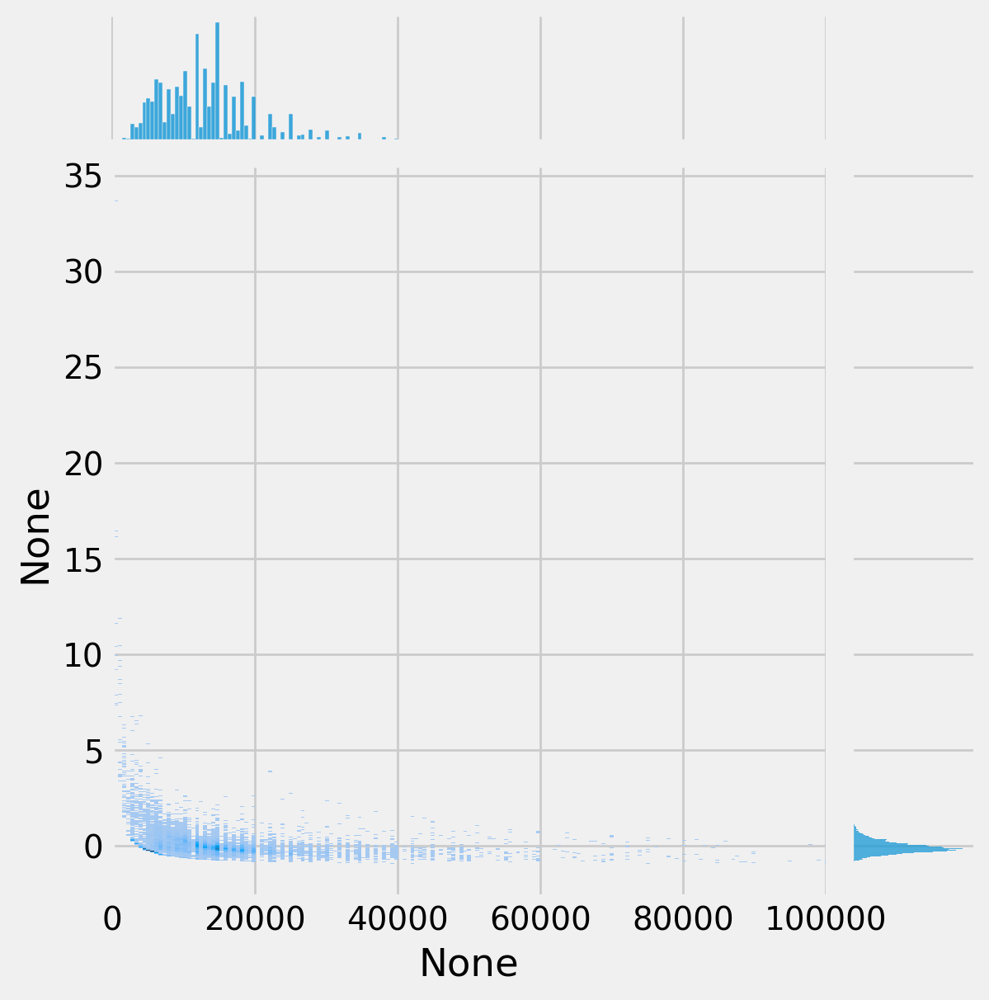

In [ ]:
test_plot_err_dist(best_model,iter_dict['tst'],criterion,device,percent=True,xlim=(0,100000));

/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()
/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


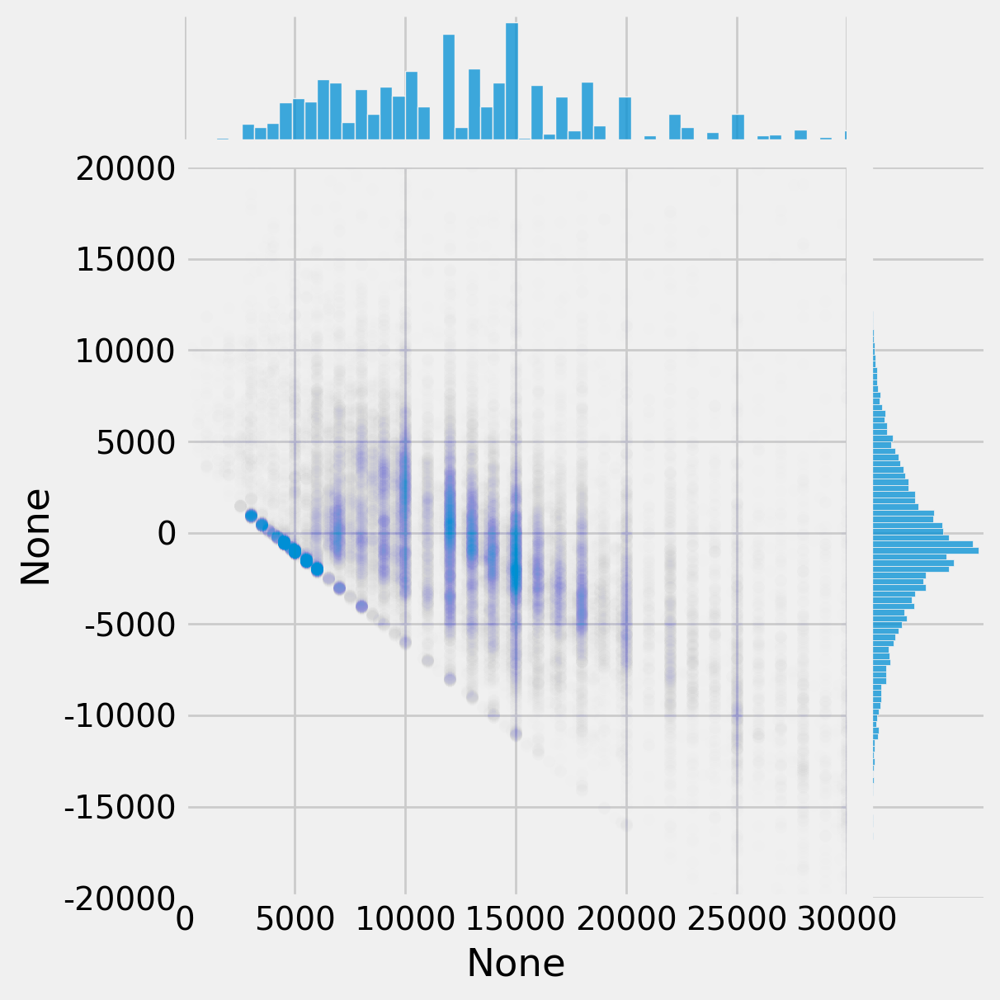

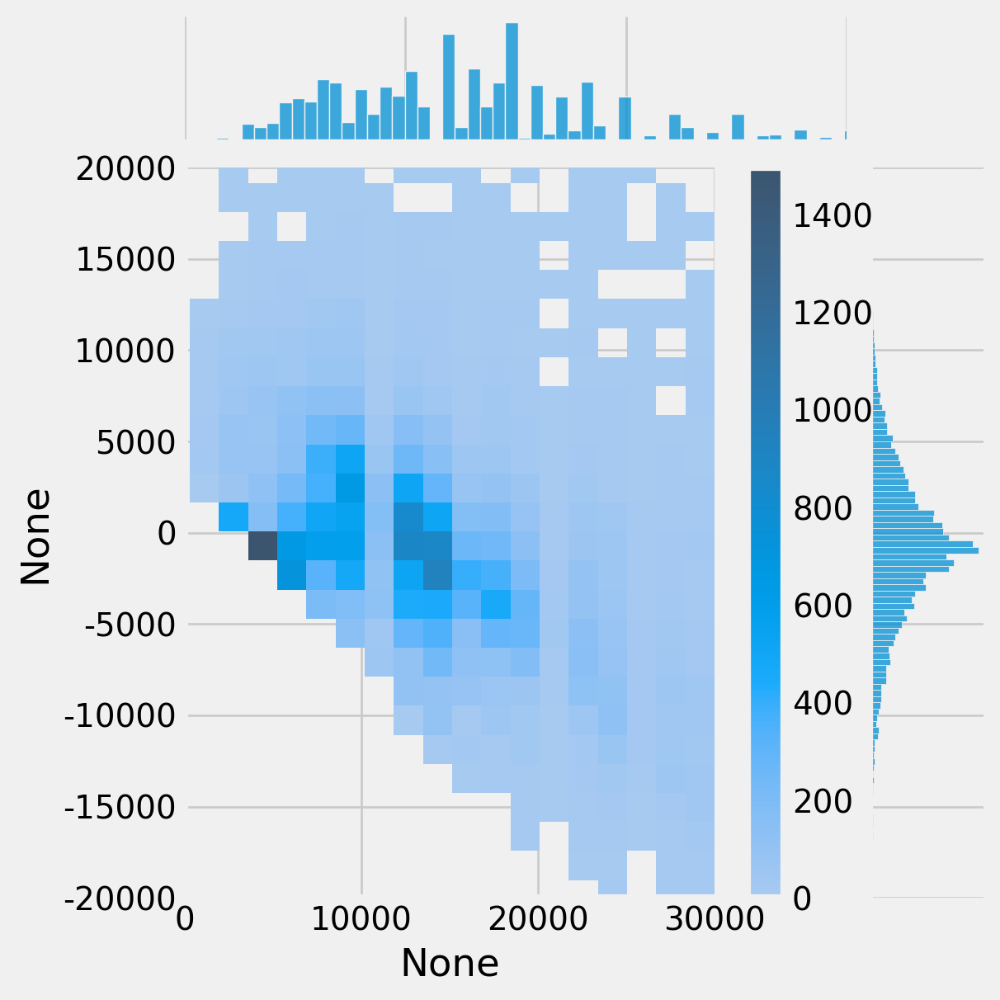

In [ ]:
test_plot_err_dist(best_model,iter_dict['tst'],criterion,device,percent=False,kind='scatter',s=30,alpha=0.002,xlim=(0,30000),ylim=(-20000,20000));
test_plot_err_dist(best_model,iter_dict['tst'],criterion,device,percent=False,kind='hist',bins=19**2,xlim=(0,30000),ylim=(-20000,20000),cbar=True);